# Importing necessary libraries

In [1]:
import pandas as pd
import numpy as np
from PIL import Image
from mplsoccer import PyPizza, add_image, FontManager
import urllib.request

# Data Preparation and combination

In [2]:

# Display the current settings
print("Current maximum number of rows: ", pd.get_option('display.max_rows'))
print("Current maximum number of columns: ", pd.get_option('display.max_columns'))

# Set new maximum number of rows and columns
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

# Display the updated settings
print("Updated maximum number of rows: ", pd.get_option('display.max_rows'))
print("Updated maximum number of columns: ", pd.get_option('display.max_columns'))


Current maximum number of rows:  60
Current maximum number of columns:  20
Updated maximum number of rows:  500
Updated maximum number of columns:  500


In [3]:
def calculate_combined_stats(minutes1, stats1, minutes2, stats2):
    total_minutes = minutes1 + minutes2
    combined_stats = (stats1 * minutes1 + stats2 * minutes2) / total_minutes
    return round(combined_stats, 2)
def calculate_percentage(feature1,allfeature1,feature2,allfeature2):
    return round((feature1+feature2)/(allfeature1+allfeature2),2)*100


In [4]:
import os

folder_path = "../../Data Collection/"  # Replace with the actual folder path

files = os.listdir(folder_path+'/2023')

for file in files:
    print(file)


Advanced_Goalkeepers_2023.csv
Defense_2023.csv
Goalkeepers_2023.csv
Goal_Creating_Actions_2023.csv
Miscellaneous_2023.csv
Passing_2023.csv
Passing_Type_2023.csv
Players_Standard_2023.csv
Playing_Time_2023.csv
Possession_2023.csv
Shooting_2023.csv


In [5]:
pas_2024=pd.read_csv(folder_path+'/2024/Passing_2024.csv').fillna(0)
pas_2023 = pd.read_csv(folder_path+'/2023/Passing_2023.csv').fillna(0)
pas_2022 = pd.read_csv(folder_path+'/2022/Passing_2022.csv').fillna(0)
pas_2021 = pd.read_csv(folder_path+'/2021/Passing_2021.csv').fillna(0)
gca_2024 = pd.read_csv(folder_path+'/2024/Goal_Creating_Actions_2024.csv').fillna(0)
gca_2023 = pd.read_csv(folder_path+'/2023/Goal_Creating_Actions_2023.csv').fillna(0)
gca_2022 = pd.read_csv(folder_path+'/2022/Goal_Creating_Actions_2022.csv').fillna(0)
gca_2021 = pd.read_csv(folder_path+'/2021/Goal_Creating_Actions_2021.csv').fillna(0)
poss_2024=pd.read_csv(folder_path+'/2024/Possession_2024.csv').fillna(0)
poss_2023=pd.read_csv(folder_path+'/2023/Possession_2023.csv').fillna(0)
poss_2022=pd.read_csv(folder_path+'/2022/Possession_2022.csv').fillna(0)
poss_2021=pd.read_csv(folder_path+'/2021/Possession_2021.csv').fillna(0)

In [6]:
pas_2023.columns

Index(['Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born',
       '90s', 'Passes_Total_Cmp', 'Passes_Total_Att', 'Passes_Total_Cmp%',
       'Passes_TotDist', 'Passes_PrgDist', 'Passes_Short_Cmp',
       'Passes_Short_Att', 'Passes_Short_Cmp%', 'Passes_Medium_Cmp',
       'Passes_Medium_Att', 'Passes_Medium_Cmp%', 'Passes_Long_Cmp',
       'Passes_Long_Att', 'Passes_Long_Cmp%', 'Assits', 'xAG', 'xA', 'A-xAG',
       'Key_Passes', 'Passes_1/3', 'Passes_Penalty_Area',
       'Crosses_Penalty_Area', 'Progressive_Passes', 'Matches'],
      dtype='object')

In [7]:
gca_2023.columns

Index(['Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born',
       '90s', 'Shot_Creating_Action', 'Shot_Creating_Action_per90',
       'Pass_Live_Shot', 'Pass_Dead_Shot', 'Take_Ons_Shot', 'Shot-Shot',
       'Fouls_drawn_Shot', 'Defensive_Shot', 'Goal_Creating_Action',
       'Goal_Creating_Action_90', 'Pass_Live_Goal', 'Pass_Dead_Goal',
       'Take_Ons_Goal', 'Shot_Goal', 'Fouls_Drawn_Goal', 'Defensive_Goal',
       'Matches'],
      dtype='object')

In [8]:
poss_2023.columns

Index(['Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born',
       '90s', 'Touches', 'Touches_Def_Pen', 'Touches_Def_3rd',
       'Touches_Mid_3rd', 'Touches_Att_3rd', 'Touches_Att_Pen',
       'Tocuhes_Live_Balls', 'Take_Ons_Attempted', 'Take_Ons_Succ',
       'Take_Ons_Succ%', 'Tackled_Take_Ons', 'Tackled_Take_Ons%', 'Carries',
       'Total_Distance', 'Progressive_Distance_Carried', 'Progressive_Carries',
       '1/3_Carries', 'Carries_Penalty_Area', 'Miscontrols', 'Dispossessed',
       'Passes_Received', 'Progressive_Passes_Received', 'Matches'],
      dtype='object')

In [9]:
# Create new columns by dividing existing columns by '90s'
columns_to_divide_by_90s = ['Touches', 'Touches_Def_Pen', 'Touches_Def_3rd', 'Touches_Mid_3rd', 'Touches_Att_3rd',
                            'Touches_Att_Pen', 'Tocuhes_Live_Balls', 'Take_Ons_Attempted', 'Take_Ons_Succ',
                            'Tackled_Take_Ons', 'Carries', 'Total_Distance', 'Progressive_Distance_Carried',
                            'Progressive_Carries', '1/3_Carries', 'Carries_Penalty_Area', 'Miscontrols', 'Dispossessed',
                            'Passes_Received', 'Progressive_Passes_Received']

for column in columns_to_divide_by_90s:
    poss_2024[column + '_per_90'] = round(poss_2024[column] / poss_2024['90s'],2)
    poss_2023[column + '_per_90'] = round(poss_2023[column] / poss_2023['90s'],2)
    poss_2022[column + '_per_90'] = round(poss_2022[column] / poss_2022['90s'],2)
    poss_2021[column + '_per_90'] = round(poss_2021[column] / poss_2021['90s'],2)

# The DataFrame 'poss_2023' now has new columns with values divided by '90s'
poss_2023.columns

Index(['Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born',
       '90s', 'Touches', 'Touches_Def_Pen', 'Touches_Def_3rd',
       'Touches_Mid_3rd', 'Touches_Att_3rd', 'Touches_Att_Pen',
       'Tocuhes_Live_Balls', 'Take_Ons_Attempted', 'Take_Ons_Succ',
       'Take_Ons_Succ%', 'Tackled_Take_Ons', 'Tackled_Take_Ons%', 'Carries',
       'Total_Distance', 'Progressive_Distance_Carried', 'Progressive_Carries',
       '1/3_Carries', 'Carries_Penalty_Area', 'Miscontrols', 'Dispossessed',
       'Passes_Received', 'Progressive_Passes_Received', 'Matches',
       'Touches_per_90', 'Touches_Def_Pen_per_90', 'Touches_Def_3rd_per_90',
       'Touches_Mid_3rd_per_90', 'Touches_Att_3rd_per_90',
       'Touches_Att_Pen_per_90', 'Tocuhes_Live_Balls_per_90',
       'Take_Ons_Attempted_per_90', 'Take_Ons_Succ_per_90',
       'Tackled_Take_Ons_per_90', 'Carries_per_90', 'Total_Distance_per_90',
       'Progressive_Distance_Carried_per_90', 'Progressive_Carries_per_90',
       '1/3_

In [10]:
pas_2024 = pas_2024[pas_2024['Pos'] == 'GK'].reset_index(drop=True)
pas_2023 = pas_2023[pas_2023['Pos'] == 'GK'].reset_index(drop=True)
pas_2022 = pas_2022[pas_2022['Pos'] == 'GK'].reset_index(drop=True)
pas_2021 = pas_2021[pas_2021['Pos'] == 'GK'].reset_index(drop=True)
gca_2024 = gca_2024[gca_2024['Pos'] == 'GK'].reset_index(drop=True)
gca_2023 = gca_2023[gca_2023['Pos'] == 'GK'].reset_index(drop=True)
gca_2022 = gca_2022[gca_2022['Pos'] == 'GK'].reset_index(drop=True)
gca_2021 = gca_2021[gca_2021['Pos'] == 'GK'].reset_index(drop=True)
poss_2024= poss_2024[poss_2024['Pos']=='GK'].reset_index(drop=True)
poss_2023= poss_2023[poss_2023['Pos']=='GK'].reset_index(drop=True)
poss_2022= poss_2022[poss_2022['Pos']=='GK'].reset_index(drop=True)
poss_2021= poss_2021[poss_2021['Pos']=='GK'].reset_index(drop=True)

In [11]:
duplicate_players = pas_2024[pas_2024.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players

array(['Matz Sels'], dtype=object)

In [12]:
duplicate_players_past = gca_2024[gca_2024.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players_past

array(['Matz Sels'], dtype=object)

In [13]:
duplicate_players_stats = pas_2024[pas_2024['Player'].isin(duplicate_players)]
duplicate_players_stats


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
169,2405,Matz Sels,be BEL,GK,Nott'ham Forest,eng Premier League,31.0,1992.0,16.0,263.0,378.0,69.6,7675.0,5788.0,66.0,66.0,100.0,103.0,105.0,98.1,91.0,202.0,45.0,0,0.1,0.1,-0.1,1.0,14.0,3.0,0.0,0.0,Matches
170,2406,Matz Sels,be BEL,GK,Strasbourg,fr Ligue 1,31.0,1992.0,19.0,452.0,619.0,73.0,12321.0,8610.0,90.0,90.0,100.0,213.0,216.0,98.6,144.0,307.0,46.9,0,0.5,0.1,-0.5,1.0,11.0,1.0,0.0,0.0,Matches


In [14]:
duplicate_players_stats_past = gca_2024[gca_2024['Player'].isin(duplicate_players_past)]
duplicate_players_stats_past


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
169,2405,Matz Sels,be BEL,GK,Nott'ham Forest,eng Premier League,31.0,1992.0,16.0,1.0,0.06,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
170,2406,Matz Sels,be BEL,GK,Strasbourg,fr Ligue 1,31.0,1992.0,19.0,2.0,0.11,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches


In [15]:
duplicate_players_stats_poss = poss_2024[poss_2024['Player'].isin(duplicate_players_past)]
duplicate_players_stats_poss 


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
169,2405,Matz Sels,be BEL,GK,Nott'ham Forest,eng Premier League,31.0,1992.0,16.0,409.0,334.0,404.0,5.0,0.0,0.0,409.0,0.0,0.0,0.0,0.0,0.0,213.0,1145.0,657.0,0.0,0.0,0.0,0.0,0.0,178.0,0.0,Matches,25.56,20.88,25.25,0.31,0.0,0.0,25.56,0.0,0.0,0.0,13.31,71.56,41.06,0.0,0.0,0.0,0.0,0.0,11.12,0.0
170,2406,Matz Sels,be BEL,GK,Strasbourg,fr Ligue 1,31.0,1992.0,19.0,664.0,582.0,657.0,7.0,0.0,0.0,664.0,0.0,0.0,0.0,0.0,0.0,452.0,2379.0,1252.0,0.0,0.0,0.0,0.0,0.0,345.0,0.0,Matches,34.95,30.63,34.58,0.37,0.0,0.0,34.95,0.0,0.0,0.0,23.79,125.21,65.89,0.0,0.0,0.0,0.0,0.0,18.16,0.0


In [16]:
duplicates = pd.DataFrame(columns=pas_2024.columns)



for player_name in duplicate_players:
    player_row1 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(pas_2023),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att            
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att
        ),
        'Assists': player_row1.Assists + player_row2.Assists,
        'xAG': player_row1.xAG + player_row2.xAG,
        'xA': player_row1.xA + player_row2.xA,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area,
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes,
       
    }

    
    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates


/tmp/ipykernel_7039/238359808.py:70: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
0,208,Matz Sels,be BEL,GK,Nott'ham Forest+Strasbourg,eng Premier League+fr Ligue 1,31.0,1992.0,35.0,715.0,997.0,72.0,19996.0,14398.0,156.0,156.0,100.0,316.0,321.0,98.0,235.0,509.0,46.0,0,0.6,0.2,-0.6,2.0,25.0,4.0,0.0,0.0,NaN


In [17]:
pas_2024 = pas_2024.drop_duplicates(subset=['Player', 'Age'], keep=False)
pas_2024

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
0,33,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22.0,2000.0,2.6,67.0,100.0,67.0,1906.0,1648.0,19.0,19.0,100.0,27.0,27.0,100.0,21.0,53.0,39.6,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,Matches
1,76,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,Matches
2,129,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,30.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,Matches
3,132,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37.0,1986.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
4,142,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,13.3,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,Matches
5,155,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,Matches
6,157,Emil Audero,it ITA,GK,Inter,it Serie A,26.0,1997.0,3.7,166.0,197.0,84.3,3484.0,2227.0,44.0,45.0,97.8,96.0,100.0,96.0,25.0,49.0,51.0,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches
7,183,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19.0,2004.0,0.1,2.0,3.0,66.7,106.0,82.0,1.0,1.0,100.0,0.0,0.0,0.0,1.0,2.0,50.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
8,235,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,Matches
9,236,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32.0,1991.0,4.0,104.0,153.0,68.0,2854.0,2094.0,18.0,19.0,94.7,53.0,55.0,96.4,33.0,79.0,41.8,0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,Matches


In [18]:
pas_2024 = pd.concat([pas_2024, duplicates], ignore_index=True)
pas_2024

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
0,33,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22.0,2000.0,2.6,67.0,100.0,67.0,1906.0,1648.0,19.0,19.0,100.0,27.0,27.0,100.0,21.0,53.0,39.6,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,Matches
1,76,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,Matches
2,129,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,30.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,Matches
3,132,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37.0,1986.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
4,142,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,13.3,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,Matches
5,155,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,Matches
6,157,Emil Audero,it ITA,GK,Inter,it Serie A,26.0,1997.0,3.7,166.0,197.0,84.3,3484.0,2227.0,44.0,45.0,97.8,96.0,100.0,96.0,25.0,49.0,51.0,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches
7,183,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19.0,2004.0,0.1,2.0,3.0,66.7,106.0,82.0,1.0,1.0,100.0,0.0,0.0,0.0,1.0,2.0,50.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
8,235,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,Matches
9,236,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32.0,1991.0,4.0,104.0,153.0,68.0,2854.0,2094.0,18.0,19.0,94.7,53.0,55.0,96.4,33.0,79.0,41.8,0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,Matches


In [19]:
duplicates = pd.DataFrame(columns=gca_2024.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(gca_2024),
        'Player': player_row1.Player,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Shot_Creating_Action': player_row1.Shot_Creating_Action + player_row2.Shot_Creating_Action,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action
        ),
        'Pass_Live_Shot': player_row1.Pass_Live_Shot + player_row2.Pass_Live_Shot,
        'Pass_Dead_Shot': player_row1.Pass_Dead_Shot + player_row2.Pass_Dead_Shot,
        'Take_Ons_Shot': player_row1.Take_Ons_Shot + player_row2.Take_Ons_Shot,
        'Shot-Shot': player_row1['Shot-Shot'] + player_row2['Shot-Shot'],
        'Fouls_drawn_Shot': player_row1.Fouls_drawn_Shot + player_row2.Fouls_drawn_Shot,
        'Defensive_Shot': player_row1.Defensive_Shot + player_row2.Defensive_Shot,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action + player_row2.Goal_Creating_Action,
        'Goal_Creating_Action_90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action
        ),
        'Pass_Live_Goal': player_row1.Pass_Live_Goal + player_row2.Pass_Live_Goal,
        'Pass_Dead_Goal': player_row1.Pass_Dead_Goal + player_row2.Pass_Dead_Goal,
        'Take_Ons_Goal': player_row1.Take_Ons_Goal + player_row2.Take_Ons_Goal,
        'Shot_Goal': player_row1.Shot_Goal + player_row2.Shot_Goal,
        'Fouls_Drawn_Goal': player_row1.Fouls_Drawn_Goal + player_row2.Fouls_Drawn_Goal,
        'Defensive_Goal': player_row1.Defensive_Goal + player_row2.Defensive_Goal,
        
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)
duplicates

/tmp/ipykernel_7039/4095310386.py:49: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,203,Matz Sels,be BEL,GK,Nott'ham Forest+Strasbourg,eng Premier League+fr Ligue 1,31.0,1992.0,35.0,3.0,1.54,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN


In [20]:
gca_2024 = gca_2024.drop_duplicates(subset=['Player', 'Age'], keep=False)
gca_2024

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,33,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22.0,2000.0,2.6,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
1,76,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,11.0,0.39,10.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
2,129,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,30.0,2.0,0.07,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
3,132,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37.0,1986.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
4,142,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,13.3,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
5,155,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,4.0,0.12,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
6,157,Emil Audero,it ITA,GK,Inter,it Serie A,26.0,1997.0,3.7,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
7,183,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19.0,2004.0,0.1,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
8,235,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,6.0,0.35,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
9,236,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32.0,1991.0,4.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches


In [21]:
gca_2024 = pd.concat([gca_2024, duplicates], ignore_index=True)
gca_2024

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,33,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22.0,2000.0,2.6,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
1,76,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,11.0,0.39,10.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
2,129,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,30.0,2.0,0.07,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
3,132,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37.0,1986.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
4,142,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,13.3,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
5,155,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,4.0,0.12,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
6,157,Emil Audero,it ITA,GK,Inter,it Serie A,26.0,1997.0,3.7,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
7,183,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19.0,2004.0,0.1,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
8,235,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,6.0,0.35,3.0,3.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
9,236,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32.0,1991.0,4.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches


In [22]:
duplicates = pd.DataFrame(columns=poss_2024.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(poss_2023),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Touches': player_row1.Touches + player_row2.Touches,
        'Touches_Def_Pen': player_row1.Touches_Def_Pen + player_row2.Touches_Def_Pen,
        'Touches_Def_3rd': player_row1.Touches_Def_3rd + player_row2.Touches_Def_3rd,
        'Touches_Mid_3rd': player_row1.Touches_Mid_3rd + player_row2.Touches_Mid_3rd,
        'Touches_Att_3rd': player_row1.Touches_Att_3rd + player_row2.Touches_Att_3rd,
        'Touches_Att_Pen': player_row1.Touches_Att_Pen + player_row2.Touches_Att_Pen,
        'Tocuhes_Live_Balls': player_row1.Tocuhes_Live_Balls + player_row2.Tocuhes_Live_Balls,
        'Take_Ons_Attempted': player_row1.Take_Ons_Attempted + player_row2.Take_Ons_Attempted,
        'Take_Ons_Succ': player_row1.Take_Ons_Succ + player_row2.Take_Ons_Succ,
       'Take_Ons_Succ%': calculate_percentage(
            player_row1['Take_Ons_Succ'],
            player_row1.Take_Ons_Attempted,
            player_row2['Take_Ons_Succ'],
            player_row2.Take_Ons_Attempted
        ),
        'Tackled_Take_Ons': player_row1.Tackled_Take_Ons + player_row2.Tackled_Take_Ons,
        'Tackled_Take_Ons%': calculate_percentage(
            player_row1['Tackled_Take_Ons'],
            player_row1.Take_Ons_Attempted,
            player_row2['Tackled_Take_Ons'],
            player_row2.Take_Ons_Attempted,
           ),
        'Carries': player_row1.Carries + player_row2.Carries,
        'Total_Distance': player_row1.Total_Distance + player_row2.Total_Distance,
        'Progressive_Distance_Carried': player_row1.Progressive_Distance_Carried + player_row2.Progressive_Distance_Carried,
        'Progressive_Carries': player_row1.Progressive_Carries + player_row2.Progressive_Carries,
        '1/3_Carries': player_row1['1/3_Carries'] + player_row2['1/3_Carries'],
        'Carries_Penalty_Area': player_row1.Carries_Penalty_Area + player_row2.Carries_Penalty_Area,
        'Miscontrols': player_row1.Miscontrols + player_row2.Miscontrols,
        'Dispossessed': player_row1.Dispossessed + player_row2.Dispossessed,
        'Passes_Received': player_row1.Passes_Received + player_row2.Passes_Received,
        'Progressive_Passes_Received': player_row1.Progressive_Passes_Received + player_row2.Progressive_Passes_Received,
        'Touches_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches,
            player_row2['90s'],
            player_row2.Touches
        ), 
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd
        ), 
        'Touches_Att_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_3rd,
            player_row2['90s'],
            player_row2.Touches_Att_3rd
        ),
       'Touches_Att_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls
        ),
       'Take_Ons_Attempted_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Attempted,
            player_row2['90s'],
            player_row2.Take_Ons_Attempted
        ), 
        'Take_Ons_Succ_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Succ,
            player_row2['90s'],
            player_row2.Take_Ons_Succ
        ),
       'Tackled_Take_Ons_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tackled_Take_Ons,
            player_row2['90s'],
            player_row2.Tackled_Take_Ons
        ), 
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries
        ), 
        'Total_Distance_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Total_Distance,
            player_row2['90s'],
            player_row2.Total_Distance
        ),
       'Progressive_Distance_Carried_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Distance_Carried,
            player_row2['90s'],
            player_row2.Progressive_Distance_Carried
        ),
        'Progressive_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Carries,
            player_row2['90s'],
            player_row2.Progressive_Carries
        ),
       '1/3_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1['1/3_Carries'],
            player_row2['90s'],
            player_row2['1/3_Carries']
        ), 
        'Carries_Penalty_Area_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries_Penalty_Area,
            player_row2['90s'],
            player_row2.Carries_Penalty_Area
        ),
       'Miscontrols_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Miscontrols,
            player_row2['90s'],
            player_row2.Miscontrols
        ), 
        'Dispossessed_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Dispossessed,
            player_row2['90s'],
            player_row2.Dispossessed
        ), 
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received
        ),
       'Progressive_Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Passes_Received,
            player_row2['90s'],
            player_row2.Progressive_Passes_Received
        )
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates

/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100
/tmp/ipykernel_7039/2931375519.py:174: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,208,Matz Sels,be BEL,GK,Nott'ham Forest+Strasbourg,eng Premier League+fr Ligue 1,31.0,1992.0,35.0,1073.0,916.0,1061.0,12.0,0.0,0.0,1073.0,0.0,0.0,NaN,0.0,NaN,665.0,3524.0,1909.0,0.0,0.0,0.0,0.0,0.0,523.0,0.0,NaN,547.43,468.63,541.34,6.09,0.0,315.94,547.43,0.0,0.0,0.0,342.74,1814.89,980.0,0.0,0.0,0.0,0.0,0.0,268.66,0.0


In [23]:
poss_2024 = poss_2024.drop_duplicates(subset=['Player', 'Age'], keep=False)
poss_2024

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,33,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22.0,2000.0,2.6,104.0,84.0,104.0,0.0,0.0,0.0,104.0,0.0,0.0,0.0,0.0,0.0,58.0,348.0,192.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,Matches,40.00,32.31,40.00,0.00,0.00,0.00,40.00,0.00,0.00,0.00,22.31,133.85,73.85,0.00,0.00,0.00,0.00,0.00,16.15,0.00
1,76,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,1196.0,754.0,1145.0,52.0,0.0,0.0,1196.0,0.0,0.0,0.0,0.0,0.0,850.0,3713.0,2361.0,0.0,0.0,0.0,4.0,0.0,764.0,0.0,Matches,42.71,26.93,40.89,1.86,0.00,0.00,42.71,0.00,0.00,0.00,30.36,132.61,84.32,0.00,0.00,0.00,0.14,0.00,27.29,0.00
2,129,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,30.0,976.0,835.0,969.0,7.0,0.0,0.0,976.0,1.0,1.0,100.0,0.0,0.0,498.0,3168.0,1945.0,0.0,1.0,0.0,0.0,0.0,345.0,0.0,Matches,32.53,27.83,32.30,0.23,0.00,0.00,32.53,0.03,0.03,0.00,16.60,105.60,64.83,0.00,0.03,0.00,0.00,0.00,11.50,0.00
3,132,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37.0,1986.0,0.0,2.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,11.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches,inf,inf,inf,NaN,NaN,NaN,inf,NaN,NaN,NaN,inf,inf,inf,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,142,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,13.3,474.0,412.0,471.0,3.0,0.0,0.0,474.0,0.0,0.0,0.0,0.0,0.0,313.0,1259.0,808.0,0.0,0.0,0.0,0.0,0.0,300.0,0.0,Matches,35.64,30.98,35.41,0.23,0.00,0.00,35.64,0.00,0.00,0.00,23.53,94.66,60.75,0.00,0.00,0.00,0.00,0.00,22.56,0.00
5,155,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,1461.0,1103.0,1440.0,22.0,0.0,0.0,1461.0,0.0,0.0,0.0,0.0,0.0,835.0,4754.0,2508.0,0.0,0.0,0.0,2.0,0.0,729.0,0.0,Matches,42.97,32.44,42.35,0.65,0.00,0.00,42.97,0.00,0.00,0.00,24.56,139.82,73.76,0.00,0.00,0.00,0.06,0.00,21.44,0.00
6,157,Emil Audero,it ITA,GK,Inter,it Serie A,26.0,1997.0,3.7,200.0,173.0,200.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,147.0,639.0,377.0,0.0,0.0,0.0,0.0,0.0,139.0,0.0,Matches,54.05,46.76,54.05,0.00,0.00,0.00,54.05,0.00,0.00,0.00,39.73,172.70,101.89,0.00,0.00,0.00,0.00,0.00,37.57,0.00
7,183,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19.0,2004.0,0.1,4.0,4.0,4.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,Matches,40.00,40.00,40.00,0.00,0.00,0.00,40.00,0.00,0.00,0.00,10.00,100.00,10.00,0.00,0.00,0.00,0.00,0.00,10.00,0.00
8,235,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,734.0,581.0,719.0,14.0,2.0,2.0,734.0,3.0,3.0,100.0,0.0,0.0,408.0,2194.0,1348.0,0.0,0.0,0.0,1.0,0.0,301.0,1.0,Matches,43.18,34.18,42.29,0.82,0.12,0.12,43.18,0.18,0.18,0.00,24.00,129.06,79.29,0.00,0.00,0.00,0.06,0.00,17.71,0.06
9,236,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32.0,1991.0,4.0,166.0,124.0,162.0,4.0,0.0,0.0,166.0,0.0,0.0,0.0,0.0,0.0,84.0,433.0,265.0,0.0,0.0,0.0,0.0,0.0,91.0,0.0,Matches,41.50,31.00,40.50,1.00,0.00,0.00,41.50,0.00,0.00,0.00,21.00,108.25,66.25,0.00,0.00,0.00,0.00,0.00,22.75,0.00


In [24]:
poss_2024 = pd.concat([poss_2024, duplicates], ignore_index=True)
poss_2024

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,33,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22.0,2000.0,2.6,104.0,84.0,104.0,0.0,0.0,0.0,104.0,0.0,0.0,0.0,0.0,0.0,58.0,348.0,192.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,Matches,40.00,32.31,40.00,0.00,0.00,0.00,40.00,0.00,0.00,0.00,22.31,133.85,73.85,0.00,0.00,0.00,0.00,0.00,16.15,0.00
1,76,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,1196.0,754.0,1145.0,52.0,0.0,0.0,1196.0,0.0,0.0,0.0,0.0,0.0,850.0,3713.0,2361.0,0.0,0.0,0.0,4.0,0.0,764.0,0.0,Matches,42.71,26.93,40.89,1.86,0.00,0.00,42.71,0.00,0.00,0.00,30.36,132.61,84.32,0.00,0.00,0.00,0.14,0.00,27.29,0.00
2,129,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,30.0,976.0,835.0,969.0,7.0,0.0,0.0,976.0,1.0,1.0,100.0,0.0,0.0,498.0,3168.0,1945.0,0.0,1.0,0.0,0.0,0.0,345.0,0.0,Matches,32.53,27.83,32.30,0.23,0.00,0.00,32.53,0.03,0.03,0.00,16.60,105.60,64.83,0.00,0.03,0.00,0.00,0.00,11.50,0.00
3,132,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37.0,1986.0,0.0,2.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,11.0,11.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches,inf,inf,inf,NaN,NaN,NaN,inf,NaN,NaN,NaN,inf,inf,inf,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,142,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,13.3,474.0,412.0,471.0,3.0,0.0,0.0,474.0,0.0,0.0,0.0,0.0,0.0,313.0,1259.0,808.0,0.0,0.0,0.0,0.0,0.0,300.0,0.0,Matches,35.64,30.98,35.41,0.23,0.00,0.00,35.64,0.00,0.00,0.00,23.53,94.66,60.75,0.00,0.00,0.00,0.00,0.00,22.56,0.00
5,155,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,1461.0,1103.0,1440.0,22.0,0.0,0.0,1461.0,0.0,0.0,0.0,0.0,0.0,835.0,4754.0,2508.0,0.0,0.0,0.0,2.0,0.0,729.0,0.0,Matches,42.97,32.44,42.35,0.65,0.00,0.00,42.97,0.00,0.00,0.00,24.56,139.82,73.76,0.00,0.00,0.00,0.06,0.00,21.44,0.00
6,157,Emil Audero,it ITA,GK,Inter,it Serie A,26.0,1997.0,3.7,200.0,173.0,200.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,147.0,639.0,377.0,0.0,0.0,0.0,0.0,0.0,139.0,0.0,Matches,54.05,46.76,54.05,0.00,0.00,0.00,54.05,0.00,0.00,0.00,39.73,172.70,101.89,0.00,0.00,0.00,0.00,0.00,37.57,0.00
7,183,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19.0,2004.0,0.1,4.0,4.0,4.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,Matches,40.00,40.00,40.00,0.00,0.00,0.00,40.00,0.00,0.00,0.00,10.00,100.00,10.00,0.00,0.00,0.00,0.00,0.00,10.00,0.00
8,235,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,734.0,581.0,719.0,14.0,2.0,2.0,734.0,3.0,3.0,100.0,0.0,0.0,408.0,2194.0,1348.0,0.0,0.0,0.0,1.0,0.0,301.0,1.0,Matches,43.18,34.18,42.29,0.82,0.12,0.12,43.18,0.18,0.18,0.00,24.00,129.06,79.29,0.00,0.00,0.00,0.06,0.00,17.71,0.06
9,236,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32.0,1991.0,4.0,166.0,124.0,162.0,4.0,0.0,0.0,166.0,0.0,0.0,0.0,0.0,0.0,84.0,433.0,265.0,0.0,0.0,0.0,0.0,0.0,91.0,0.0,Matches,41.50,31.00,40.50,1.00,0.00,0.00,41.50,0.00,0.00,0.00,21.00,108.25,66.25,0.00,0.00,0.00,0.00,0.00,22.75,0.00


In [25]:
duplicate_players = pas_2023[pas_2023.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players

array(['Pierluigi Gollini', 'Benjamin Lecomte', 'Jonas Omlin',
       'Fernando Pacheco', 'Ionuț Radu', 'Yann Sommer'], dtype=object)

In [26]:
duplicate_players_past = gca_2023[gca_2023.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players_past

array(['Pierluigi Gollini', 'Benjamin Lecomte', 'Jonas Omlin',
       'Fernando Pacheco', 'Ionuț Radu', 'Yann Sommer'], dtype=object)

In [27]:
duplicate_players_stats = pas_2023[pas_2023['Player'].isin(duplicate_players)]
duplicate_players_stats


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
65,1031,Pierluigi Gollini,it ITA,GK,Fiorentina,it Serie A,27,1995,3.0,96.0,126.0,76.2,2622.0,1774.0,18.0,18.0,100.0,42.0,42.0,100.0,36.0,66.0,54.5,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches
66,1032,Pierluigi Gollini,it ITA,GK,Napoli,it Serie A,27,1995,4.0,136.0,159.0,85.5,3405.0,2362.0,31.0,31.0,100.0,62.0,63.0,98.4,43.0,65.0,66.2,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches
88,1501,Benjamin Lecomte,fr FRA,GK,Espanyol,es La Liga,31,1991,10.0,179.0,275.0,65.1,6302.0,5234.0,21.0,21.0,100.0,66.0,67.0,98.5,92.0,184.0,50.0,0,0.1,0.0,-0.1,1.0,5.0,0.0,0.0,0.0,Matches
89,1502,Benjamin Lecomte,fr FRA,GK,Montpellier,fr Ligue 1,31,1991,19.0,411.0,643.0,63.9,12683.0,9750.0,53.0,53.0,100.0,171.0,177.0,96.6,186.0,409.0,45.5,0,0.1,0.0,-0.1,1.0,3.0,0.0,0.0,0.0,Matches
132,1977,Jonas Omlin,ch SUI,GK,Montpellier,fr Ligue 1,28,1994,13.0,295.0,415.0,71.1,8042.0,5958.0,53.0,54.0,98.1,155.0,158.0,98.1,86.0,202.0,42.6,0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,Matches
133,1978,Jonas Omlin,ch SUI,GK,Gladbach,de Bundesliga,28,1994,14.3,595.0,738.0,80.6,14423.0,9281.0,130.0,132.0,98.5,323.0,328.0,98.5,141.0,277.0,50.9,0,0.4,0.0,-0.4,2.0,5.0,1.0,0.0,0.0,Matches
136,2016,Fernando Pacheco,es ESP,GK,Almería,es La Liga,30,1992,1.0,20.0,31.0,64.5,617.0,423.0,2.0,2.0,100.0,10.0,11.0,90.9,8.0,17.0,47.1,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches
137,2017,Fernando Pacheco,es ESP,GK,Espanyol,es La Liga,30,1992,16.0,399.0,557.0,71.6,12946.0,10565.0,54.0,55.0,98.2,174.0,176.0,98.9,171.0,323.0,52.9,0,0.2,0.1,-0.2,3.0,22.0,1.0,0.0,2.0,Matches
150,2180,Ionuț Radu,ro ROU,GK,Cremonese,it Serie A,25,1997,9.0,221.0,336.0,65.8,6117.0,4391.0,51.0,52.0,98.1,100.0,102.0,98.0,69.0,177.0,39.0,0,0.4,0.1,-0.4,2.0,10.0,2.0,0.0,0.0,Matches
151,2181,Ionuț Radu,ro ROU,GK,Auxerre,fr Ligue 1,25,1997,17.0,345.0,598.0,57.7,11491.0,9005.0,41.0,41.0,100.0,142.0,143.0,99.3,159.0,408.0,39.0,0,0.0,0.0,0.0,1.0,16.0,0.0,0.0,0.0,Matches


In [28]:
duplicate_players_stats_past = gca_2023[gca_2023['Player'].isin(duplicate_players_past)]
duplicate_players_stats_past


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
65,1031,Pierluigi Gollini,it ITA,GK,Fiorentina,it Serie A,27,1995,3.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
66,1032,Pierluigi Gollini,it ITA,GK,Napoli,it Serie A,27,1995,4.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
88,1501,Benjamin Lecomte,fr FRA,GK,Espanyol,es La Liga,31,1991,10.0,2.0,0.20,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
89,1502,Benjamin Lecomte,fr FRA,GK,Montpellier,fr Ligue 1,31,1991,19.0,5.0,0.26,5.0,0.0,0.0,0.0,0.0,0.0,1.0,0.05,1.0,0.0,0.0,0.0,0.0,0.0,Matches
132,1977,Jonas Omlin,ch SUI,GK,Montpellier,fr Ligue 1,28,1994,13.0,1.0,0.08,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
133,1978,Jonas Omlin,ch SUI,GK,Gladbach,de Bundesliga,28,1994,14.3,3.0,0.21,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
136,2016,Fernando Pacheco,es ESP,GK,Almería,es La Liga,30,1992,1.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
137,2017,Fernando Pacheco,es ESP,GK,Espanyol,es La Liga,30,1992,16.0,5.0,0.31,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
150,2180,Ionuț Radu,ro ROU,GK,Cremonese,it Serie A,25,1997,9.0,6.0,0.67,5.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
151,2181,Ionuț Radu,ro ROU,GK,Auxerre,fr Ligue 1,25,1997,17.0,3.0,0.18,3.0,0.0,0.0,0.0,0.0,0.0,1.0,0.06,1.0,0.0,0.0,0.0,0.0,0.0,Matches


In [29]:
duplicate_players_stats_poss = poss_2023[poss_2023['Player'].isin(duplicate_players_past)]
duplicate_players_stats_poss 


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
65,1031,Pierluigi Gollini,it ITA,GK,Fiorentina,it Serie A,27,1995,3.0,131.0,116.0,131.0,0.0,0.0,0.0,131.0,0.0,0.0,0.0,0.0,0.0,104.0,423.0,217.0,0.0,0.0,0.0,0.0,0.0,91.0,0.0,Matches,43.67,38.67,43.67,0.00,0.0,0.0,43.67,0.00,0.00,0.00,34.67,141.00,72.33,0.0,0.0,0.0,0.00,0.00,30.33,0.0
66,1032,Pierluigi Gollini,it ITA,GK,Napoli,it Serie A,27,1995,4.0,166.0,142.0,166.0,0.0,0.0,0.0,166.0,0.0,0.0,0.0,0.0,0.0,111.0,517.0,337.0,0.0,0.0,0.0,0.0,0.0,96.0,0.0,Matches,41.50,35.50,41.50,0.00,0.0,0.0,41.50,0.00,0.00,0.00,27.75,129.25,84.25,0.0,0.0,0.0,0.00,0.00,24.00,0.0
88,1501,Benjamin Lecomte,fr FRA,GK,Espanyol,es La Liga,31,1991,10.0,298.0,228.0,290.0,8.0,0.0,0.0,298.0,0.0,0.0,0.0,0.0,0.0,124.0,746.0,506.0,0.0,0.0,0.0,0.0,0.0,87.0,0.0,Matches,29.80,22.80,29.00,0.80,0.0,0.0,29.80,0.00,0.00,0.00,12.40,74.60,50.60,0.0,0.0,0.0,0.00,0.00,8.70,0.0
89,1502,Benjamin Lecomte,fr FRA,GK,Montpellier,fr Ligue 1,31,1991,19.0,698.0,567.0,694.0,5.0,0.0,0.0,698.0,1.0,1.0,100.0,0.0,0.0,426.0,2516.0,1595.0,0.0,0.0,0.0,0.0,0.0,294.0,0.0,Matches,36.74,29.84,36.53,0.26,0.0,0.0,36.74,0.05,0.05,0.00,22.42,132.42,83.95,0.0,0.0,0.0,0.00,0.00,15.47,0.0
132,1977,Jonas Omlin,ch SUI,GK,Montpellier,fr Ligue 1,28,1994,13.0,450.0,365.0,448.0,2.0,0.0,0.0,450.0,1.0,0.0,0.0,1.0,100.0,298.0,1693.0,1024.0,0.0,0.0,0.0,0.0,0.0,172.0,0.0,Matches,34.62,28.08,34.46,0.15,0.0,0.0,34.62,0.08,0.00,0.08,22.92,130.23,78.77,0.0,0.0,0.0,0.00,0.00,13.23,0.0
133,1978,Jonas Omlin,ch SUI,GK,Gladbach,de Bundesliga,28,1994,14.3,773.0,608.0,769.0,4.0,0.0,0.0,773.0,0.0,0.0,0.0,0.0,0.0,452.0,2122.0,1262.0,0.0,0.0,0.0,0.0,0.0,459.0,0.0,Matches,54.06,42.52,53.78,0.28,0.0,0.0,54.06,0.00,0.00,0.00,31.61,148.39,88.25,0.0,0.0,0.0,0.00,0.00,32.10,0.0
136,2016,Fernando Pacheco,es ESP,GK,Almería,es La Liga,30,1992,1.0,34.0,30.0,34.0,0.0,0.0,0.0,34.0,0.0,0.0,0.0,0.0,0.0,20.0,109.0,89.0,0.0,0.0,0.0,0.0,0.0,13.0,0.0,Matches,34.00,30.00,34.00,0.00,0.0,0.0,34.00,0.00,0.00,0.00,20.00,109.00,89.00,0.0,0.0,0.0,0.00,0.00,13.00,0.0
137,2017,Fernando Pacheco,es ESP,GK,Espanyol,es La Liga,30,1992,16.0,598.0,504.0,591.0,7.0,0.0,0.0,598.0,0.0,0.0,0.0,0.0,0.0,317.0,1818.0,1179.0,0.0,0.0,0.0,0.0,0.0,233.0,0.0,Matches,37.38,31.50,36.94,0.44,0.0,0.0,37.38,0.00,0.00,0.00,19.81,113.62,73.69,0.0,0.0,0.0,0.00,0.00,14.56,0.0
150,2180,Ionuț Radu,ro ROU,GK,Cremonese,it Serie A,25,1997,9.0,366.0,305.0,366.0,0.0,0.0,0.0,366.0,0.0,0.0,0.0,0.0,0.0,205.0,1089.0,772.0,0.0,0.0,0.0,0.0,0.0,170.0,0.0,Matches,40.67,33.89,40.67,0.00,0.0,0.0,40.67,0.00,0.00,0.00,22.78,121.00,85.78,0.0,0.0,0.0,0.00,0.00,18.89,0.0
151,2181,Ionuț Radu,ro ROU,GK,Auxerre,fr Ligue 1,25,1997,17.0,630.0,538.0,626.0,4.0,0.0,0.0,630.0,1.0,1.0,100.0,0.0,0.0,431.0,2238.0,1443.0,0.0,0.0,0.0,1.0,0.0,253.0,0.0,Matches,37.06,31.65,36.82,0.24,0.0,0.0,37.06,0.06,0.06,0.00,25.35,131.65,84.88,0.0,0.0,0.0,0.06,0.00,14.88,0.0


In [30]:
duplicates = pd.DataFrame(columns=pas_2023.columns)



for player_name in duplicate_players:
    player_row1 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(pas_2023),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att            
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att
        ),
        'Assists': player_row1.Assits + player_row2.Assits,
        'xAG': player_row1.xAG + player_row2.xAG,
        'xA': player_row1.xA + player_row2.xA,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area,
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes,
       
    }

    
    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates


/tmp/ipykernel_7039/2693497053.py:70: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches,Assists
0,208,Pierluigi Gollini,it ITA,GK,Fiorentina+Napoli,it Serie A,27,1995,7.0,232.0,285.0,81.0,6027.0,4136.0,49.0,49.0,100.0,104.0,105.0,99.0,79.0,131.0,60.0,NaN,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,NaN,0.0
1,208,Benjamin Lecomte,fr FRA,GK,Espanyol+Montpellier,es La Liga+fr Ligue 1,31,1991,29.0,590.0,918.0,64.0,18985.0,14984.0,74.0,74.0,100.0,237.0,244.0,97.0,278.0,593.0,47.0,NaN,0.2,0.0,-0.2,2.0,8.0,0.0,0.0,0.0,NaN,0.0
2,208,Jonas Omlin,ch SUI,GK,Montpellier+Gladbach,fr Ligue 1+de Bundesliga,28,1994,27.3,890.0,1153.0,77.0,22465.0,15239.0,183.0,186.0,98.0,478.0,486.0,98.0,227.0,479.0,47.0,NaN,0.4,0.0,-0.4,2.0,9.0,1.0,0.0,0.0,NaN,0.0
3,208,Fernando Pacheco,es ESP,GK,Almería+Espanyol,es La Liga,30,1992,17.0,419.0,588.0,71.0,13563.0,10988.0,56.0,57.0,98.0,184.0,187.0,98.0,179.0,340.0,53.0,NaN,0.2,0.1,-0.2,3.0,23.0,1.0,0.0,2.0,NaN,0.0
4,208,Ionuț Radu,ro ROU,GK,Cremonese+Auxerre,it Serie A+fr Ligue 1,25,1997,26.0,566.0,934.0,61.0,17608.0,13396.0,92.0,93.0,99.0,242.0,245.0,99.0,228.0,585.0,39.0,NaN,0.4,0.1,-0.4,3.0,26.0,2.0,0.0,0.0,NaN,0.0
5,208,Yann Sommer,ch SUI,GK,Gladbach+Bayern Munich,de Bundesliga,33,1988,29.0,1149.0,1358.0,85.0,26018.0,16952.0,289.0,290.0,100.0,640.0,651.0,98.0,216.0,409.0,53.0,NaN,0.0,0.0,0.0,0.0,10.0,0.0,0.0,1.0,NaN,0.0


In [31]:
pas_2023 = pas_2023.drop_duplicates(subset=['Player', 'Age'], keep=False)
pas_2023

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
0,16,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,0.1,7.0,8.0,87.5,151.0,113.0,2.0,2.0,100.0,4.0,4.0,100.0,1.0,2.0,50.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
1,30,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,7.5,171.0,241.0,71.0,4890.0,3600.0,29.0,29.0,100.0,91.0,94.0,96.8,51.0,118.0,43.2,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,Matches
2,69,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,4.5,95.0,145.0,65.5,2786.0,2199.0,20.0,20.0,100.0,47.0,47.0,100.0,28.0,77.0,36.4,0,0.1,0.0,-0.1,1.0,2.0,0.0,0.0,0.0,Matches
3,76,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37.0,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,1,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,Matches
4,132,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,3.4,67.0,92.0,72.8,1737.0,1323.0,25.0,25.0,100.0,22.0,22.0,100.0,19.0,43.0,44.2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches
5,141,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,28.5,871.0,1046.0,83.3,19299.0,11448.0,287.0,289.0,99.3,390.0,395.0,98.7,190.0,357.0,53.2,0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,Matches
6,148,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10.0,233.0,353.0,66.0,7218.0,5138.0,33.0,33.0,100.0,107.0,112.0,95.5,91.0,203.0,44.8,0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,Matches
7,159,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25.0,617.0,919.0,67.1,19319.0,14234.0,91.0,91.0,100.0,246.0,248.0,99.2,279.0,572.0,48.8,0,0.0,0.1,0.0,0.0,16.0,0.0,0.0,0.0,Matches
8,183,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36.0,791.0,1072.0,73.8,24081.0,17998.0,102.0,103.0,99.0,381.0,393.0,96.9,306.0,570.0,53.7,0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,Matches
9,222,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1.0,18.0,23.0,78.3,548.0,399.0,6.0,6.0,100.0,5.0,5.0,100.0,7.0,11.0,63.6,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches


In [32]:
pas_2023 = pd.concat([pas_2023, duplicates], ignore_index=True)
pas_2023

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches,Assists
0,16,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,0.1,7.0,8.0,87.5,151.0,113.0,2.0,2.0,100.0,4.0,4.0,100.0,1.0,2.0,50.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches,NaN
1,30,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,7.5,171.0,241.0,71.0,4890.0,3600.0,29.0,29.0,100.0,91.0,94.0,96.8,51.0,118.0,43.2,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,Matches,NaN
2,69,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,4.5,95.0,145.0,65.5,2786.0,2199.0,20.0,20.0,100.0,47.0,47.0,100.0,28.0,77.0,36.4,0,0.1,0.0,-0.1,1.0,2.0,0.0,0.0,0.0,Matches,NaN
3,76,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37.0,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,1,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,Matches,NaN
4,132,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,3.4,67.0,92.0,72.8,1737.0,1323.0,25.0,25.0,100.0,22.0,22.0,100.0,19.0,43.0,44.2,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Matches,NaN
5,141,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,28.5,871.0,1046.0,83.3,19299.0,11448.0,287.0,289.0,99.3,390.0,395.0,98.7,190.0,357.0,53.2,0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,Matches,NaN
6,148,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10.0,233.0,353.0,66.0,7218.0,5138.0,33.0,33.0,100.0,107.0,112.0,95.5,91.0,203.0,44.8,0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,Matches,NaN
7,159,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25.0,617.0,919.0,67.1,19319.0,14234.0,91.0,91.0,100.0,246.0,248.0,99.2,279.0,572.0,48.8,0,0.0,0.1,0.0,0.0,16.0,0.0,0.0,0.0,Matches,NaN
8,183,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36.0,791.0,1072.0,73.8,24081.0,17998.0,102.0,103.0,99.0,381.0,393.0,96.9,306.0,570.0,53.7,0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,Matches,NaN
9,222,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1.0,18.0,23.0,78.3,548.0,399.0,6.0,6.0,100.0,5.0,5.0,100.0,7.0,11.0,63.6,0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Matches,NaN


In [33]:
duplicates = pd.DataFrame(columns=gca_2023.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(gca_2023),
        'Player': player_row1.Player,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Shot_Creating_Action': player_row1.Shot_Creating_Action + player_row2.Shot_Creating_Action,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action
        ),
        'Pass_Live_Shot': player_row1.Pass_Live_Shot + player_row2.Pass_Live_Shot,
        'Pass_Dead_Shot': player_row1.Pass_Dead_Shot + player_row2.Pass_Dead_Shot,
        'Take_Ons_Shot': player_row1.Take_Ons_Shot + player_row2.Take_Ons_Shot,
        'Shot-Shot': player_row1['Shot-Shot'] + player_row2['Shot-Shot'],
        'Fouls_drawn_Shot': player_row1.Fouls_drawn_Shot + player_row2.Fouls_drawn_Shot,
        'Defensive_Shot': player_row1.Defensive_Shot + player_row2.Defensive_Shot,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action + player_row2.Goal_Creating_Action,
        'Goal_Creating_Action_90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action
        ),
        'Pass_Live_Goal': player_row1.Pass_Live_Goal + player_row2.Pass_Live_Goal,
        'Pass_Dead_Goal': player_row1.Pass_Dead_Goal + player_row2.Pass_Dead_Goal,
        'Take_Ons_Goal': player_row1.Take_Ons_Goal + player_row2.Take_Ons_Goal,
        'Shot_Goal': player_row1.Shot_Goal + player_row2.Shot_Goal,
        'Fouls_Drawn_Goal': player_row1.Fouls_Drawn_Goal + player_row2.Fouls_Drawn_Goal,
        'Defensive_Goal': player_row1.Defensive_Goal + player_row2.Defensive_Goal,
        
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)
duplicates

/tmp/ipykernel_7039/2640725141.py:49: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,208,Pierluigi Gollini,it ITA,GK,Fiorentina+Napoli,it Serie A,27,1995,7.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN
1,208,Benjamin Lecomte,fr FRA,GK,Espanyol+Montpellier,es La Liga+fr Ligue 1,31,1991,29.0,7.0,3.97,6.0,1.0,0.0,0.0,0.0,0.0,1.0,0.66,1.0,0.0,0.0,0.0,0.0,0.0,NaN
2,208,Jonas Omlin,ch SUI,GK,Montpellier+Gladbach,fr Ligue 1+de Bundesliga,28,1994,27.3,4.0,2.05,3.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3,208,Fernando Pacheco,es ESP,GK,Almería+Espanyol,es La Liga,30,1992,17.0,5.0,4.71,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN
4,208,Ionuț Radu,ro ROU,GK,Cremonese+Auxerre,it Serie A+fr Ligue 1,25,1997,26.0,9.0,4.04,8.0,1.0,0.0,0.0,0.0,0.0,1.0,0.65,1.0,0.0,0.0,0.0,0.0,0.0,NaN
5,208,Yann Sommer,ch SUI,GK,Gladbach+Bayern Munich,de Bundesliga,33,1988,29.0,3.0,1.34,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN


In [34]:
gca_2023 = gca_2023.drop_duplicates(subset=['Player', 'Age'], keep=False)
gca_2023

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,16,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,0.1,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
1,30,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,7.5,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
2,69,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,4.5,1.0,0.22,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
3,76,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37.0,3.0,0.08,3.0,0.0,0.0,0.0,0.0,0.0,2.0,0.05,2.0,0.0,0.0,0.0,0.0,0.0,Matches
4,132,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,3.4,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
5,141,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,28.5,1.0,0.04,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
6,148,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10.0,2.0,0.20,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
7,159,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25.0,5.0,0.20,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
8,183,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36.0,3.0,0.08,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
9,222,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches


In [35]:
gca_2023 = pd.concat([gca_2023, duplicates], ignore_index=True)
gca_2023

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,16,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,0.1,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
1,30,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,7.5,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
2,69,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,4.5,1.0,0.22,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
3,76,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37.0,3.0,0.08,3.0,0.0,0.0,0.0,0.0,0.0,2.0,0.05,2.0,0.0,0.0,0.0,0.0,0.0,Matches
4,132,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,3.4,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
5,141,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,28.5,1.0,0.04,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
6,148,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10.0,2.0,0.20,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
7,159,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25.0,5.0,0.20,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
8,183,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36.0,3.0,0.08,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches
9,222,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,Matches


In [36]:
duplicates = pd.DataFrame(columns=poss_2023.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(poss_2023),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Touches': player_row1.Touches + player_row2.Touches,
        'Touches_Def_Pen': player_row1.Touches_Def_Pen + player_row2.Touches_Def_Pen,
        'Touches_Def_3rd': player_row1.Touches_Def_3rd + player_row2.Touches_Def_3rd,
        'Touches_Mid_3rd': player_row1.Touches_Mid_3rd + player_row2.Touches_Mid_3rd,
        'Touches_Att_3rd': player_row1.Touches_Att_3rd + player_row2.Touches_Att_3rd,
        'Touches_Att_Pen': player_row1.Touches_Att_Pen + player_row2.Touches_Att_Pen,
        'Tocuhes_Live_Balls': player_row1.Tocuhes_Live_Balls + player_row2.Tocuhes_Live_Balls,
        'Take_Ons_Attempted': player_row1.Take_Ons_Attempted + player_row2.Take_Ons_Attempted,
        'Take_Ons_Succ': player_row1.Take_Ons_Succ + player_row2.Take_Ons_Succ,
       'Take_Ons_Succ%': calculate_percentage(
            player_row1['Take_Ons_Succ'],
            player_row1.Take_Ons_Attempted,
            player_row2['Take_Ons_Succ'],
            player_row2.Take_Ons_Attempted
        ),
        'Tackled_Take_Ons': player_row1.Tackled_Take_Ons + player_row2.Tackled_Take_Ons,
        'Tackled_Take_Ons%': calculate_percentage(
            player_row1['Tackled_Take_Ons'],
            player_row1.Take_Ons_Attempted,
            player_row2['Tackled_Take_Ons'],
            player_row2.Take_Ons_Attempted,
           ),
        'Carries': player_row1.Carries + player_row2.Carries,
        'Total_Distance': player_row1.Total_Distance + player_row2.Total_Distance,
        'Progressive_Distance_Carried': player_row1.Progressive_Distance_Carried + player_row2.Progressive_Distance_Carried,
        'Progressive_Carries': player_row1.Progressive_Carries + player_row2.Progressive_Carries,
        '1/3_Carries': player_row1['1/3_Carries'] + player_row2['1/3_Carries'],
        'Carries_Penalty_Area': player_row1.Carries_Penalty_Area + player_row2.Carries_Penalty_Area,
        'Miscontrols': player_row1.Miscontrols + player_row2.Miscontrols,
        'Dispossessed': player_row1.Dispossessed + player_row2.Dispossessed,
        'Passes_Received': player_row1.Passes_Received + player_row2.Passes_Received,
        'Progressive_Passes_Received': player_row1.Progressive_Passes_Received + player_row2.Progressive_Passes_Received,
        'Touches_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches,
            player_row2['90s'],
            player_row2.Touches
        ), 
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd
        ), 
        'Touches_Att_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_3rd,
            player_row2['90s'],
            player_row2.Touches_Att_3rd
        ),
       'Touches_Att_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls
        ),
       'Take_Ons_Attempted_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Attempted,
            player_row2['90s'],
            player_row2.Take_Ons_Attempted
        ), 
        'Take_Ons_Succ_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Succ,
            player_row2['90s'],
            player_row2.Take_Ons_Succ
        ),
       'Tackled_Take_Ons_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tackled_Take_Ons,
            player_row2['90s'],
            player_row2.Tackled_Take_Ons
        ), 
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries
        ), 
        'Total_Distance_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Total_Distance,
            player_row2['90s'],
            player_row2.Total_Distance
        ),
       'Progressive_Distance_Carried_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Distance_Carried,
            player_row2['90s'],
            player_row2.Progressive_Distance_Carried
        ),
        'Progressive_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Carries,
            player_row2['90s'],
            player_row2.Progressive_Carries
        ),
       '1/3_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1['1/3_Carries'],
            player_row2['90s'],
            player_row2['1/3_Carries']
        ), 
        'Carries_Penalty_Area_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries_Penalty_Area,
            player_row2['90s'],
            player_row2.Carries_Penalty_Area
        ),
       'Miscontrols_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Miscontrols,
            player_row2['90s'],
            player_row2.Miscontrols
        ), 
        'Dispossessed_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Dispossessed,
            player_row2['90s'],
            player_row2.Dispossessed
        ), 
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received
        ),
       'Progressive_Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Passes_Received,
            player_row2['90s'],
            player_row2.Progressive_Passes_Received
        )
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates

/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100
/tmp/ipykernel_7039/1985858387.py:174: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)
/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,208,Pierluigi Gollini,it ITA,GK,Fiorentina+Napoli,it Serie A,27,1995,7.0,297.0,258.0,297.0,0.0,0.0,0.0,297.0,0.0,0.0,NaN,0.0,NaN,215.0,940.0,554.0,0.0,0.0,0.0,0.0,0.0,187.0,0.0,NaN,151.00,130.86,151.00,0.00,0.0,81.14,151.00,0.00,0.00,0.00,108.00,476.71,285.57,0.0,0.0,0.0,0.00,0.00,93.86,0.0
1,208,Benjamin Lecomte,fr FRA,GK,Espanyol+Montpellier,es La Liga+fr Ligue 1,31,1991,29.0,996.0,795.0,984.0,13.0,0.0,0.0,996.0,1.0,1.0,100.0,0.0,0.0,550.0,3262.0,2101.0,0.0,0.0,0.0,0.0,0.0,381.0,0.0,NaN,560.07,450.10,554.69,6.03,0.0,371.48,560.07,0.66,0.66,0.00,321.86,1905.66,1219.48,0.0,0.0,0.0,0.00,0.00,222.62,0.0
2,208,Jonas Omlin,ch SUI,GK,Montpellier+Gladbach,fr Ligue 1+de Bundesliga,28,1994,27.3,1223.0,973.0,1217.0,6.0,0.0,0.0,1223.0,1.0,0.0,0.0,1.0,100.0,750.0,3815.0,2286.0,0.0,0.0,0.0,0.0,0.0,631.0,0.0,NaN,619.19,492.29,616.14,3.05,0.0,318.48,619.19,0.48,0.00,0.48,378.67,1917.71,1148.67,0.0,0.0,0.0,0.00,0.00,322.33,0.0
3,208,Fernando Pacheco,es ESP,GK,Almería+Espanyol,es La Liga,30,1992,17.0,632.0,534.0,625.0,7.0,0.0,0.0,632.0,0.0,0.0,NaN,0.0,NaN,337.0,1927.0,1268.0,0.0,0.0,0.0,0.0,0.0,246.0,0.0,NaN,564.82,476.12,558.24,6.59,0.0,474.35,564.82,0.00,0.00,0.00,299.53,1717.47,1114.88,0.0,0.0,0.0,0.00,0.00,220.06,0.0
4,208,Ionuț Radu,ro ROU,GK,Cremonese+Auxerre,it Serie A+fr Ligue 1,25,1997,26.0,996.0,843.0,992.0,4.0,0.0,0.0,996.0,1.0,1.0,100.0,0.0,0.0,636.0,3327.0,2215.0,0.0,0.0,0.0,1.0,0.0,423.0,0.0,NaN,538.62,457.35,536.00,2.62,0.0,351.77,538.62,0.65,0.65,0.00,352.77,1840.27,1210.73,0.0,0.0,0.0,0.65,0.00,224.27,0.0
5,208,Yann Sommer,ch SUI,GK,Gladbach+Bayern Munich,de Bundesliga,33,1988,29.0,1417.0,1047.0,1406.0,11.0,0.0,0.0,1417.0,2.0,2.0,100.0,0.0,0.0,945.0,4180.0,2207.0,0.0,0.0,0.0,0.0,1.0,910.0,0.0,NaN,730.38,548.17,723.79,6.59,0.0,395.07,730.38,1.31,1.31,0.00,488.79,2179.07,1141.52,0.0,0.0,0.0,0.00,0.66,470.52,0.0


In [37]:
poss_2023 = poss_2023.drop_duplicates(subset=['Player', 'Age'], keep=False)
poss_2023

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,16,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,0.1,8.0,6.0,8.0,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,8.0,42.0,34.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,Matches,80.00,60.00,80.00,0.00,0.00,0.00,80.00,0.00,0.00,0.00,80.00,420.00,340.00,0.00,0.00,0.00,0.00,0.00,20.00,0.00
1,30,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,7.5,253.0,203.0,249.0,4.0,0.0,0.0,253.0,0.0,0.0,0.0,0.0,0.0,150.0,804.0,551.0,0.0,0.0,0.0,0.0,0.0,105.0,0.0,Matches,33.73,27.07,33.20,0.53,0.00,0.00,33.73,0.00,0.00,0.00,20.00,107.20,73.47,0.00,0.00,0.00,0.00,0.00,14.00,0.00
2,69,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,4.5,154.0,117.0,154.0,0.0,0.0,0.0,154.0,0.0,0.0,0.0,0.0,0.0,102.0,490.0,229.0,0.0,0.0,0.0,1.0,0.0,67.0,0.0,Matches,34.22,26.00,34.22,0.00,0.00,0.00,34.22,0.00,0.00,0.00,22.67,108.89,50.89,0.00,0.00,0.00,0.22,0.00,14.89,0.00
3,76,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37.0,1536.0,1124.0,1498.0,39.0,0.0,0.0,1536.0,2.0,2.0,100.0,0.0,0.0,985.0,4654.0,2962.0,0.0,0.0,0.0,1.0,0.0,901.0,0.0,Matches,41.51,30.38,40.49,1.05,0.00,0.00,41.51,0.05,0.05,0.00,26.62,125.78,80.05,0.00,0.00,0.00,0.03,0.00,24.35,0.00
4,132,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,3.4,98.0,91.0,98.0,0.0,0.0,0.0,98.0,0.0,0.0,0.0,0.0,0.0,53.0,253.0,153.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,Matches,28.82,26.76,28.82,0.00,0.00,0.00,28.82,0.00,0.00,0.00,15.59,74.41,45.00,0.00,0.00,0.00,0.00,0.00,12.35,0.00
5,141,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,28.5,1119.0,892.0,1103.0,16.0,0.0,0.0,1119.0,1.0,1.0,100.0,0.0,0.0,654.0,2894.0,1683.0,0.0,0.0,0.0,1.0,0.0,604.0,0.0,Matches,39.26,31.30,38.70,0.56,0.00,0.00,39.26,0.04,0.04,0.00,22.95,101.54,59.05,0.00,0.00,0.00,0.04,0.00,21.19,0.00
6,148,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10.0,384.0,327.0,384.0,0.0,0.0,0.0,384.0,0.0,0.0,0.0,0.0,0.0,198.0,910.0,556.0,0.0,0.0,0.0,2.0,0.0,153.0,0.0,Matches,38.40,32.70,38.40,0.00,0.00,0.00,38.40,0.00,0.00,0.00,19.80,91.00,55.60,0.00,0.00,0.00,0.20,0.00,15.30,0.00
7,159,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25.0,982.0,811.0,968.0,17.0,0.0,0.0,982.0,0.0,0.0,0.0,0.0,0.0,548.0,2997.0,1827.0,0.0,0.0,0.0,1.0,0.0,414.0,0.0,Matches,39.28,32.44,38.72,0.68,0.00,0.00,39.28,0.00,0.00,0.00,21.92,119.88,73.08,0.00,0.00,0.00,0.04,0.00,16.56,0.00
8,183,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36.0,1189.0,1110.0,1188.0,2.0,0.0,0.0,1189.0,0.0,0.0,0.0,0.0,0.0,599.0,3229.0,1937.0,0.0,0.0,0.0,2.0,0.0,401.0,0.0,Matches,33.03,30.83,33.00,0.06,0.00,0.00,33.03,0.00,0.00,0.00,16.64,89.69,53.81,0.00,0.00,0.00,0.06,0.00,11.14,0.00
9,222,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1.0,25.0,23.0,25.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0,10.0,46.0,35.0,0.0,0.0,0.0,0.0,1.0,7.0,0.0,Matches,25.00,23.00,25.00,0.00,0.00,0.00,25.00,0.00,0.00,0.00,10.00,46.00,35.00,0.00,0.00,0.00,0.00,1.00,7.00,0.00


In [38]:
poss_2023 = pd.concat([poss_2023, duplicates], ignore_index=True)
poss_2023

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,16,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,0.1,8.0,6.0,8.0,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,8.0,42.0,34.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,Matches,80.00,60.00,80.00,0.00,0.00,0.00,80.00,0.00,0.00,0.00,80.00,420.00,340.00,0.00,0.00,0.00,0.00,0.00,20.00,0.00
1,30,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,7.5,253.0,203.0,249.0,4.0,0.0,0.0,253.0,0.0,0.0,0.0,0.0,0.0,150.0,804.0,551.0,0.0,0.0,0.0,0.0,0.0,105.0,0.0,Matches,33.73,27.07,33.20,0.53,0.00,0.00,33.73,0.00,0.00,0.00,20.00,107.20,73.47,0.00,0.00,0.00,0.00,0.00,14.00,0.00
2,69,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,4.5,154.0,117.0,154.0,0.0,0.0,0.0,154.0,0.0,0.0,0.0,0.0,0.0,102.0,490.0,229.0,0.0,0.0,0.0,1.0,0.0,67.0,0.0,Matches,34.22,26.00,34.22,0.00,0.00,0.00,34.22,0.00,0.00,0.00,22.67,108.89,50.89,0.00,0.00,0.00,0.22,0.00,14.89,0.00
3,76,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37.0,1536.0,1124.0,1498.0,39.0,0.0,0.0,1536.0,2.0,2.0,100.0,0.0,0.0,985.0,4654.0,2962.0,0.0,0.0,0.0,1.0,0.0,901.0,0.0,Matches,41.51,30.38,40.49,1.05,0.00,0.00,41.51,0.05,0.05,0.00,26.62,125.78,80.05,0.00,0.00,0.00,0.03,0.00,24.35,0.00
4,132,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,3.4,98.0,91.0,98.0,0.0,0.0,0.0,98.0,0.0,0.0,0.0,0.0,0.0,53.0,253.0,153.0,0.0,0.0,0.0,0.0,0.0,42.0,0.0,Matches,28.82,26.76,28.82,0.00,0.00,0.00,28.82,0.00,0.00,0.00,15.59,74.41,45.00,0.00,0.00,0.00,0.00,0.00,12.35,0.00
5,141,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,28.5,1119.0,892.0,1103.0,16.0,0.0,0.0,1119.0,1.0,1.0,100.0,0.0,0.0,654.0,2894.0,1683.0,0.0,0.0,0.0,1.0,0.0,604.0,0.0,Matches,39.26,31.30,38.70,0.56,0.00,0.00,39.26,0.04,0.04,0.00,22.95,101.54,59.05,0.00,0.00,0.00,0.04,0.00,21.19,0.00
6,148,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10.0,384.0,327.0,384.0,0.0,0.0,0.0,384.0,0.0,0.0,0.0,0.0,0.0,198.0,910.0,556.0,0.0,0.0,0.0,2.0,0.0,153.0,0.0,Matches,38.40,32.70,38.40,0.00,0.00,0.00,38.40,0.00,0.00,0.00,19.80,91.00,55.60,0.00,0.00,0.00,0.20,0.00,15.30,0.00
7,159,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25.0,982.0,811.0,968.0,17.0,0.0,0.0,982.0,0.0,0.0,0.0,0.0,0.0,548.0,2997.0,1827.0,0.0,0.0,0.0,1.0,0.0,414.0,0.0,Matches,39.28,32.44,38.72,0.68,0.00,0.00,39.28,0.00,0.00,0.00,21.92,119.88,73.08,0.00,0.00,0.00,0.04,0.00,16.56,0.00
8,183,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36.0,1189.0,1110.0,1188.0,2.0,0.0,0.0,1189.0,0.0,0.0,0.0,0.0,0.0,599.0,3229.0,1937.0,0.0,0.0,0.0,2.0,0.0,401.0,0.0,Matches,33.03,30.83,33.00,0.06,0.00,0.00,33.03,0.00,0.00,0.00,16.64,89.69,53.81,0.00,0.00,0.00,0.06,0.00,11.14,0.00
9,222,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1.0,25.0,23.0,25.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0,10.0,46.0,35.0,0.0,0.0,0.0,0.0,1.0,7.0,0.0,Matches,25.00,23.00,25.00,0.00,0.00,0.00,25.00,0.00,0.00,0.00,10.00,46.00,35.00,0.00,0.00,0.00,0.00,1.00,7.00,0.00


In [39]:
duplicate_players = pas_2022[pas_2022.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players

array(['Paul Bernardoni', 'Sergio Rico'], dtype=object)

In [40]:
duplicate_players_past = gca_2022[gca_2022.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players_past

array(['Paul Bernardoni', 'Sergio Rico'], dtype=object)

In [41]:
duplicate_players_stats = pas_2022[pas_2022['Player'].isin(duplicate_players)]
duplicate_players_stats


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
18,295,Paul Bernardoni,fr FRA,GK,Angers,fr Ligue 1,24,1997,13.0,267,340,78.5,7530,4954,27,27,100.0,146,150,97.3,92,160,57.5,0,0.0,0.0,0.0,0,2,0,0,0,Matches
19,296,Paul Bernardoni,fr FRA,GK,Saint-Étienne,fr Ligue 1,24,1997,19.0,330,581,56.8,9834,7548,57,58,98.3,147,152,96.7,124,367,33.8,0,0.0,0.0,0.0,0,7,0,0,0,Matches
168,2256,Sergio Rico,es ESP,GK,Mallorca,es La Liga,27,1993,14.0,245,360,68.1,8430,7125,43,43,100.0,80,83,96.4,121,233,51.9,0,0.0,0.0,0.0,1,5,0,0,0,Matches
169,2257,Sergio Rico,es ESP,GK,Paris S-G,fr Ligue 1,27,1993,0.3,5,7,71.4,130,76,0,0,0.0,4,4,100.0,1,3,33.3,0,0.0,0.0,0.0,0,0,0,0,0,Matches


In [42]:
duplicate_players_stats_past = gca_2022[gca_2022['Player'].isin(duplicate_players_past)]
duplicate_players_stats_past


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
18,295,Paul Bernardoni,fr FRA,GK,Angers,fr Ligue 1,24,1997,13.0,1,0.08,0,1,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
19,296,Paul Bernardoni,fr FRA,GK,Saint-Étienne,fr Ligue 1,24,1997,19.0,0,0.00,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
168,2256,Sergio Rico,es ESP,GK,Mallorca,es La Liga,27,1993,14.0,4,0.29,2,2,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
169,2257,Sergio Rico,es ESP,GK,Paris S-G,fr Ligue 1,27,1993,0.3,0,0.00,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches


In [43]:
duplicate_players_stats_poss = poss_2022[poss_2022['Player'].isin(duplicate_players_past)]
duplicate_players_stats_poss


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
18,295,Paul Bernardoni,fr FRA,GK,Angers,fr Ligue 1,24,1997,13.0,368,323,367,1,0,0,368,0,0,0.0,0,0.0,187,996,663,0,0,0,1,0,107,0,Matches,28.31,24.85,28.23,0.08,0.0,0.0,28.31,0.0,0.0,0.0,14.38,76.62,51.00,0.0,0.0,0.0,0.08,0.0,8.23,0.0
19,296,Paul Bernardoni,fr FRA,GK,Saint-Étienne,fr Ligue 1,24,1997,19.0,639,523,636,3,0,0,639,0,0,0.0,0,0.0,339,1800,1048,0,0,0,0,0,188,0,Matches,33.63,27.53,33.47,0.16,0.0,0.0,33.63,0.0,0.0,0.0,17.84,94.74,55.16,0.0,0.0,0.0,0.00,0.0,9.89,0.0
168,2256,Sergio Rico,es ESP,GK,Mallorca,es La Liga,27,1993,14.0,385,327,384,1,0,0,385,0,0,0.0,0,0.0,183,945,558,0,0,0,0,0,133,0,Matches,27.50,23.36,27.43,0.07,0.0,0.0,27.50,0.0,0.0,0.0,13.07,67.50,39.86,0.0,0.0,0.0,0.00,0.0,9.50,0.0
169,2257,Sergio Rico,es ESP,GK,Paris S-G,fr Ligue 1,27,1993,0.3,10,9,10,0,0,0,10,0,0,0.0,0,0.0,6,26,5,0,0,0,0,0,4,0,Matches,33.33,30.00,33.33,0.00,0.0,0.0,33.33,0.0,0.0,0.0,20.00,86.67,16.67,0.0,0.0,0.0,0.00,0.0,13.33,0.0


In [44]:
duplicates = pd.DataFrame(columns=pas_2023.columns)



for player_name in duplicate_players:
    player_row1 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(pas_2022),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att            
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att
        ),
        'Assists': player_row1.Assits + player_row2.Assits,
        'xAG': player_row1.xAG + player_row2.xAG,
        'xA': player_row1.xA + player_row2.xA,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area,
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes,
        'Matches': player_row1.Matches + player_row2.Matches
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates


/tmp/ipykernel_7039/2131926501.py:69: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches,Assists
0,217,Paul Bernardoni,fr FRA,GK,Angers+Saint-Étienne,fr Ligue 1,24,1997,32.0,597,921,65.0,17364,12502,84,85,99.0,293,302,97.0,216,527,41.0,NaN,0.0,0.0,0.0,0,9,0,0,0,MatchesMatches,0
1,217,Sergio Rico,es ESP,GK,Mallorca+Paris S-G,es La Liga+fr Ligue 1,27,1993,14.3,250,367,68.0,8560,7201,43,43,100.0,84,87,97.0,122,236,52.0,NaN,0.0,0.0,0.0,1,5,0,0,0,MatchesMatches,0


In [45]:
pas_2022 = pas_2022.drop_duplicates(subset=['Player', 'Age'], keep=False)
pas_2022

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
0,22,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4.0,62,82,75.6,1721,1232,11,11,100.0,34,34,100.0,17,37,45.9,0,0.0,0.0,0.0,0,1,0,0,0,Matches
1,60,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12.0,287,391,73.4,7942,5718,48,48,100.0,149,151,98.7,89,191,46.6,0,0.0,0.0,0.0,0,2,0,0,1,Matches
2,64,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36.0,1214,1388,87.5,28439,18286,275,276,99.6,686,699,98.1,249,409,60.9,1,0.2,0.0,0.8,1,16,1,0,1,Matches
3,115,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1.0,21,40,52.5,785,656,2,2,100.0,8,8,100.0,11,30,36.7,0,0.0,0.0,0.0,0,0,0,0,0,Matches
4,123,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4.0,115,138,83.3,2398,1340,36,36,100.0,55,55,100.0,21,44,47.7,0,0.0,0.0,0.0,0,1,0,0,0,Matches
5,128,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6.0,185,228,81.1,4206,2778,43,43,100.0,103,104,99.0,37,76,48.7,0,0.0,0.0,0.0,0,1,0,0,0,Matches
6,141,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,28.4,706,1005,70.2,22466,16952,105,105,100.0,288,297,97.0,311,593,52.4,0,0.5,0.1,-0.5,2,20,1,0,0,Matches
7,157,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12.0,216,364,59.3,7080,5483,19,19,100.0,104,109,95.4,93,234,39.7,0,0.0,0.0,0.0,0,9,0,0,0,Matches
8,160,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24.0,565,830,68.1,18595,14474,77,78,98.7,229,233,98.3,257,514,50.0,0,0.0,0.0,0.0,0,11,0,0,0,Matches
9,164,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,0.0,0,4,0.0,0,0,0,0,0.0,0,0,0.0,0,4,0.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches


In [46]:
pas_2022 = pd.concat([pas_2022, duplicates], ignore_index=True)
pas_2022

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches,Assists
0,22,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4.0,62,82,75.6,1721,1232,11,11,100.0,34,34,100.0,17,37,45.9,0,0.0,0.0,0.0,0,1,0,0,0,Matches,NaN
1,60,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12.0,287,391,73.4,7942,5718,48,48,100.0,149,151,98.7,89,191,46.6,0,0.0,0.0,0.0,0,2,0,0,1,Matches,NaN
2,64,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36.0,1214,1388,87.5,28439,18286,275,276,99.6,686,699,98.1,249,409,60.9,1,0.2,0.0,0.8,1,16,1,0,1,Matches,NaN
3,115,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1.0,21,40,52.5,785,656,2,2,100.0,8,8,100.0,11,30,36.7,0,0.0,0.0,0.0,0,0,0,0,0,Matches,NaN
4,123,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4.0,115,138,83.3,2398,1340,36,36,100.0,55,55,100.0,21,44,47.7,0,0.0,0.0,0.0,0,1,0,0,0,Matches,NaN
5,128,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6.0,185,228,81.1,4206,2778,43,43,100.0,103,104,99.0,37,76,48.7,0,0.0,0.0,0.0,0,1,0,0,0,Matches,NaN
6,141,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,28.4,706,1005,70.2,22466,16952,105,105,100.0,288,297,97.0,311,593,52.4,0,0.5,0.1,-0.5,2,20,1,0,0,Matches,NaN
7,157,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12.0,216,364,59.3,7080,5483,19,19,100.0,104,109,95.4,93,234,39.7,0,0.0,0.0,0.0,0,9,0,0,0,Matches,NaN
8,160,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24.0,565,830,68.1,18595,14474,77,78,98.7,229,233,98.3,257,514,50.0,0,0.0,0.0,0.0,0,11,0,0,0,Matches,NaN
9,164,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,0.0,0,4,0.0,0,0,0,0,0.0,0,0,0.0,0,4,0.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches,NaN


In [47]:
duplicates = pd.DataFrame(columns=gca_2023.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(gca_2022),
        'Player': player_row1.Player,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Shot_Creating_Action': player_row1.Shot_Creating_Action + player_row2.Shot_Creating_Action,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action
        ),
        'Pass_Live_Shot': player_row1.Pass_Live_Shot + player_row2.Pass_Live_Shot,
        'Pass_Dead_Shot': player_row1.Pass_Dead_Shot + player_row2.Pass_Dead_Shot,
        'Take_Ons_Shot': player_row1.Take_Ons_Shot + player_row2.Take_Ons_Shot,
        'Shot-Shot': player_row1['Shot-Shot'] + player_row2['Shot-Shot'],
        'Fouls_drawn_Shot': player_row1.Fouls_drawn_Shot + player_row2.Fouls_drawn_Shot,
        'Defensive_Shot': player_row1.Defensive_Shot + player_row2.Defensive_Shot,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action + player_row2.Goal_Creating_Action,
        'Goal_Creating_Action_90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action
        ),
        'Pass_Live_Goal': player_row1.Pass_Live_Goal + player_row2.Pass_Live_Goal,
        'Pass_Dead_Goal': player_row1.Pass_Dead_Goal + player_row2.Pass_Dead_Goal,
        'Take_Ons_Goal': player_row1.Take_Ons_Goal + player_row2.Take_Ons_Goal,
        'Shot_Goal': player_row1.Shot_Goal + player_row2.Shot_Goal,
        'Fouls_Drawn_Goal': player_row1.Fouls_Drawn_Goal + player_row2.Fouls_Drawn_Goal,
        'Defensive_Goal': player_row1.Defensive_Goal + player_row2.Defensive_Goal,
        
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates

/tmp/ipykernel_7039/3895067023.py:49: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,217,Paul Bernardoni,fr FRA,GK,Angers+Saint-Étienne,fr Ligue 1,24,1997,32.0,1,0.41,0,1,0,0,0,0,0,0.0,0,0,0,0,0,0,NaN
1,217,Sergio Rico,es ESP,GK,Mallorca+Paris S-G,es La Liga+fr Ligue 1,27,1993,14.3,4,3.92,2,2,0,0,0,0,0,0.0,0,0,0,0,0,0,NaN


In [48]:
gca_2022 = gca_2022.drop_duplicates(subset=['Player', 'Age'], keep=False)
gca_2022

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,22,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4.0,1,0.25,1,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
1,60,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12.0,1,0.08,1,0,0,0,0,0,1,0.08,1,0,0,0,0,0,Matches
2,64,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36.0,2,0.06,2,0,0,0,0,0,1,0.03,1,0,0,0,0,0,Matches
3,115,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
4,123,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
5,128,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6.0,1,0.17,1,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
6,141,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,28.4,5,0.18,4,1,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
7,157,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
8,160,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
9,164,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,0.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches


In [49]:
gca_2022 = pd.concat([gca_2022, duplicates], ignore_index=True)
gca_2022

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,22,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4.0,1,0.25,1,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
1,60,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12.0,1,0.08,1,0,0,0,0,0,1,0.08,1,0,0,0,0,0,Matches
2,64,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36.0,2,0.06,2,0,0,0,0,0,1,0.03,1,0,0,0,0,0,Matches
3,115,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
4,123,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
5,128,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6.0,1,0.17,1,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
6,141,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,28.4,5,0.18,4,1,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
7,157,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
8,160,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
9,164,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,0.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches


In [50]:
duplicates = pd.DataFrame(columns=poss_2023.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(poss_2022),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Touches': player_row1.Touches + player_row2.Touches,
        'Touches_Def_Pen': player_row1.Touches_Def_Pen + player_row2.Touches_Def_Pen,
        'Touches_Def_3rd': player_row1.Touches_Def_3rd + player_row2.Touches_Def_3rd,
        'Touches_Mid_3rd': player_row1.Touches_Mid_3rd + player_row2.Touches_Mid_3rd,
        'Touches_Att_3rd': player_row1.Touches_Att_3rd + player_row2.Touches_Att_3rd,
        'Touches_Att_Pen': player_row1.Touches_Att_Pen + player_row2.Touches_Att_Pen,
        'Tocuhes_Live_Balls': player_row1.Tocuhes_Live_Balls + player_row2.Tocuhes_Live_Balls,
        'Take_Ons_Attempted': player_row1.Take_Ons_Attempted + player_row2.Take_Ons_Attempted,
        'Take_Ons_Succ': player_row1.Take_Ons_Succ + player_row2.Take_Ons_Succ,
       'Take_Ons_Succ%': calculate_percentage(
            player_row1['Take_Ons_Succ'],
            player_row1.Take_Ons_Attempted,
            player_row2['Take_Ons_Succ'],
            player_row2.Take_Ons_Attempted
        ),
        'Tackled_Take_Ons': player_row1.Tackled_Take_Ons + player_row2.Tackled_Take_Ons,
        'Tackled_Take_Ons%': calculate_percentage(
            player_row1['Tackled_Take_Ons'],
            player_row1.Take_Ons_Attempted,
            player_row2['Tackled_Take_Ons'],
            player_row2.Take_Ons_Attempted,
           ),
        'Carries': player_row1.Carries + player_row2.Carries,
        'Total_Distance': player_row1.Total_Distance + player_row2.Total_Distance,
        'Progressive_Distance_Carried': player_row1.Progressive_Distance_Carried + player_row2.Progressive_Distance_Carried,
        'Progressive_Carries': player_row1.Progressive_Carries + player_row2.Progressive_Carries,
        '1/3_Carries': player_row1['1/3_Carries'] + player_row2['1/3_Carries'],
        'Carries_Penalty_Area': player_row1.Carries_Penalty_Area + player_row2.Carries_Penalty_Area,
        'Miscontrols': player_row1.Miscontrols + player_row2.Miscontrols,
        'Dispossessed': player_row1.Dispossessed + player_row2.Dispossessed,
        'Passes_Received': player_row1.Passes_Received + player_row2.Passes_Received,
        'Progressive_Passes_Received': player_row1.Progressive_Passes_Received + player_row2.Progressive_Passes_Received,
        'Touches_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches,
            player_row2['90s'],
            player_row2.Touches
        ), 
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd
        ), 
        'Touches_Att_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_3rd,
            player_row2['90s'],
            player_row2.Touches_Att_3rd
        ),
       'Touches_Att_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls
        ),
       'Take_Ons_Attempted_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Attempted,
            player_row2['90s'],
            player_row2.Take_Ons_Attempted
        ), 
        'Take_Ons_Succ_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Succ,
            player_row2['90s'],
            player_row2.Take_Ons_Succ
        ),
       'Tackled_Take_Ons_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tackled_Take_Ons,
            player_row2['90s'],
            player_row2.Tackled_Take_Ons
        ), 
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries
        ), 
        'Total_Distance_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Total_Distance,
            player_row2['90s'],
            player_row2.Total_Distance
        ),
       'Progressive_Distance_Carried_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Distance_Carried,
            player_row2['90s'],
            player_row2.Progressive_Distance_Carried
        ),
        'Progressive_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Carries,
            player_row2['90s'],
            player_row2.Progressive_Carries
        ),
       '1/3_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1['1/3_Carries'],
            player_row2['90s'],
            player_row2['1/3_Carries']
        ), 
        'Carries_Penalty_Area_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries_Penalty_Area,
            player_row2['90s'],
            player_row2.Carries_Penalty_Area
        ),
       'Miscontrols_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Miscontrols,
            player_row2['90s'],
            player_row2.Miscontrols
        ), 
        'Dispossessed_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Dispossessed,
            player_row2['90s'],
            player_row2.Dispossessed
        ), 
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received
        ),
       'Progressive_Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Passes_Received,
            player_row2['90s'],
            player_row2.Progressive_Passes_Received
        )
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates

/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100
/tmp/ipykernel_7039/664235564.py:174: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)
/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,217,Paul Bernardoni,fr FRA,GK,Angers+Saint-Étienne,fr Ligue 1,24,1997,32.0,1007,846,1003,4,0,0,1007,0,0,NaN,0,NaN,526,2796,1711,0,0,0,1,0,295,0,NaN,528.91,441.75,526.72,2.19,0.0,310.53,528.91,0.0,0.0,0.0,277.25,1473.38,891.59,0.0,0.0,0.0,0.41,0.0,155.09,0.0
1,217,Sergio Rico,es ESP,GK,Mallorca+Paris S-G,es La Liga+fr Ligue 1,27,1993,14.3,395,336,394,1,0,0,395,0,0,NaN,0,NaN,189,971,563,0,0,0,0,0,137,0,NaN,377.13,320.33,376.15,0.98,0.0,0.19,377.13,0.0,0.0,0.0,179.29,925.72,546.40,0.0,0.0,0.0,0.00,0.0,130.29,0.0


In [51]:
poss_2022 = poss_2022.drop_duplicates(subset=['Player', 'Age'], keep=False)
poss_2022

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,22,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4.0,92,73,92,0,0,0,92,0,0,0.0,0,0.0,41,198,115,0,0,0,0,0,23,0,Matches,23.00,18.25,23.00,0.00,0.00,0.00,23.00,0.00,0.00,0.00,10.25,49.50,28.75,0.00,0.00,0.00,0.00,0.00,5.75,0.00
1,60,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12.0,419,334,415,4,0,0,419,0,0,0.0,0,0.0,272,1272,648,0,0,0,0,0,209,0,Matches,34.92,27.83,34.58,0.33,0.00,0.00,34.92,0.00,0.00,0.00,22.67,106.00,54.00,0.00,0.00,0.00,0.00,0.00,17.42,0.00
2,64,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36.0,1469,1042,1452,17,0,0,1469,1,1,100.0,0,0.0,873,3573,2223,0,0,0,1,0,836,0,Matches,40.81,28.94,40.33,0.47,0.00,0.00,40.81,0.03,0.03,0.00,24.25,99.25,61.75,0.00,0.00,0.00,0.03,0.00,23.22,0.00
3,115,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1.0,42,40,42,0,0,0,42,0,0,0.0,0,0.0,20,85,41,0,0,0,0,0,20,0,Matches,42.00,40.00,42.00,0.00,0.00,0.00,42.00,0.00,0.00,0.00,20.00,85.00,41.00,0.00,0.00,0.00,0.00,0.00,20.00,0.00
4,123,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4.0,146,125,146,0,0,0,146,0,0,0.0,0,0.0,101,389,218,0,0,0,0,0,80,0,Matches,36.50,31.25,36.50,0.00,0.00,0.00,36.50,0.00,0.00,0.00,25.25,97.25,54.50,0.00,0.00,0.00,0.00,0.00,20.00,0.00
5,128,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6.0,247,206,246,1,0,0,247,0,0,0.0,0,0.0,135,614,372,0,0,0,0,0,104,0,Matches,41.17,34.33,41.00,0.17,0.00,0.00,41.17,0.00,0.00,0.00,22.50,102.33,62.00,0.00,0.00,0.00,0.00,0.00,17.33,0.00
6,141,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,28.4,1076,953,1074,2,0,0,1076,0,0,0.0,0,0.0,593,2866,1726,0,0,0,0,0,501,0,Matches,37.89,33.56,37.82,0.07,0.00,0.00,37.89,0.00,0.00,0.00,20.88,100.92,60.77,0.00,0.00,0.00,0.00,0.00,17.64,0.00
7,157,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12.0,401,325,399,2,0,0,401,1,1,100.0,0,0.0,214,1241,835,0,0,0,0,0,148,0,Matches,33.42,27.08,33.25,0.17,0.00,0.00,33.42,0.08,0.08,0.00,17.83,103.42,69.58,0.00,0.00,0.00,0.00,0.00,12.33,0.00
8,160,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24.0,904,799,900,4,0,0,904,0,0,0.0,0,0.0,425,2478,1415,0,2,1,1,0,310,0,Matches,37.67,33.29,37.50,0.17,0.00,0.00,37.67,0.00,0.00,0.00,17.71,103.25,58.96,0.00,0.08,0.04,0.04,0.00,12.92,0.00
9,164,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,0.0,4,4,4,0,0,0,4,0,0,0.0,0,0.0,2,16,15,0,0,0,0,0,0,0,Matches,inf,inf,inf,NaN,NaN,NaN,inf,NaN,NaN,NaN,inf,inf,inf,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [52]:
poss_2022 = pd.concat([poss_2022, duplicates], ignore_index=True)
poss_2022

/tmp/ipykernel_7039/4128045355.py:1: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  poss_2022 = pd.concat([poss_2022, duplicates], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,22,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4.0,92,73,92,0,0,0,92,0,0,0.0,0,0.0,41,198,115,0,0,0,0,0,23,0,Matches,23.00,18.25,23.00,0.00,0.00,0.00,23.00,0.00,0.00,0.00,10.25,49.50,28.75,0.00,0.00,0.00,0.00,0.00,5.75,0.00
1,60,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12.0,419,334,415,4,0,0,419,0,0,0.0,0,0.0,272,1272,648,0,0,0,0,0,209,0,Matches,34.92,27.83,34.58,0.33,0.00,0.00,34.92,0.00,0.00,0.00,22.67,106.00,54.00,0.00,0.00,0.00,0.00,0.00,17.42,0.00
2,64,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36.0,1469,1042,1452,17,0,0,1469,1,1,100.0,0,0.0,873,3573,2223,0,0,0,1,0,836,0,Matches,40.81,28.94,40.33,0.47,0.00,0.00,40.81,0.03,0.03,0.00,24.25,99.25,61.75,0.00,0.00,0.00,0.03,0.00,23.22,0.00
3,115,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1.0,42,40,42,0,0,0,42,0,0,0.0,0,0.0,20,85,41,0,0,0,0,0,20,0,Matches,42.00,40.00,42.00,0.00,0.00,0.00,42.00,0.00,0.00,0.00,20.00,85.00,41.00,0.00,0.00,0.00,0.00,0.00,20.00,0.00
4,123,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4.0,146,125,146,0,0,0,146,0,0,0.0,0,0.0,101,389,218,0,0,0,0,0,80,0,Matches,36.50,31.25,36.50,0.00,0.00,0.00,36.50,0.00,0.00,0.00,25.25,97.25,54.50,0.00,0.00,0.00,0.00,0.00,20.00,0.00
5,128,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6.0,247,206,246,1,0,0,247,0,0,0.0,0,0.0,135,614,372,0,0,0,0,0,104,0,Matches,41.17,34.33,41.00,0.17,0.00,0.00,41.17,0.00,0.00,0.00,22.50,102.33,62.00,0.00,0.00,0.00,0.00,0.00,17.33,0.00
6,141,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,28.4,1076,953,1074,2,0,0,1076,0,0,0.0,0,0.0,593,2866,1726,0,0,0,0,0,501,0,Matches,37.89,33.56,37.82,0.07,0.00,0.00,37.89,0.00,0.00,0.00,20.88,100.92,60.77,0.00,0.00,0.00,0.00,0.00,17.64,0.00
7,157,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12.0,401,325,399,2,0,0,401,1,1,100.0,0,0.0,214,1241,835,0,0,0,0,0,148,0,Matches,33.42,27.08,33.25,0.17,0.00,0.00,33.42,0.08,0.08,0.00,17.83,103.42,69.58,0.00,0.00,0.00,0.00,0.00,12.33,0.00
8,160,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24.0,904,799,900,4,0,0,904,0,0,0.0,0,0.0,425,2478,1415,0,2,1,1,0,310,0,Matches,37.67,33.29,37.50,0.17,0.00,0.00,37.67,0.00,0.00,0.00,17.71,103.25,58.96,0.00,0.08,0.04,0.04,0.00,12.92,0.00
9,164,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,0.0,4,4,4,0,0,0,4,0,0,0.0,0,0.0,2,16,15,0,0,0,0,0,0,0,Matches,inf,inf,inf,NaN,NaN,NaN,inf,NaN,NaN,NaN,inf,inf,inf,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [53]:
duplicate_players = pas_2021[pas_2021.duplicated(subset=['Player','Age'], keep=False)]['Player'].unique()
duplicate_players

array(['Alfred Gomis', 'Edouard Mendy', 'Mathew Ryan'], dtype=object)

In [54]:
duplicate_players_stats = pas_2021[pas_2021['Player'].isin(duplicate_players)]
duplicate_players_stats

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
72,1012,Alfred Gomis,sn SEN,GK,Dijon,fr Ligue 1,26,1993,5.0,124,188,66.0,3822,2896,17,17,100.0,54,55,98.2,52,114,45.6,0,0.0,0.0,0.0,0,1,0,0,0,Matches
73,1013,Alfred Gomis,sn SEN,GK,Rennes,fr Ligue 1,26,1993,22.0,524,663,79.0,13097,9923,118,119,99.2,277,280,98.9,126,259,48.6,0,0.0,0.0,0.0,0,3,0,0,0,Matches
114,1706,Edouard Mendy,sn SEN,GK,Chelsea,eng Premier League,28,1992,30.5,874,1027,85.1,18386,10937,276,280,98.6,420,425,98.8,165,307,53.7,0,0.0,0.0,0.0,0,2,0,0,0,Matches
115,1707,Edouard Mendy,sn SEN,GK,Rennes,fr Ligue 1,28,1992,1.0,24,29,82.8,659,488,5,5,100.0,10,10,100.0,9,14,64.3,0,0.0,0.0,0.0,1,1,0,0,0,Matches
170,2285,Mathew Ryan,au AUS,GK,Arsenal,eng Premier League,28,1992,3.0,63,68,92.6,1313,828,14,14,100.0,41,41,100.0,7,12,58.3,0,0.1,0.0,-0.1,1,0,0,0,0,Matches
171,2286,Mathew Ryan,au AUS,GK,Brighton,eng Premier League,28,1992,11.0,329,411,80.0,7967,4561,67,68,98.5,176,178,98.9,84,163,51.5,0,0.0,0.0,0.0,0,1,0,0,0,Matches


In [55]:
duplicate_players_stats_past = gca_2021[gca_2021['Player'].isin(duplicate_players)]
duplicate_players_stats_past

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
72,1012,Alfred Gomis,sn SEN,GK,Dijon,fr Ligue 1,26,1993,5.0,0,0.00,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
73,1013,Alfred Gomis,sn SEN,GK,Rennes,fr Ligue 1,26,1993,22.0,2,0.09,1,1,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
114,1706,Edouard Mendy,sn SEN,GK,Chelsea,eng Premier League,28,1992,30.5,2,0.07,1,1,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
115,1707,Edouard Mendy,sn SEN,GK,Rennes,fr Ligue 1,28,1992,1.0,1,1.00,1,0,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
170,2285,Mathew Ryan,au AUS,GK,Arsenal,eng Premier League,28,1992,3.0,1,0.33,1,0,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches
171,2286,Mathew Ryan,au AUS,GK,Brighton,eng Premier League,28,1992,11.0,0,0.00,0,0,0,0,0,0,0,0.0,0,0,0,0,0,0,Matches


In [56]:
duplicate_players_stats_poss = poss_2021[poss_2021['Player'].isin(duplicate_players)]
duplicate_players_stats_poss

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
72,1012,Alfred Gomis,sn SEN,GK,Dijon,fr Ligue 1,26,1993,5.0,212,195,212,0,0,0,212,0,0,0.0,0,0.0,85,300,206,0,1,1,0,0,61,0,Matches,42.40,39.00,42.40,0.00,0.00,0.00,42.40,0.0,0.0,0.0,17.00,60.00,41.20,0.0,0.2,0.2,0.0,0.0,12.20,0.00
73,1013,Alfred Gomis,sn SEN,GK,Rennes,fr Ligue 1,26,1993,22.0,706,574,697,11,0,0,706,0,0,0.0,0,0.0,406,1470,951,0,0,0,0,0,313,0,Matches,32.09,26.09,31.68,0.50,0.00,0.00,32.09,0.0,0.0,0.0,18.45,66.82,43.23,0.0,0.0,0.0,0.0,0.0,14.23,0.00
114,1706,Edouard Mendy,sn SEN,GK,Chelsea,eng Premier League,28,1992,30.5,1070,897,1065,5,0,0,1070,0,0,0.0,0,0.0,644,2691,1181,0,0,0,0,0,624,0,Matches,35.08,29.41,34.92,0.16,0.00,0.00,35.08,0.0,0.0,0.0,21.11,88.23,38.72,0.0,0.0,0.0,0.0,0.0,20.46,0.00
115,1707,Edouard Mendy,sn SEN,GK,Rennes,fr Ligue 1,28,1992,1.0,29,24,28,1,0,0,29,0,0,0.0,0,0.0,20,98,46,0,0,0,0,0,15,0,Matches,29.00,24.00,28.00,1.00,0.00,0.00,29.00,0.0,0.0,0.0,20.00,98.00,46.00,0.0,0.0,0.0,0.0,0.0,15.00,0.00
170,2285,Mathew Ryan,au AUS,GK,Arsenal,eng Premier League,28,1992,3.0,75,53,70,4,1,1,75,0,0,0.0,0,0.0,44,231,144,0,0,0,0,0,31,1,Matches,25.00,17.67,23.33,1.33,0.33,0.33,25.00,0.0,0.0,0.0,14.67,77.00,48.00,0.0,0.0,0.0,0.0,0.0,10.33,0.33
171,2286,Mathew Ryan,au AUS,GK,Brighton,eng Premier League,28,1992,11.0,428,336,424,4,0,0,428,0,0,0.0,0,0.0,254,1121,591,0,0,0,0,0,258,0,Matches,38.91,30.55,38.55,0.36,0.00,0.00,38.91,0.0,0.0,0.0,23.09,101.91,53.73,0.0,0.0,0.0,0.0,0.0,23.45,0.00


In [57]:
duplicates = pd.DataFrame(columns=pas_2023.columns)



for player_name in duplicate_players:
    player_row1 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats[duplicate_players_stats['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(pas_2021),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att            
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att
        ),
        'Assists': player_row1.Assits + player_row2.Assits,
        'xAG': player_row1.xAG + player_row2.xAG,
        'xA': player_row1.xA + player_row2.xA,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area,
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes,
        'Matches': player_row1.Matches + player_row2.Matches
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates


/tmp/ipykernel_7039/4090761597.py:69: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches,Assists
0,208,Alfred Gomis,sn SEN,GK,Dijon+Rennes,fr Ligue 1,26,1993,27.0,648,851,76.0,16919,12819,135,136,99.0,331,335,99.0,178,373,48.0,NaN,0.0,0.0,0.0,0,4,0,0,0,MatchesMatches,0
1,208,Edouard Mendy,sn SEN,GK,Chelsea+Rennes,eng Premier League+fr Ligue 1,28,1992,31.5,898,1056,85.0,19045,11425,281,285,99.0,430,435,99.0,174,321,54.0,NaN,0.0,0.0,0.0,1,3,0,0,0,MatchesMatches,0
2,208,Mathew Ryan,au AUS,GK,Arsenal+Brighton,eng Premier League,28,1992,14.0,392,479,82.0,9280,5389,81,82,99.0,217,219,99.0,91,175,52.0,NaN,0.1,0.0,-0.1,1,1,0,0,0,MatchesMatches,0


In [58]:
pas_2021 = pas_2021.drop_duplicates(subset=['Player', 'Age'], keep=False)
pas_2021

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches
0,23,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3.0,78,100,78.0,1796,1138,24,24,100.0,33,34,97.1,20,40,50.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches
1,65,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,0.2,7,11,63.6,100,32,3,3,100.0,4,4,100.0,0,4,0.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches
2,71,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33.0,1000,1157,86.4,22600,14023,223,225,99.1,578,590,98.0,191,330,57.9,0,0.0,0.0,0.0,0,4,1,0,1,Matches
3,72,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12.0,269,403,66.7,7971,6167,48,48,100.0,115,116,99.1,106,237,44.7,0,0.0,0.0,0.0,0,2,0,0,0,Matches
4,98,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2.0,34,40,85.0,978,673,6,6,100.0,19,19,100.0,9,15,60.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches
5,103,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1.0,14,31,45.2,627,593,0,0,0.0,5,6,83.3,9,25,36.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches
6,124,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36.0,746,1014,73.6,18222,12486,272,274,99.3,254,256,99.2,204,465,43.9,0,0.0,0.0,0.0,0,12,1,0,0,Matches
7,133,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,6.5,202,246,82.1,4701,2827,45,46,97.8,103,104,99.0,52,94,55.3,0,0.0,0.0,0.0,0,2,0,0,2,Matches
8,137,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36.0,1022,1308,78.1,26484,17800,229,229,100.0,509,520,97.9,276,548,50.4,0,0.0,0.0,0.0,0,11,0,0,0,Matches
9,145,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37.0,877,1247,70.3,26471,19006,124,125,99.2,387,394,98.2,364,724,50.3,1,0.2,0.0,0.8,1,12,0,0,0,Matches


In [59]:
pas_2021 = pd.concat([pas_2021, duplicates], ignore_index=True)
pas_2021

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assits,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Matches,Assists
0,23,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3.0,78,100,78.0,1796,1138,24,24,100.0,33,34,97.1,20,40,50.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches,NaN
1,65,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,0.2,7,11,63.6,100,32,3,3,100.0,4,4,100.0,0,4,0.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches,NaN
2,71,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33.0,1000,1157,86.4,22600,14023,223,225,99.1,578,590,98.0,191,330,57.9,0,0.0,0.0,0.0,0,4,1,0,1,Matches,NaN
3,72,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12.0,269,403,66.7,7971,6167,48,48,100.0,115,116,99.1,106,237,44.7,0,0.0,0.0,0.0,0,2,0,0,0,Matches,NaN
4,98,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2.0,34,40,85.0,978,673,6,6,100.0,19,19,100.0,9,15,60.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches,NaN
5,103,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1.0,14,31,45.2,627,593,0,0,0.0,5,6,83.3,9,25,36.0,0,0.0,0.0,0.0,0,0,0,0,0,Matches,NaN
6,124,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36.0,746,1014,73.6,18222,12486,272,274,99.3,254,256,99.2,204,465,43.9,0,0.0,0.0,0.0,0,12,1,0,0,Matches,NaN
7,133,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,6.5,202,246,82.1,4701,2827,45,46,97.8,103,104,99.0,52,94,55.3,0,0.0,0.0,0.0,0,2,0,0,2,Matches,NaN
8,137,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36.0,1022,1308,78.1,26484,17800,229,229,100.0,509,520,97.9,276,548,50.4,0,0.0,0.0,0.0,0,11,0,0,0,Matches,NaN
9,145,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37.0,877,1247,70.3,26471,19006,124,125,99.2,387,394,98.2,364,724,50.3,1,0.2,0.0,0.8,1,12,0,0,0,Matches,NaN


In [60]:
duplicates = pd.DataFrame(columns=gca_2021.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_past[duplicate_players_stats_past['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(gca_2021),
        'Player': player_row1.Player,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Shot_Creating_Action': player_row1.Shot_Creating_Action + player_row2.Shot_Creating_Action,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action
        ),
        'Pass_Live_Shot': player_row1.Pass_Live_Shot + player_row2.Pass_Live_Shot,
        'Pass_Dead_Shot': player_row1.Pass_Dead_Shot + player_row2.Pass_Dead_Shot,
        'Take_Ons_Shot': player_row1.Take_Ons_Shot + player_row2.Take_Ons_Shot,
        'Shot-Shot': player_row1['Shot-Shot'] + player_row2['Shot-Shot'],
        'Fouls_drawn_Shot': player_row1.Fouls_drawn_Shot + player_row2.Fouls_drawn_Shot,
        'Defensive_Shot': player_row1.Defensive_Shot + player_row2.Defensive_Shot,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action + player_row2.Goal_Creating_Action,
        'Goal_Creating_Action_90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action
        ),
        'Pass_Live_Goal': player_row1.Pass_Live_Goal + player_row2.Pass_Live_Goal,
        'Pass_Dead_Goal': player_row1.Pass_Dead_Goal + player_row2.Pass_Dead_Goal,
        'Take_Ons_Goal': player_row1.Take_Ons_Goal + player_row2.Take_Ons_Goal,
        'Shot_Goal': player_row1.Shot_Goal + player_row2.Shot_Goal,
        'Fouls_Drawn_Goal': player_row1.Fouls_Drawn_Goal + player_row2.Fouls_Drawn_Goal,
        'Defensive_Goal': player_row1.Defensive_Goal + player_row2.Defensive_Goal,
        
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates

/tmp/ipykernel_7039/1293306252.py:49: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,208,Alfred Gomis,sn SEN,GK,Dijon+Rennes,fr Ligue 1,26,1993,27.0,2,1.63,1,1,0,0,0,0,0,0.0,0,0,0,0,0,0,NaN
1,208,Edouard Mendy,sn SEN,GK,Chelsea+Rennes,eng Premier League+fr Ligue 1,28,1992,31.5,3,1.97,2,1,0,0,0,0,0,0.0,0,0,0,0,0,0,NaN
2,208,Mathew Ryan,au AUS,GK,Arsenal+Brighton,eng Premier League,28,1992,14.0,1,0.21,1,0,0,0,0,0,0,0.0,0,0,0,0,0,0,NaN


In [61]:
gca_2021 = gca_2021.drop_duplicates(subset=['Player', 'Age'], keep=False)
gca_2021

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,23,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
1,65,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,0.2,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
2,71,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33.0,5,0.15,4,1,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
3,72,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
4,98,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
5,103,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
6,124,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36.0,2,0.06,1,1,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
7,133,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,6.5,3,0.46,3,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
8,137,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36.0,5,0.14,3,2,0,0,0,0,1,0.03,1,0,0,0,0,0,Matches
9,145,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37.0,6,0.16,4,2,0,0,0,0,1,0.03,1,0,0,0,0,0,Matches


In [62]:
gca_2021 = pd.concat([gca_2021, duplicates], ignore_index=True)
gca_2021

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Shot_Creating_Action,Shot_Creating_Action_per90,Pass_Live_Shot,Pass_Dead_Shot,Take_Ons_Shot,Shot-Shot,Fouls_drawn_Shot,Defensive_Shot,Goal_Creating_Action,Goal_Creating_Action_90,Pass_Live_Goal,Pass_Dead_Goal,Take_Ons_Goal,Shot_Goal,Fouls_Drawn_Goal,Defensive_Goal,Matches
0,23,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
1,65,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,0.2,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
2,71,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33.0,5,0.15,4,1,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
3,72,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
4,98,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
5,103,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1.0,0,0.00,0,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
6,124,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36.0,2,0.06,1,1,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
7,133,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,6.5,3,0.46,3,0,0,0,0,0,0,0.00,0,0,0,0,0,0,Matches
8,137,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36.0,5,0.14,3,2,0,0,0,0,1,0.03,1,0,0,0,0,0,Matches
9,145,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37.0,6,0.16,4,2,0,0,0,0,1,0.03,1,0,0,0,0,0,Matches


In [63]:
duplicates = pd.DataFrame(columns=poss_2023.columns)
for player_name in duplicate_players:
    player_row1 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[0]
    player_row2 = duplicate_players_stats_poss[duplicate_players_stats_poss['Player'] == player_name].iloc[1]
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp

    combined_row = {
        'Unnamed: 0': len(poss_2021),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': player_row1.Squad + '+' + player_row2.Squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Touches': player_row1.Touches + player_row2.Touches,
        'Touches_Def_Pen': player_row1.Touches_Def_Pen + player_row2.Touches_Def_Pen,
        'Touches_Def_3rd': player_row1.Touches_Def_3rd + player_row2.Touches_Def_3rd,
        'Touches_Mid_3rd': player_row1.Touches_Mid_3rd + player_row2.Touches_Mid_3rd,
        'Touches_Att_3rd': player_row1.Touches_Att_3rd + player_row2.Touches_Att_3rd,
        'Touches_Att_Pen': player_row1.Touches_Att_Pen + player_row2.Touches_Att_Pen,
        'Tocuhes_Live_Balls': player_row1.Tocuhes_Live_Balls + player_row2.Tocuhes_Live_Balls,
        'Take_Ons_Attempted': player_row1.Take_Ons_Attempted + player_row2.Take_Ons_Attempted,
        'Take_Ons_Succ': player_row1.Take_Ons_Succ + player_row2.Take_Ons_Succ,
       'Take_Ons_Succ%': calculate_percentage(
            player_row1['Take_Ons_Succ'],
            player_row1.Take_Ons_Attempted,
            player_row2['Take_Ons_Succ'],
            player_row2.Take_Ons_Attempted
        ),
        'Tackled_Take_Ons': player_row1.Tackled_Take_Ons + player_row2.Tackled_Take_Ons,
        'Tackled_Take_Ons%': calculate_percentage(
            player_row1['Tackled_Take_Ons'],
            player_row1.Take_Ons_Attempted,
            player_row2['Tackled_Take_Ons'],
            player_row2.Take_Ons_Attempted,
           ),
        'Carries': player_row1.Carries + player_row2.Carries,
        'Total_Distance': player_row1.Total_Distance + player_row2.Total_Distance,
        'Progressive_Distance_Carried': player_row1.Progressive_Distance_Carried + player_row2.Progressive_Distance_Carried,
        'Progressive_Carries': player_row1.Progressive_Carries + player_row2.Progressive_Carries,
        '1/3_Carries': player_row1['1/3_Carries'] + player_row2['1/3_Carries'],
        'Carries_Penalty_Area': player_row1.Carries_Penalty_Area + player_row2.Carries_Penalty_Area,
        'Miscontrols': player_row1.Miscontrols + player_row2.Miscontrols,
        'Dispossessed': player_row1.Dispossessed + player_row2.Dispossessed,
        'Passes_Received': player_row1.Passes_Received + player_row2.Passes_Received,
        'Progressive_Passes_Received': player_row1.Progressive_Passes_Received + player_row2.Progressive_Passes_Received,
        'Touches_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches,
            player_row2['90s'],
            player_row2.Touches
        ), 
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd
        ), 
        'Touches_Att_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_3rd,
            player_row2['90s'],
            player_row2.Touches_Att_3rd
        ),
       'Touches_Att_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Att_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls
        ),
       'Take_Ons_Attempted_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Attempted,
            player_row2['90s'],
            player_row2.Take_Ons_Attempted
        ), 
        'Take_Ons_Succ_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Take_Ons_Succ,
            player_row2['90s'],
            player_row2.Take_Ons_Succ
        ),
       'Tackled_Take_Ons_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tackled_Take_Ons,
            player_row2['90s'],
            player_row2.Tackled_Take_Ons
        ), 
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries
        ), 
        'Total_Distance_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Total_Distance,
            player_row2['90s'],
            player_row2.Total_Distance
        ),
       'Progressive_Distance_Carried_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Distance_Carried,
            player_row2['90s'],
            player_row2.Progressive_Distance_Carried
        ),
        'Progressive_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Carries,
            player_row2['90s'],
            player_row2.Progressive_Carries
        ),
       '1/3_Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1['1/3_Carries'],
            player_row2['90s'],
            player_row2['1/3_Carries']
        ), 
        'Carries_Penalty_Area_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries_Penalty_Area,
            player_row2['90s'],
            player_row2.Carries_Penalty_Area
        ),
       'Miscontrols_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Miscontrols,
            player_row2['90s'],
            player_row2.Miscontrols
        ), 
        'Dispossessed_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Dispossessed,
            player_row2['90s'],
            player_row2.Dispossessed
        ), 
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received
        ),
       'Progressive_Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Progressive_Passes_Received,
            player_row2['90s'],
            player_row2.Progressive_Passes_Received
        )
    }

    duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)

duplicates

/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100
/tmp/ipykernel_7039/2811198783.py:174: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates = pd.concat([duplicates, pd.DataFrame([combined_row])], ignore_index=True)
/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100
/tmp/ipykernel_7039/4007552181.py:6: RuntimeWarning: invalid value encountered in scalar divide
  return round((feature1+feature2)/(allfeature1+allfeature2),2)*100


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,208,Alfred Gomis,sn SEN,GK,Dijon+Rennes,fr Ligue 1,26,1993,27.0,918,769,909,11,0,0,918,0,0,NaN,0,NaN,491,1770,1157,0,1,1,0,0,374,0,NaN,614.52,503.81,607.19,8.96,0.00,467.70,614.52,0.0,0.0,0.0,346.56,1253.33,813.04,0.0,0.19,0.19,0.0,0.0,266.33,0.00
1,208,Edouard Mendy,sn SEN,GK,Chelsea+Rennes,eng Premier League+fr Ligue 1,28,1992,31.5,1099,921,1093,6,0,0,1099,0,0,NaN,0,NaN,664,2789,1227,0,0,0,0,0,639,0,NaN,1036.95,869.29,1032.08,4.87,0.00,0.76,1036.95,0.0,0.0,0.0,624.19,2608.68,1144.97,0.0,0.00,0.00,0.0,0.0,604.67,0.00
2,208,Mathew Ryan,au AUS,GK,Arsenal+Brighton,eng Premier League,28,1992,14.0,503,389,494,8,1,1,503,0,0,NaN,0,NaN,298,1352,735,0,0,0,0,0,289,1,NaN,352.36,275.36,348.14,4.00,0.21,264.21,352.36,0.0,0.0,0.0,209.00,930.29,495.21,0.0,0.00,0.00,0.0,0.0,209.36,0.21


In [64]:
poss_2021 = poss_2021.drop_duplicates(subset=['Player', 'Age'], keep=False)
poss_2021

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,23,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3.0,110,99,110,0,0,0,110,0,0,0.0,0,0.0,52,259,79,0,0,0,0,0,47,0,Matches,36.67,33.00,36.67,0.00,0.00,0.00,36.67,0.00,0.00,0.00,17.33,86.33,26.33,0.00,0.00,0.00,0.00,0.00,15.67,0.00
1,65,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,0.2,13,10,12,1,0,0,13,0,0,0.0,0,0.0,5,26,12,0,0,0,0,0,6,0,Matches,65.00,50.00,60.00,5.00,0.00,0.00,65.00,0.00,0.00,0.00,25.00,130.00,60.00,0.00,0.00,0.00,0.00,0.00,30.00,0.00
2,71,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33.0,1239,931,1224,16,1,1,1239,2,2,100.0,0,0.0,709,2807,1763,0,0,0,0,0,669,0,Matches,37.55,28.21,37.09,0.48,0.03,0.03,37.55,0.06,0.06,0.00,21.48,85.06,53.42,0.00,0.00,0.00,0.00,0.00,20.27,0.00
3,72,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12.0,443,395,443,0,0,0,443,1,1,100.0,0,0.0,228,866,497,0,0,0,1,0,170,0,Matches,36.92,32.92,36.92,0.00,0.00,0.00,36.92,0.08,0.08,0.00,19.00,72.17,41.42,0.00,0.00,0.00,0.08,0.00,14.17,0.00
4,98,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2.0,40,36,40,0,0,0,40,0,0,0.0,0,0.0,23,93,50,0,0,0,0,0,19,0,Matches,20.00,18.00,20.00,0.00,0.00,0.00,20.00,0.00,0.00,0.00,11.50,46.50,25.00,0.00,0.00,0.00,0.00,0.00,9.50,0.00
5,103,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1.0,41,37,41,0,0,0,41,0,0,0.0,0,0.0,9,27,15,0,0,0,0,0,7,0,Matches,41.00,37.00,41.00,0.00,0.00,0.00,41.00,0.00,0.00,0.00,9.00,27.00,15.00,0.00,0.00,0.00,0.00,0.00,7.00,0.00
6,124,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36.0,1101,972,1096,5,0,0,1101,0,0,0.0,0,0.0,574,2982,1600,0,0,0,1,0,414,0,Matches,30.58,27.00,30.44,0.14,0.00,0.00,30.58,0.00,0.00,0.00,15.94,82.83,44.44,0.00,0.00,0.00,0.03,0.00,11.50,0.00
7,133,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,6.5,258,233,255,3,0,0,258,0,0,0.0,0,0.0,145,605,379,0,0,0,2,0,149,0,Matches,39.69,35.85,39.23,0.46,0.00,0.00,39.69,0.00,0.00,0.00,22.31,93.08,58.31,0.00,0.00,0.00,0.31,0.00,22.92,0.00
8,137,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36.0,1378,1165,1376,2,0,0,1378,0,0,0.0,0,0.0,743,3466,2213,0,0,0,1,0,658,0,Matches,38.28,32.36,38.22,0.06,0.00,0.00,38.28,0.00,0.00,0.00,20.64,96.28,61.47,0.00,0.00,0.00,0.03,0.00,18.28,0.00
9,145,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37.0,1341,1180,1336,5,1,1,1341,0,0,0.0,0,0.0,709,3742,2187,0,0,0,0,0,572,0,Matches,36.24,31.89,36.11,0.14,0.03,0.03,36.24,0.00,0.00,0.00,19.16,101.14,59.11,0.00,0.00,0.00,0.00,0.00,15.46,0.00


In [65]:
poss_2021 = pd.concat([poss_2021, duplicates], ignore_index=True)
poss_2021

/tmp/ipykernel_7039/2962726892.py:1: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  poss_2021 = pd.concat([poss_2021, duplicates], ignore_index=True)


,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,23,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3.0,110,99,110,0,0,0,110,0,0,0.0,0,0.0,52,259,79,0,0,0,0,0,47,0,Matches,36.67,33.00,36.67,0.00,0.00,0.00,36.67,0.00,0.00,0.00,17.33,86.33,26.33,0.00,0.00,0.00,0.00,0.00,15.67,0.00
1,65,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,0.2,13,10,12,1,0,0,13,0,0,0.0,0,0.0,5,26,12,0,0,0,0,0,6,0,Matches,65.00,50.00,60.00,5.00,0.00,0.00,65.00,0.00,0.00,0.00,25.00,130.00,60.00,0.00,0.00,0.00,0.00,0.00,30.00,0.00
2,71,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33.0,1239,931,1224,16,1,1,1239,2,2,100.0,0,0.0,709,2807,1763,0,0,0,0,0,669,0,Matches,37.55,28.21,37.09,0.48,0.03,0.03,37.55,0.06,0.06,0.00,21.48,85.06,53.42,0.00,0.00,0.00,0.00,0.00,20.27,0.00
3,72,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12.0,443,395,443,0,0,0,443,1,1,100.0,0,0.0,228,866,497,0,0,0,1,0,170,0,Matches,36.92,32.92,36.92,0.00,0.00,0.00,36.92,0.08,0.08,0.00,19.00,72.17,41.42,0.00,0.00,0.00,0.08,0.00,14.17,0.00
4,98,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2.0,40,36,40,0,0,0,40,0,0,0.0,0,0.0,23,93,50,0,0,0,0,0,19,0,Matches,20.00,18.00,20.00,0.00,0.00,0.00,20.00,0.00,0.00,0.00,11.50,46.50,25.00,0.00,0.00,0.00,0.00,0.00,9.50,0.00
5,103,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1.0,41,37,41,0,0,0,41,0,0,0.0,0,0.0,9,27,15,0,0,0,0,0,7,0,Matches,41.00,37.00,41.00,0.00,0.00,0.00,41.00,0.00,0.00,0.00,9.00,27.00,15.00,0.00,0.00,0.00,0.00,0.00,7.00,0.00
6,124,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36.0,1101,972,1096,5,0,0,1101,0,0,0.0,0,0.0,574,2982,1600,0,0,0,1,0,414,0,Matches,30.58,27.00,30.44,0.14,0.00,0.00,30.58,0.00,0.00,0.00,15.94,82.83,44.44,0.00,0.00,0.00,0.03,0.00,11.50,0.00
7,133,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,6.5,258,233,255,3,0,0,258,0,0,0.0,0,0.0,145,605,379,0,0,0,2,0,149,0,Matches,39.69,35.85,39.23,0.46,0.00,0.00,39.69,0.00,0.00,0.00,22.31,93.08,58.31,0.00,0.00,0.00,0.31,0.00,22.92,0.00
8,137,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36.0,1378,1165,1376,2,0,0,1378,0,0,0.0,0,0.0,743,3466,2213,0,0,0,1,0,658,0,Matches,38.28,32.36,38.22,0.06,0.00,0.00,38.28,0.00,0.00,0.00,20.64,96.28,61.47,0.00,0.00,0.00,0.03,0.00,18.28,0.00
9,145,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37.0,1341,1180,1336,5,1,1,1341,0,0,0.0,0,0.0,709,3742,2187,0,0,0,0,0,572,0,Matches,36.24,31.89,36.11,0.14,0.03,0.03,36.24,0.00,0.00,0.00,19.16,101.14,59.11,0.00,0.00,0.00,0.00,0.00,15.46,0.00


In [66]:
gk_2024=pd.read_csv('../../Data Preparation/2024/Data Prepared/Combined_Gk_2024.csv')
gk_2023=pd.read_csv('../../Data Preparation/2023/Data Prepared/Combined_GK_2023.csv')
gk_2022=pd.read_csv('../../Data Preparation/2022/Data Prepared/Combined_GK_2022.csv')
gk_2021=pd.read_csv('../../Data Preparation/2021/Data Prepared/Combined_GK_2021.csv')

In [67]:
gk_2024

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched
0,0,0,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22,2000,4,2,238,2.6,4,1.51,12,8,66.7,1,0,1,2,100.0,0,0,0,0,0.0,0.0,0.0,0.0,2.4,0.20,-1.6,-0.61,18.0,49.0,36.7,78.0,20.0,35.9,32.40,22.0,95.5,64.50,41.0,2.0,4.9,3.0,1.13,15.30,21,28
1,1,1,Alisson,br BRA,GK,Liverpool,eng Premier League,30,1992,28,28,2520,28.0,30,1.07,109,80,73.4,16,8,4,8,28.6,1,1,0,0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38,143
2,2,2,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30,1993,31,31,2699,30.0,53,1.77,188,136,74.5,11,9,11,4,12.9,7,5,2,0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148,282
3,3,3,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37,1986,1,0,1,0.0,1,90.00,1,0,100.0,0,0,0,0,0.0,1,1,0,0,0.0,0.0,0.0,0.0,1.0,0.00,0.0,-1.21,0.0,1.0,0.0,1.0,0.0,100.0,64.00,0.0,0.0,0.00,3.0,0.0,0.0,0.0,0.00,0.00,0,1
4,4,4,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28,1994,14,13,1198,13.3,9,0.68,38,30,76.3,10,2,1,8,61.5,0,0,0,0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17,74
5,5,5,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21,2002,34,34,3060,34.0,58,1.71,158,99,65.2,11,9,14,10,29.4,5,3,2,0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.20,241.0,67.2,50.70,485.0,31.0,6.4,30.0,0.88,13.60,161,406
6,6,6,Emil Audero,it ITA,GK,Inter,it Serie A,26,1997,4,4,337,3.7,3,0.80,11,8,72.7,2,1,1,2,50.0,0,0,0,0,0.0,0.0,0.0,0.0,3.1,0.28,0.1,0.02,6.0,24.0,25.0,177.0,28.0,11.9,24.60,18.0,16.7,27.20,54.0,6.0,11.1,2.0,0.53,10.20,3,21
7,7,7,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,19,2004,1,0,5,0.1,0,0.00,1,1,100.0,0,0,0,0,0.0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.02,0.0,0.36,1.0,2.0,50.0,1.0,0.0,100.0,47.00,2.0,50.0,53.00,0.0,0.0,0.0,0.0,0.00,0.00,1,1
8,8,8,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27,1996,17,17,1530,17.0,28,1.65,86,58,67.4,3,4,10,3,17.6,0,0,0,0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.40,122.0,77.9,55.90,275.0,23.0,8.4,18.0,1.06,14.20,95,259
9,9,9,Daniel Batz,de GER,GK,Mainz 05,de Bundesliga,32,1991,4,4,360,4.0,3,0.75,17,14,82.4,0,2,2,1,25.0,0,0,0,0,0.0,1.0,0.0,0.0,2.4,0.15,-0.6,-0.15,18.0,58.0,31.0,132.0,14.0,38.6,34.70,21.0,33.3,34.80,38.0,4.0,10.5,2.0,0.50,11.30,6,50


In [68]:
gk_2023

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched
0,0,0,Álvaro Aceves,es ESP,GK,Valladolid,es La Liga,19,2003,1,0,13,0.1,0.0,0.00,3.0,3.0,100.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1,0.04,0.1,0.90,1,2,50.0,7.0,3,28.6,25.70,1.0,0.0,24.00,1.0,0.0,0.0,2.0,13.85,33.00,0,2
1,1,1,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,21,2000,8,7,675,7.5,6.0,0.80,19.0,13.0,68.4,1,3.0,3.0,2.0,28.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.5,0.30,-0.5,-0.06,37,101,36.6,179.0,33,29.6,30.50,62.0,77.4,55.40,96.0,11.0,11.5,10.0,1.33,15.40,47,52
2,2,2,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,19,2002,6,4,406,4.5,8.0,1.77,16.0,7.0,56.3,2,0.0,2.0,1.0,25.0,2.0,1.0,1.0,0.0,50.0,0.0,2.0,0.0,6.5,0.29,-1.5,-0.32,23,67,34.3,109.0,14,38.5,33.00,35.0,71.4,51.40,75.0,5.0,6.7,5.0,1.11,14.80,24,41
3,3,3,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37,37,3330,37.0,43.0,1.16,147.0,105.0,72.1,19,9.0,9.0,14.0,37.8,4.0,2.0,1.0,1.0,33.3,0.0,0.0,2.0,51.1,0.33,10.1,0.27,116,283,41.0,1256.0,210,18.4,26.90,193.0,26.9,31.30,397.0,23.0,5.8,89.0,2.41,19.80,51,231
4,4,4,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,29,1993,5,2,309,3.4,7.0,2.04,16.0,9.0,68.8,0,1.0,1.0,1.0,50.0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,7.3,0.33,0.3,0.09,14,37,37.8,61.0,14,39.3,33.40,30.0,43.3,33.00,47.0,2.0,4.3,1.0,0.29,10.30,12,23
5,5,5,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,29,29,2565,28.5,33.0,1.16,120.0,90.0,73.3,8,9.0,12.0,9.0,31.0,1.0,1.0,0.0,0.0,0.0,1.0,4.0,3.0,35.0,0.29,5.0,0.18,68,213,31.9,864.0,151,17.1,26.30,182.0,35.7,31.50,332.0,15.0,4.5,52.0,1.82,16.90,64,147
6,6,6,Sergio Asenjo,es ESP,GK,Valladolid,es La Liga,33,1989,10,10,900,10.0,21.0,2.10,51.0,30.0,60.8,2,2.0,6.0,1.0,10.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,16.8,0.31,-4.2,-0.42,58,162,35.8,260.0,46,38.8,35.80,92.0,66.3,51.20,166.0,5.0,3.0,17.0,1.70,16.10,60,100
7,7,7,Emil Audero,it ITA,GK,Sampdoria,it Serie A,25,1997,25,25,2250,25.0,39.0,1.56,121.0,82.0,71.9,2,6.0,17.0,4.0,16.0,7.0,5.0,2.0,0.0,28.6,0.0,4.0,2.0,32.3,0.21,-4.7,-0.19,159,441,36.1,714.0,104,45.8,39.10,200.0,57.0,44.20,356.0,24.0,6.7,23.0,0.92,13.90,114,327
8,8,8,Édgar Badía,es ESP,GK,Elche,es La Liga,30,1992,36,36,3240,36.0,63.0,1.75,200.0,136.0,72.0,5,10.0,21.0,4.0,11.1,10.0,7.0,3.0,0.0,30.0,0.0,4.0,2.0,69.5,0.31,8.5,0.24,191,422,45.3,772.0,166,33.8,34.20,296.0,54.4,41.70,574.0,21.0,3.7,20.0,0.56,12.70,161,260
9,9,9,Francesco Bardi,it ITA,GK,Bologna,it Serie A,30,1992,1,1,90,1.0,0.0,0.00,4.0,4.0,100.0,1,0.0,0.0,1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.6,0.16,0.6,0.56,5,9,55.6,13.0,5,38.5,35.60,9.0,44.4,33.40,10.0,0.0,0.0,0.0,0.00,0.00,3,5


In [69]:
gk_2022

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched
0,0,0,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,20,2000,4,4,360,4.0,5,1.25,20,15,75.0,1,2,1,1,25.0,0,0,0,0,0.0,0,0,0,5.0,0.27,0.0,0.00,13,31,41.9,56,12,33.9,33.1,26,46.2,36.00,48,1,2.1,6,1.50,17.50,12,18
1,1,1,Doğan Alemdar,tr TUR,GK,Rennes,fr Ligue 1,18,2002,12,12,1080,12.0,13,1.08,36,22,66.7,6,1,5,4,33.3,2,1,1,0,50.0,0,1,0,12.3,0.29,-0.7,-0.06,54,147,36.7,321,54,27.4,30.3,70,84.3,54.90,146,8,5.5,24,2.00,19.10,59,87
2,2,2,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36,36,3240,36.0,24,0.67,99,76,75.8,27,7,2,20,55.6,0,0,0,0,0.0,0,3,1,24.4,0.25,1.4,0.04,114,258,44.2,1216,211,16.5,26.3,172,33.1,33.40,340,22,6.5,89,2.47,18.70,56,200
3,3,3,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,28,1993,1,1,90,1.0,1,1.00,3,2,66.7,0,0,1,0,0.0,0,0,0,0,0.0,0,0,0,1.2,0.39,0.2,0.17,9,28,32.1,26,3,69.2,46.3,14,71.4,48.50,15,1,6.7,0,0.00,5.50,9,17
4,4,4,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,26,1994,4,4,360,4.0,2,0.50,13,11,84.6,2,1,1,2,50.0,0,0,0,0,0.0,0,1,0,3.2,0.25,1.2,0.30,8,29,27.6,117,29,19.7,26.4,21,28.6,27.60,44,2,4.5,8,2.00,18.80,6,23
5,5,5,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,32,1989,6,6,540,6.0,9,1.50,28,19,71.4,2,2,2,0,0.0,1,1,0,0,0.0,0,1,0,8.9,0.28,-0.1,-0.01,15,52,28.8,170,38,21.2,28.0,56,28.6,32.20,105,3,2.9,14,2.33,16.80,16,36
6,6,6,Emil Audero,it ITA,GK,Sampdoria,it Serie A,24,1997,29,29,2560,28.4,48,1.69,130,82,63.8,8,5,16,5,17.2,2,1,1,0,50.0,1,4,1,43.1,0.32,-3.9,-0.14,203,472,43.0,786,120,41.7,36.3,212,67.9,47.60,418,22,5.3,25,0.88,13.50,143,327
7,7,7,Daniel Bachmann,at AUT,GK,Watford,eng Premier League,27,1994,12,12,1080,12.0,28,2.33,72,46,65.3,1,0,11,0,0.0,3,3,0,0,0.0,1,3,2,23.2,0.30,-2.8,-0.23,71,207,34.3,275,47,53.8,40.9,87,67.8,47.80,187,7,3.7,12,1.00,16.10,58,147
8,8,8,Édgar Badía,es ESP,GK,Elche,es La Liga,29,1992,24,24,2160,24.0,35,1.46,114,78,75.4,8,5,11,5,20.8,9,7,1,1,12.5,0,5,0,37.3,0.26,2.3,0.10,182,408,44.6,618,106,41.9,36.1,210,71.0,49.20,399,17,4.3,41,1.71,16.20,149,258
9,9,9,Nicola Bagnolini,it ITA,GK,Bologna,it Serie A,17,2004,1,0,3,0.0,0,0.00,1,1,100.0,0,0,0,1,0.0,0,0,0,0,0.0,0,0,0,0.2,0.19,0.2,5.78,0,4,0.0,3,0,100.0,61.0,1,100.0,60.00,3,0,0.0,0,0.00,0.00,1,3


In [70]:
gk_2021

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched
0,0,0,Adrián,es ESP,GK,Liverpool,eng Premier League,33,1987,3,3,270,3.0,9.0,3.00,18,9,50.0,1.0,1.0,1,1.0,33.3,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,6.8,0.38,-2.2,-0.72,11,28,39.3,77,19,31.2,31.30,22,18.2,21.10,35,0,0.0,6.0,2.00,17.00,4,24
1,1,1,Rúnar Alex Rúnarsson,is ISL,GK,Arsenal,eng Premier League,25,1995,1,0,16,0.2,0.0,0.00,2,2,100.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1,0.05,0.1,0.50,0,3,0.0,10,2,30.0,28.20,1,0.0,15.00,3,0,0.0,0.0,0.00,0.00,0,3
2,2,2,Alisson,br BRA,GK,Liverpool,eng Premier League,27,1992,33,33,2970,33.0,32.0,0.97,115,82,75.7,18.0,8.0,7,10.0,30.3,8.0,4.0,1.0,3.0,20.0,1.0,4.0,0.0,35.0,0.27,3.0,0.09,74,194,38.1,980,165,14.9,25.70,173,27.7,30.40,341,20,5.9,87.0,2.64,18.60,47,146
3,3,3,Saturnin Allagbé,bj BEN,GK,Dijon,fr Ligue 1,26,1993,12,12,1080,12.0,30.0,2.50,66,36,56.1,2.0,2.0,8,3.0,25.0,3.0,1.0,1.0,1.0,50.0,1.0,2.0,1.0,20.3,0.28,-8.7,-0.72,66,187,35.3,297,70,40.7,35.20,105,62.9,45.20,166,5,3.0,17.0,1.42,16.20,66,120
4,4,4,Nícolas Andrade,br BRA,GK,Udinese,it Serie A,32,1988,2,2,180,2.0,5.0,2.50,6,1,16.7,1.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.7,0.62,-1.3,-0.64,7,13,53.8,31,6,25.8,29.40,9,55.6,43.10,23,0,0.0,0.0,0.00,11.00,5,7
5,5,5,Ángel,es ESP,GK,Granada,es La Liga,18,2002,1,1,90,1.0,2.0,2.00,9,6,88.9,0.0,0.0,1,0.0,0.0,2.0,1.0,1.0,0.0,50.0,0.0,1.0,0.0,3.1,0.13,1.1,1.15,9,24,37.5,14,0,71.4,43.70,17,82.4,54.80,20,0,0.0,0.0,0.00,7.70,14,9
6,6,6,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27,1993,36,36,3240,36.0,48.0,1.33,161,114,73.9,5.0,13.0,18,9.0,25.0,6.0,6.0,0.0,0.0,0.0,0.0,2.0,1.0,50.5,0.28,3.5,0.10,144,389,37.0,760,173,32.8,30.00,251,55.8,39.80,501,26,5.2,31.0,0.86,13.00,140,249
7,7,7,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,25,1994,7,6,585,6.5,8.0,1.23,23,15,69.6,2.0,2.0,2,2.0,33.3,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.31,0.0,0.00,21,53,39.6,200,41,18.5,27.30,46,34.8,31.10,68,3,4.4,1.0,0.15,9.60,16,37
8,8,8,Sergio Asenjo,es ESP,GK,Villarreal,es La Liga,31,1989,36,36,3240,36.0,40.0,1.11,118,79,72.0,15.0,13.0,8,10.0,27.8,9.0,7.0,1.0,1.0,12.5,0.0,3.0,2.0,36.0,0.24,-2.0,-0.06,157,406,38.7,1022,190,26.3,30.20,283,48.4,40.40,564,27,4.8,32.0,0.89,13.90,136,268
9,9,9,Emil Audero,it ITA,GK,Sampdoria,it Serie A,23,1997,37,37,3330,37.0,54.0,1.46,173,118,72.8,14.0,7.0,16,6.0,16.2,9.0,7.0,2.0,0.0,22.2,1.0,6.0,1.0,51.9,0.25,-1.1,-0.03,213,543,39.2,986,180,38.2,35.00,259,64.1,45.30,563,12,2.1,34.0,0.92,14.80,166,376


In [71]:
Onana=pd.read_csv('Onana_CL.csv')
Onana

,Unnamed: 0.7,Unnamed: 0.6,Unnamed: 0.5,Unnamed: 0.4,Unnamed: 0.3,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Shot_Creating_Action_per90,Goal_Creating_Action_per90,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,0,0,0,0,0,0,0,0,André Onana,cm CMR,GK,it Inter,Champions League,26,1996,13,13,1170,13.0,11,0.85,57,47,80.7,7,3,3,8,61.5,0,0,0,0,0,0,2,1,17.6,0.31,7.6,0.58,84,191,44.0,437,63,34.6,34.0,88,45.5,40.4,196,14,7.1,3,0.23,10.1,0,0,407,525,77.5,11545,8251,84,84,100.0,178,181,98.3,141,256,55.1,0,0.0,0.0,0.0,0,12,0,0,0,0.31,0.08,550,474,544,6,0,0,550,1,0,0.0,0,0.0,363,1696,1026,0,0,0,0,0,303,0,42.31,36.46,41.85,0.46,0.0,0.0,42.31,0.08,0.0,0.0,27.92,130.46,78.92,0.0,0.0,0.0,0.0,0.0,23.31,0.0


In [72]:
# Create new columns by dividing existing columns by '90s'
columns_to_divide_by_90s = ['Touches', 'Touches_Def_Pen', 'Touches_Def_3rd', 'Touches_Mid_3rd', 'Touches_Att_3rd',
                            'Touches_Att_Pen', 'Tocuhes_Live_Balls', 'Take_Ons_Attempted', 'Take_Ons_Succ',
                            'Tackled_Take_Ons', 'Carries', 'Total_Distance', 'Progressive_Distance_Carried',
                            'Progressive_Carries', '1/3_Carries', 'Carries_Penalty_Area', 'Miscontrols', 'Dispossessed',
                            'Passes_Received', 'Progressive_Passes_Received']

for column in columns_to_divide_by_90s:
    Onana[column + '_per_90'] = round(Onana[column] / Onana['90s'],2)
    

# The DataFrame 'poss_2023' now has new columns with values divided by '90s'
Onana.columns

Index(['Unnamed: 0.7', 'Unnamed: 0.6', 'Unnamed: 0.5', 'Unnamed: 0.4',
       'Unnamed: 0.3', 'Unnamed: 0.2', 'Unnamed: 0.1', 'Unnamed: 0', 'Player',
       'Nation',
       ...
       'Carries_per_90', 'Total_Distance_per_90',
       'Progressive_Distance_Carried_per_90', 'Progressive_Carries_per_90',
       '1/3_Carries_per_90', 'Carries_Penalty_Area_per_90',
       'Miscontrols_per_90', 'Dispossessed_per_90', 'Passes_Received_per_90',
       'Progressive_Passes_Received_per_90'],
      dtype='object', length=126)

In [73]:
Onana.to_csv('Onana_CL.csv')

In [74]:
poss_2023.columns

Index(['Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born',
       '90s', 'Touches', 'Touches_Def_Pen', 'Touches_Def_3rd',
       'Touches_Mid_3rd', 'Touches_Att_3rd', 'Touches_Att_Pen',
       'Tocuhes_Live_Balls', 'Take_Ons_Attempted', 'Take_Ons_Succ',
       'Take_Ons_Succ%', 'Tackled_Take_Ons', 'Tackled_Take_Ons%', 'Carries',
       'Total_Distance', 'Progressive_Distance_Carried', 'Progressive_Carries',
       '1/3_Carries', 'Carries_Penalty_Area', 'Miscontrols', 'Dispossessed',
       'Passes_Received', 'Progressive_Passes_Received', 'Matches',
       'Touches_per_90', 'Touches_Def_Pen_per_90', 'Touches_Def_3rd_per_90',
       'Touches_Mid_3rd_per_90', 'Touches_Att_3rd_per_90',
       'Touches_Att_Pen_per_90', 'Tocuhes_Live_Balls_per_90',
       'Take_Ons_Attempted_per_90', 'Take_Ons_Succ_per_90',
       'Tackled_Take_Ons_per_90', 'Carries_per_90', 'Total_Distance_per_90',
       'Progressive_Distance_Carried_per_90', 'Progressive_Carries_per_90',
       '1/3_

In [75]:
# Select the additional columns from a_gk
additional_columns = [
    'Passes_Total_Cmp', 'Passes_Total_Att', 'Passes_Total_Cmp%', 'Passes_TotDist', 'Passes_PrgDist',
    'Passes_Short_Cmp', 'Passes_Short_Att', 'Passes_Short_Cmp%', 'Passes_Medium_Cmp', 'Passes_Medium_Att',
    'Passes_Medium_Cmp%', 'Passes_Long_Cmp', 'Passes_Long_Att', 'Passes_Long_Cmp%', 'Assists', 'xAG',
    'xA', 'A-xAG', 'Key_Passes', 'Passes_1/3', 'Passes_Penalty_Area', 'Crosses_Penalty_Area', 'Progressive_Passes']

add=['Goal_Creating_Action','Shot_Creating_Action','Shot_Creating_Action_per90','Goal_Creating_Action_90']
c=['Touches_Def_Pen', 'Touches_Def_3rd', 'Touches_Mid_3rd','Tocuhes_Live_Balls', 'Carries','Passes_Received','Touches_Def_Pen_per_90', 'Touches_Def_3rd_per_90',
       'Touches_Mid_3rd_per_90',  'Tocuhes_Live_Balls_per_90','Carries_per_90','Passes_Received_per_90'
]


# Create a new DataFrame with all columns from gk and additional_columns from a_gk
gk_2024 = pd.concat([gk_2024, pas_2024[additional_columns],gca_2024[add],poss_2024[c]], axis=1)
gk_2023 = pd.concat([gk_2023, pas_2023[additional_columns],gca_2023[add],poss_2023[c]], axis=1)
gk_2022 = pd.concat([gk_2022, pas_2022[additional_columns],gca_2022[add],poss_2022[c]], axis=1)
gk_2021 = pd.concat([gk_2021, pas_2021[additional_columns],gca_2022[add],poss_2021[c]], axis=1)

gk_2024

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,0,0,Julen Agirrezabala,es ESP,GK,Athletic Club,es La Liga,22,2000,4,2,238,2.6,4,1.51,12,8,66.7,1,0,1,2,100.0,0,0,0,0,0.0,0.0,0.0,0.0,2.4,0.20,-1.6,-0.61,18.0,49.0,36.7,78.0,20.0,35.9,32.40,22.0,95.5,64.50,41.0,2.0,4.9,3.0,1.13,15.30,21,28,67.0,100.0,67.0,1906.0,1648.0,19.0,19.0,100.0,27.0,27.0,100.0,21.0,53.0,39.6,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,84.0,104.0,0.0,104.0,58.0,42.0,32.31,40.00,0.00,40.00,22.31,16.15
1,1,1,Alisson,br BRA,GK,Liverpool,eng Premier League,30,1992,28,28,2520,28.0,30,1.07,109,80,73.4,16,8,4,8,28.6,1,1,0,0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38,143,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
2,2,2,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30,1993,31,31,2699,30.0,53,1.77,188,136,74.5,11,9,11,4,12.9,7,5,2,0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148,282,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
3,3,3,Simone Aresti,it ITA,GK,Cagliari,it Serie A,37,1986,1,0,1,0.0,1,90.00,1,0,100.0,0,0,0,0,0.0,1,1,0,0,0.0,0.0,0.0,0.0,1.0,0.00,0.0,-1.21,0.0,1.0,0.0,1.0,0.0,100.0,64.00,0.0,0.0,0.00,3.0,0.0,0.0,0.0,0.00,0.00,0,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,2.0,2.0,0.0,2.0,1.0,0.0,inf,inf,NaN,inf,inf,NaN
4,4,4,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28,1994,14,13,1198,13.3,9,0.68,38,30,76.3,10,2,1,8,61.5,0,0,0,0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17,74,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
5,5,5,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21,2002,34,34,3060,34.0,58,1.71,158,99,65.2,11,9,14,10,29.4,5,3,2,0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.20,241.0,67.2,50.70,485.0,31.0,6.4,30.0,0.88,13.60,161,406,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1

In [76]:
# Filter gk_2024
gk_2024 = gk_2024.loc[gk_2024['Min'] >= 900]

# Filter gk_2023
gk_2023 = gk_2023.loc[gk_2023['Min'] >= 900]

# Filter gk_2022
gk_2022 = gk_2022.loc[gk_2022['Min'] >= 900]

# Filter gk_2021
gk_2021 = gk_2021.loc[gk_2021['Min'] >= 900]

gk_2024

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
1,1,1,Alisson,br BRA,GK,Liverpool,eng Premier League,30,1992,28,28,2520,28.0,30,1.07,109,80,73.4,16,8,4,8,28.6,1,1,0,0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38,143,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
2,2,2,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30,1993,31,31,2699,30.0,53,1.77,188,136,74.5,11,9,11,4,12.9,7,5,2,0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148,282,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
4,4,4,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28,1994,14,13,1198,13.3,9,0.68,38,30,76.3,10,2,1,8,61.5,0,0,0,0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17,74,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
5,5,5,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21,2002,34,34,3060,34.0,58,1.71,158,99,65.2,11,9,14,10,29.4,5,3,2,0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.20,241.0,67.2,50.70,485.0,31.0,6.4,30.0,0.88,13.60,161,406,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.00,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44
8,8,8,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27,1996,17,17,1530,17.0,28,1.65,86,58,67.4,3,4,10,3,17.6,0,0,0,0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.40,122.0,77.9,55.90,275.0,23.0,8.4,18.0,1.06,14.20,95,259,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,0.00,581.0,719.0,14.0,734.0,408.0,301.0,34.18,42.29,0.82,43.18,24.00,17.71
10,10,10,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga,33,1990,34,34,3060,34.0,66,1.94,211,143,69.7,13,7,14,2,5.9,5,2,3,0,60.0,3.0,9.0,1.0,68.6,0.31,3.6,0.11,208.0,529.0,39.3,1159.0,165.0,33.7,32.70,249.0,55.4,44.90,545.0,31.0,5.7,73.0,2.15,16.70,137,390,10

In [77]:
gk_2024.to_csv('gk_pas_2024.csv')
gk_2023.to_csv('gk_pas_2023.csv')
gk_2022.to_csv('gk_pas_2022.csv')
gk_2021.to_csv('gk_pas_2021.csv')

# How does Onana's Champions League' performances compare to the other top 5 leagues goalkeepers in their respective leagues throughout the season ?

In [78]:
Onana.columns

Index(['Unnamed: 0.7', 'Unnamed: 0.6', 'Unnamed: 0.5', 'Unnamed: 0.4',
       'Unnamed: 0.3', 'Unnamed: 0.2', 'Unnamed: 0.1', 'Unnamed: 0', 'Player',
       'Nation',
       ...
       'Carries_per_90', 'Total_Distance_per_90',
       'Progressive_Distance_Carried_per_90', 'Progressive_Carries_per_90',
       '1/3_Carries_per_90', 'Carries_Penalty_Area_per_90',
       'Miscontrols_per_90', 'Dispossessed_per_90', 'Passes_Received_per_90',
       'Progressive_Passes_Received_per_90'],
      dtype='object', length=126)

In [79]:
Onana

,Unnamed: 0.7,Unnamed: 0.6,Unnamed: 0.5,Unnamed: 0.4,Unnamed: 0.3,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Shot_Creating_Action_per90,Goal_Creating_Action_per90,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90
0,0,0,0,0,0,0,0,0,André Onana,cm CMR,GK,it Inter,Champions League,26,1996,13,13,1170,13.0,11,0.85,57,47,80.7,7,3,3,8,61.5,0,0,0,0,0,0,2,1,17.6,0.31,7.6,0.58,84,191,44.0,437,63,34.6,34.0,88,45.5,40.4,196,14,7.1,3,0.23,10.1,0,0,407,525,77.5,11545,8251,84,84,100.0,178,181,98.3,141,256,55.1,0,0.0,0.0,0.0,0,12,0,0,0,0.31,0.08,550,474,544,6,0,0,550,1,0,0.0,0,0.0,363,1696,1026,0,0,0,0,0,303,0,42.31,36.46,41.85,0.46,0.0,0.0,42.31,0.08,0.0,0.0,27.92,130.46,78.92,0.0,0.0,0.0,0.0,0.0,23.31,0.0


In [80]:
# Remove André Onana's row from the DataFrame
df_goalkeepers = gk_2023[gk_2023['Player'] != 'André Onana']

# Reset the row index of the DataFrame
df_goalkeepers = df_goalkeepers.reset_index(drop=True)

df_goalkeepers = pd.concat([df_goalkeepers, Onana], ignore_index=True)


In [81]:
import pandas as pd

# Assuming you have a DataFrame named 'df_onana' for André Onana's stats (one row)
# Replace 'df_onana' with the actual name of your DataFrame

# Assuming you have a DataFrame named 'df_goalkeepers' for all goalkeepers in the top 5 leagues
# Replace 'df_goalkeepers' with the actual name of your DataFrame

params=['Goals_Against_per90',
        'Save%','Gk_psxg_net_per90', 'Gk_crosses_stopped_pct', 'Passes_Total_Cmp%', 
       'Passes_Short_Cmp%', 'Passes_Medium_Cmp%','Passes_Long_Cmp%', 
        'Shot_Creating_Action_per90', 'Touches_Def_Pen_per_90', 'Touches_Def_3rd_per_90',
       'Touches_Mid_3rd_per_90', 'Tocuhes_Live_Balls_per_90', 'Carries_per_90',
       'Passes_Received_per_90']



# Calculate percentile ranks for the goalkeepers in the larger DataFrame
goalkeepers_percentile_ranks = df_goalkeepers[params].rank(pct=True) * 100

# Get the row of André Onana's stats from the percentile ranks DataFrame
onana_percentile_ranks = round(goalkeepers_percentile_ranks.iloc[[-1]],0)

# Print the percentile ranks for André Onana
print(onana_percentile_ranks)


     Goals_Against_per90  Save%  Gk_psxg_net_per90  Gk_crosses_stopped_pct  \
123                  7.0   95.0              100.0                    74.0   

     Passes_Total_Cmp%  Passes_Short_Cmp%  Passes_Medium_Cmp%  \
123               75.0               81.0                50.0   

     Passes_Long_Cmp%  Shot_Creating_Action_per90  Touches_Def_Pen_per_90  \
123              81.0                        85.0                    94.0   

     Touches_Def_3rd_per_90  Touches_Mid_3rd_per_90  \
123                    81.0                    71.0   

     Tocuhes_Live_Balls_per_90  Carries_per_90  Passes_Received_per_90  
123                       82.0            87.0                    83.0  


In [82]:
import matplotlib.pyplot as plt
from mplsoccer import  PyPizza

baker = PyPizza(
    params=params,                  # list of parameters
    straight_line_color="#000000",  # color for straight lines
    straight_line_lw=1,             # linewidth for straight lines
    last_circle_lw=1,               # linewidth of last circle
    other_circle_lw=1,              # linewidth for other circles
    other_circle_ls="-."            # linestyle for other circles
)

In [83]:
len(params)

15

In [84]:
values=[ 89.0,45.0, 77.0, 97.0, 96.0, 54.0  ,54.0, 53.0 ,13.0,69.0,49.0, 71.0,41.0 ,75.0,67.0  ]

In [85]:


image_path = "Onana.png"
fdj_cropped = Image.open(image_path)


In [86]:
split_params = [param.replace('_', '\n') for param in params]


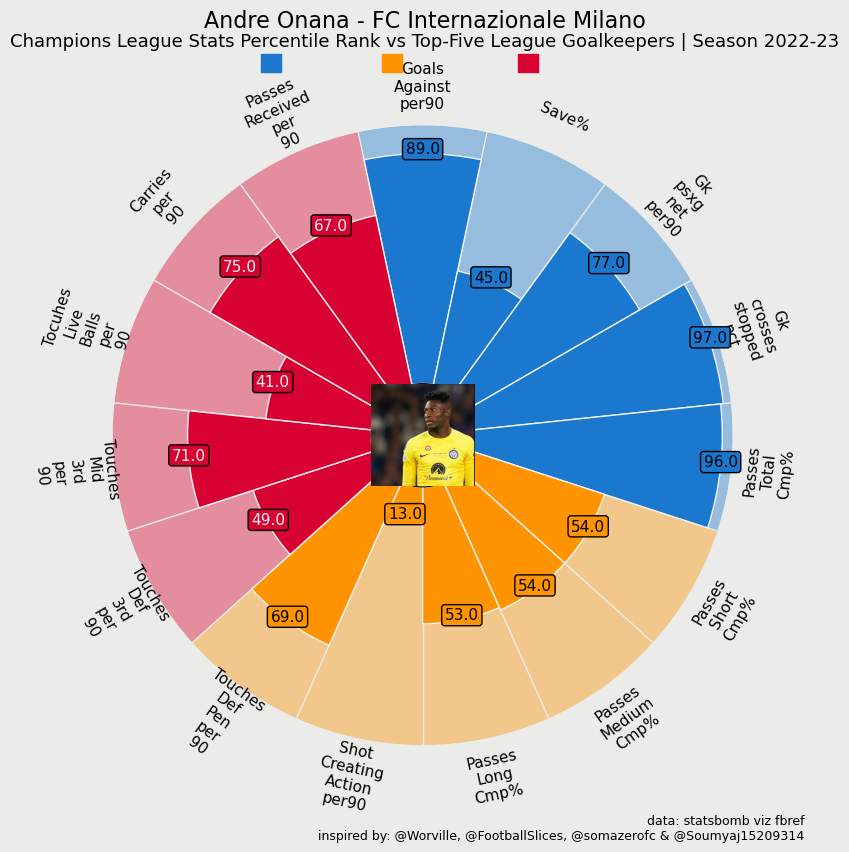

In [87]:
import matplotlib.pyplot as plt
from mplsoccer import PyPizza

slice_colors = ["#1A78CF"] * 5 + ["#FF9300"] * 5 + ["#D70232"] * 5
text_colors = ["#000000"] * 10 + ["#F2F2F2"] * 5

baker = PyPizza(
params=split_params, # list of parameters
background_color="#EBEBE9", # background color
straight_line_color="#EBEBE9", # color for straight lines
straight_line_lw=1, # linewidth for straight lines
last_circle_lw=0, # linewidth of last circle
other_circle_lw=0, # linewidth for other circles
inner_circle_size=20 # size of inner circle
)

fig, ax = baker.make_pizza(
    values,  # list of values
    figsize=(8, 8.5),  # adjust figsize according to your need
    color_blank_space="same",  # use same color to fill blank space
    slice_colors=slice_colors,  # color for individual slices
    value_colors=text_colors,  # color for the value-text
    value_bck_colors=slice_colors,  # color for the blank spaces
    blank_alpha=0.4,  # alpha for blank-space colors
    param_location=115,  # move param labels further out
    kwargs_slices=dict(
        edgecolor="#F2F2F2", zorder=2, linewidth=1
    ),  # values to be used when plotting slices
    kwargs_params=dict(
        color="#000000", fontsize=11,
        va="center"  # ha is removed here
    ),  # values to be used when adding parameters
    kwargs_values=dict(
        color="#000000", fontsize=11,
        zorder=3,
        bbox=dict(
            edgecolor="#000000", facecolor="cornflowerblue",
            boxstyle="round,pad=0.2", lw=1
        )
    )  # values to be used when adding parameter-values
)


fig.text(
0.515, 0.975, "Andre Onana - FC Internazionale Milano", size=16,
ha="center", color="#000000"
)


fig.text(
0.515, 0.953,
"Champions League Stats Percentile Rank vs Top-Five League Goalkeepers | Season 2022-23",
size=13,
ha="center", color="#000000"
)


CREDIT_1 = "data: statsbomb viz fbref"
CREDIT_2 = "inspired by: @Worville, @FootballSlices, @somazerofc & @Soumyaj15209314"

fig.text(
0.99, 0.02, f"{CREDIT_1}\n{CREDIT_2}", size=9,
color="#000000",
ha="right"
)


fig.patches.extend([
plt.Rectangle(
(0.31, 0.9225), 0.025, 0.021, fill=True, color="#1a78cf",
transform=fig.transFigure, figure=fig
),
plt.Rectangle(
(0.462, 0.9225), 0.025, 0.021, fill=True, color="#ff9300",
transform=fig.transFigure, figure=fig
),
plt.Rectangle(
(0.632, 0.9225), 0.025, 0.021, fill=True, color="#d70232",
transform=fig.transFigure, figure=fig
),
])


ax_image = add_image(
fdj_cropped, fig, left=0.4478, bottom=0.4315, width=0.13, height=0.127
) # these values might differ when you are plotting

plt.show()


In [88]:
gk_2023.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad',
       'Comp', 'Age', 'Born', 'MP', 'Starts', 'Min', '90s', 'Goals_Against',
       'Goals_Against_per90', 'Shots_on_Target_Against', 'Saves', 'Save%', 'W',
       'D', 'L', 'CS', 'CS%', 'PK_attempts', 'PK_Allowed', 'PKs_Saved',
       'PK_missed', 'Save%(Penalty Kicks)', 'Gk_free_kick_goals_against',
       'Gk_corner_kick_goals_against', 'Gk_own_goals_against', 'Gk_psxg',
       'Gk_psxg_per_shot_on_target_against', 'Gk_psxg_diff',
       'Gk_psxg_net_per90', 'Gk_passes_completed_launched',
       'Gk_passes_attempted_launched', 'Gk_passes_pct_launched', 'Gk_passes',
       'Gk_passes_throws', 'Gk_pct_passes_launched', 'Gk_passes_length_avg',
       'Gk_goal_kicks', 'Gk_pct_goal_kicks_launched',
       'Gk_goal_kick_length_avg', 'Gk_crosses_faced', 'Gk_crosses_stopped',
       'Gk_crosses_stopped_pct', 'Gk_def_actions_outside_pen_area',
       'Gk_def_actions_outside_pen_area_per90', 'Gk_avg_distance_def_actions

In [89]:
gk_2023[gk_2023['Player']=='Alisson']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
3,3,3,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37,37,3330,37.0,43.0,1.16,147.0,105.0,72.1,19,9.0,9.0,14.0,37.8,4.0,2.0,1.0,1.0,33.3,0.0,0.0,2.0,51.1,0.33,10.1,0.27,116,283,41.0,1256.0,210,18.4,26.9,193.0,26.9,31.3,397.0,23.0,5.8,89.0,2.41,19.8,51,231,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,NaN,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,2.0,3.0,0.08,0.05,1124.0,1498.0,39.0,1536.0,985.0,901.0,30.38,40.49,1.05,41.51,26.62,24.35


In [90]:
# Get player names from gk_2022
player_names_2024 = gk_2024['Player'].tolist()



In [91]:
# Get player names from gk_2022
player_names_2023 = gk_2023['Player'].tolist()

# Filter out names not present in gk_2024
player_names_2023_filtered = [name for name in player_names_2023 if name in gk_2024['Player'].tolist()]
player_names_2023_filtered

['Alisson',
 'Kepa Arrizabalaga',
 'Oliver Baumann',
 'Marco Bizot',
 'Janis Blaswich',
 'Marco Carnesecchi',
 'Koen Casteels',
 'Lucas Chevalier',
 'Andrea Consigli',
 'Benoît Costil',
 'Michele Di Gregorio',
 'Mory Diaw',
 'Stole Dimitrievski',
 'Yehvann Diouf',
 'Marko Dmitrović',
 'Gianluigi Donnarumma',
 'Ederson',
 'Wladimiro Falcone',
 'Mark Flekken',
 'Paulo Gazzaniga',
 'Vicente Guaita',
 'Dean Henderson',
 'Sergio Herrera',
 'Lukáš Hrádecký',
 'Gregor Kobel',
 'Alban Lafont',
 'Jeremías Ledesma',
 'Bernd Leno',
 'Anthony Lopes',
 'Pau López',
 'Mike Maignan',
 'Giorgi Mamardashvili',
 'Steve Mandanda',
 'Emiliano Martínez',
 'Alex Meret',
 'Vanja Milinković-Savić',
 'Lorenzo Montipò',
 'Juan Musso',
 'Yvon Mvogo',
 'Neto',
 'Manuel Neuer',
 'Alexander Nübel',
 'Jan Oblak',
 'Guillermo Ochoa',
 'André Onana',
 'Rui Patrício',
 'Jordan Pickford',
 'Nick Pope',
 'Ivan Provedel',
 'Predrag Rajković',
 'David Raya',
 'Álex Remiro',
 'Manuel Riemann',
 'Frederik Rønnow',
 'José Sá'

In [92]:
# Filter gk_2023 based on player_names_2023_filtered
gk_2023_filtered = gk_2023[gk_2023['Player'].isin(player_names_2023_filtered)]
gk_2023_filtered

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
3,3,3,Alisson,br BRA,GK,Liverpool,eng Premier League,29,1992,37,37,3330,37.0,43.0,1.16,147.0,105.0,72.1,19,9.0,9.0,14.0,37.8,4.0,2.0,1.0,1.0,33.3,0.0,0.0,2.0,51.1,0.33,10.1,0.27,116,283,41.0,1256.0,210,18.4,26.90,193.0,26.9,31.30,397.0,23.0,5.8,89.0,2.41,19.80,51,231,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,NaN,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,2.0,3.0,0.08,0.05,1124.0,1498.0,39.0,1536.0,985.0,901.0,30.38,40.49,1.05,41.51,26.62,24.35
5,5,5,Kepa Arrizabalaga,es ESP,GK,Chelsea,eng Premier League,27,1994,29,29,2565,28.5,33.0,1.16,120.0,90.0,73.3,8,9.0,12.0,9.0,31.0,1.0,1.0,0.0,0.0,0.0,1.0,4.0,3.0,35.0,0.29,5.0,0.18,68,213,31.9,864.0,151,17.1,26.30,182.0,35.7,31.50,332.0,15.0,4.5,52.0,1.82,16.90,64,147,871.0,1046.0,83.3,19299.0,11448.0,287.0,289.0,99.3,390.0,395.0,98.7,190.0,357.0,53.2,NaN,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,1.0,0.04,0.00,892.0,1103.0,16.0,1119.0,654.0,604.0,31.30,38.70,0.56,39.26,22.95,21.19
10,10,10,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga,32,1990,34,34,3060,34.0,57.0,1.68,161.0,105.0,65.8,10,6.0,18.0,5.0,14.7,3.0,2.0,0.0,1.0,0.0,1.0,11.0,1.0,50.4,0.31,-5.6,-0.16,206,525,39.2,1164.0,168,35.3,33.60,249.0,45.8,39.30,529.0,43.0,8.1,43.0,1.26,13.40,114,410,1068.0,1417.0,75.4,29033.0,20956.0,239.0,239.0,100.0,489.0,493.0,99.2,331.0,670.0,49.4,NaN,0.0,0.1,0.0,1.0,28.0,1.0,0.0,1.0,1.0,4.0,0.12,0.03,1219.0,1489.0,15.0,1503.0,903.0,757.0,35.85,43.79,0.44,44.21,26.56,22.26
15,15,15,Marco Bizot,nl NED,GK,Brest,fr Ligue 1,31,1991,37,37,3330,37.0,54.0,1.46,176.0,122.0,73.3,11,10.0,16.0,8.0,21.6,9.0,7.0,2.0,0.0,22.2,1.0,11.0,2.0,54.9,0.26,2.9,0.08,198,477,41.5,806.0,163,38.2,35.50,289.0,58.5,43.90,520.0,30.0,5.8,25.0,0.68,11.60,169,307,799.0,1096.0,72.9,24651.0,17824.0,87.0,87.0,100.0,405.0,411.0,98.5,305.0,595.0,51.3,NaN,0.0,0.1,0.0,0.0,14.0,1.0,0.0,0.0,0.0,5.0,0.14,0.00,1060.0,1199.0,1.0,1200.0,749.0,472.0,28.65,32.41,0.03,32.43,20.24,12.76
17,17,17,Janis Blaswich,de GER,GK,RB Leipzig,de Bundesliga,31,1991,26,26,2340,26.0,29.0,1.12,75.0,45.0,69.3,16,4.0,6.0,7.0,26.9,7.0,6.0,1.0,0.0,14.3,0.0,2.0,0.0,26.9,0.27,-2.1,-0.08,59,189,31.2,985.0,126,14.9,25.30,156.0,26.9,30.00,288.0,20.0,6.9,39.0,1.50,17.00,41,146,988.0,1142.0,86.5,21548.0,10888.0,248.0,249.0,99.6,588.0,593.0,99.2,147.0,292.0,50.3,NaN,0.0,0.0,0.0,0.0,11.0,0.0,0.0,1.0,0.0,0.0,0.00,0.00,846.0,1160.0,31.0,1191.0,786.0,752.0,32.54,44.62,1.19,45.81,30.23,28.92
24,24,24,Marco Carnesecchi,it ITA,GK,Cremonese,it Serie A,22,2000,27,27,2430,27.0,47.0,1.74,153.0,107.0,70.6,4,9.0,14.0,4.0,14.8,2.0,2.0

In [93]:
# Get player names from gk_2022
player_names_2022 = gk_2022['Player'].tolist()

# Filter out names not present in gk_2024
player_names_2022_filtered = [name for name in player_names_2022 if name in gk_2024['Player'].tolist()]
player_names_2022_filtered

['Alisson',
 'Oliver Baumann',
 'Etrit Berisha',
 'Marco Bizot',
 'Koen Casteels',
 'Andrea Consigli',
 'Benoît Costil',
 'Arthur Desmas',
 'Stole Dimitrievski',
 'Gianluigi Donnarumma',
 'Martin Dúbravka',
 'Ederson',
 'Mark Flekken',
 'Vicente Guaita',
 'Péter Gulácsi',
 'Sergio Herrera',
 'Lukáš Hrádecký',
 'Gregor Kobel',
 'Alban Lafont',
 'Jeremías Ledesma',
 'Anthony Lopes',
 'Pau López',
 'Mike Maignan',
 'Giorgi Mamardashvili',
 'Emiliano Martínez',
 'Luís Maximiano',
 'Vanja Milinković-Savić',
 'Lorenzo Montipò',
 'Juan Musso',
 'Manuel Neuer',
 'Alexander Nübel',
 'Jan Oblak',
 'Alexandre Oukidja',
 'Rui Patrício',
 'Jordan Pickford',
 'Nick Pope',
 'Ivan Provedel',
 'Predrag Rajković',
 'David Raya',
 'Álex Remiro',
 'Manuel Riemann',
 'José Sá',
 'Robert Sánchez',
 'Marvin Schwäbe',
 'Matz Sels',
 'Rui Silva',
 'Marco Silvestri',
 'Unai Simón',
 'Łukasz Skorupski',
 'Yann Sommer',
 'David Soria',
 'Wojciech Szczęsny',
 'Marc-André ter Stegen',
 'Pietro Terracciano',
 'Kevin

In [94]:
# Filter gk_2022 based on player_names_2022_filtered
gk_2022_filtered = gk_2022[gk_2022['Player'].isin(player_names_2022_filtered)]
gk_2022_filtered

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
2,2,2,Alisson,br BRA,GK,Liverpool,eng Premier League,28,1992,36,36,3240,36.0,24,0.67,99,76,75.8,27,7,2,20,55.6,0,0,0,0,0.0,0,3,1,24.4,0.25,1.4,0.04,114,258,44.2,1216,211,16.5,26.3,172,33.1,33.4,340,22,6.5,89,2.47,18.7,56,200,1214,1388,87.5,28439,18286,275,276,99.6,686,699,98.1,249,409,60.9,NaN,0.2,0.0,0.8,1,16,1,0,1,1,2,0.06,0.03,1042,1452,17,1469,873,836,28.94,40.33,0.47,40.81,24.25,23.22
12,12,12,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga,31,1990,33,33,2970,33.0,57,1.73,155,98,64.5,12,7,14,8,24.2,4,2,1,1,33.3,0,9,1,51.5,0.33,-4.5,-0.14,138,393,35.1,1302,185,26.1,29.0,216,24.5,28.8,420,27,6.4,65,1.97,16.7,52,339,1225,1523,80.4,28367,18814,366,367,99.7,589,595,99.0,258,541,47.7,NaN,0.0,0.1,0.0,0,18,0,0,0,0,2,0.06,0.00,1277,1592,23,1609,1005,895,38.70,48.24,0.70,48.76,30.45,27.12
17,17,17,Etrit Berisha,al ALB,GK,Torino,it Serie A,32,1989,10,10,900,10.0,8,0.80,41,32,85.4,3,4,3,4,40.0,3,2,1,0,33.3,0,0,0,10.2,0.18,2.2,0.22,53,188,28.2,240,37,50.0,39.4,78,87.2,58.6,148,7,4.7,10,1.00,14.6,68,120,176,319,55.2,5860,4579,23,24,95.8,79,79,100.0,74,215,34.4,NaN,0.0,0.0,0.0,0,6,0,0,0,0,0,0.00,0.00,289,344,1,345,183,118,28.90,34.40,0.10,34.50,18.30,11.80
19,19,21,Marco Bizot,nl NED,GK,Brest,fr Ligue 1,30,1991,38,38,3420,38.0,57,1.50,170,115,68.8,13,9,16,7,18.4,4,4,0,0,0.0,0,8,2,51.0,0.28,-4.0,-0.10,290,624,46.5,877,205,43.1,37.4,328,75.0,53.1,541,16,3.0,34,0.89,14.1,246,377,851,1207,70.5,29158,23011,86,86,100.0,371,376,98.7,393,742,53.0,NaN,0.1,0.1,0.9,2,22,0,0,0,2,6,0.16,0.05,1161,1312,4,1317,698,450,30.55,34.53,0.11,34.66,18.37,11.84
31,31,33,Koen Casteels,be BEL,GK,Wolfsburg,de Bundesliga,29,1992,28,28,2520,28.0,40,1.43,118,76,68.6,11,6,11,10,35.7,6,3,2,1,40.0,0,4,0,42.0,0.32,2.0,0.07,165,370,44.6,873,135,30.6,32.3,204,50.5,42.1,413,31,7.5,30,1.07,14.8,103,267,843,1079,78.1,24035,16216,144,145,99.3,389,395,98.5,307,532,57.7,NaN,0.0,0.0,0.0,0,13,0,0,1,0,1,0.04,0.00,916,1136,11,1143,681,605,32.71,40.57,0.39,40.82,24.32,21.61
34,34,36,Andrea Consigli,it ITA,GK,Sassuolo,it Serie A,34,1987,37,37,3322,36.9,63,1.71,171,108,67.8,13,11,13,3,8.1,9,8,1,0,11.1,0,10,1,56.0,0.28,-6.0,-0.16,186,431,43.2,1219,174,29.0,30.9,246,31.7,28.8,491,21,4.3,30,0.81,13.4,77,353,1161,1469,79.0,29559,19668,291,294,99.0,475,484,98.1,381,673,56.6,NaN,0.0,0.0,0.0,1,7,1,0,0,1,8,0.22,0.03,1199,1557,15,1572,915,783,32.49,42.20,0.41,42.60,24.80,21.22
35,35,37,Benoît Costil,fr FRA,GK,Bordeaux,fr Ligue 1,34,1987,25,25,2250,25.0,62,2.48,133,72,57.1,3,8,14,0,0.0,5,5,0,0,0.0,1,5,1,44.1,0.29,-16.9,-0.68,181,424,42.7,686,78,40.2,35.3,218,67.9,47.9

In [95]:
# Get player names from gk_2021
player_names_2021 = gk_2021['Player'].tolist()

# Filter out names not present in gk_2023
player_names_2021_filtered = [name for name in player_names_2021 if name in gk_2024['Player'].tolist()]
player_names_2021_filtered

['Alisson',
 'Alphonse Areola',
 'Oliver Baumann',
 'Koen Casteels',
 'Andrea Consigli',
 'Benoît Costil',
 'Marko Dmitrović',
 'Gianluigi Donnarumma',
 'Martin Dúbravka',
 'Ederson',
 'Vicente Guaita',
 'Péter Gulácsi',
 'Dean Henderson',
 'Sergio Herrera',
 'Lukáš Hrádecký',
 'Sam Johnstone',
 'Gregor Kobel',
 'Alban Lafont',
 'Benjamin Lecomte',
 'Jeremías Ledesma',
 'Bernd Leno',
 'Anthony Lopes',
 'Pau López',
 'Mike Maignan',
 'Steve Mandanda',
 'Emiliano Martínez',
 'Alex Meret',
 'Lorenzo Montipò',
 'Juan Musso',
 'Manuel Neuer',
 'Jan Oblak',
 'Alexandre Oukidja',
 'Rui Patrício',
 'Jordan Pickford',
 'Nick Pope',
 'Ivan Provedel',
 'Predrag Rajković',
 'Álex Remiro',
 'Frederik Rønnow',
 'Robert Sánchez',
 'Rui Silva',
 'Marco Silvestri',
 'Unai Simón',
 'Łukasz Skorupski',
 'Yann Sommer',
 'David Soria',
 'Wojciech Szczęsny',
 'Marc-André ter Stegen',
 'Kevin Trapp',
 'Iván Villar',
 'Robin Zentner']

In [96]:
# Filter gk_2022 based on player_names_2022_filtered
gk_2021_filtered = gk_2021[gk_2021['Player'].isin(player_names_2021_filtered)]
gk_2021_filtered

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
2,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,27.0,1992.0,33.0,33.0,2970.0,33.0,32.0,0.97,115.0,82.0,75.7,18.0,8.0,7.0,10.0,30.3,8.0,4.0,1.0,3.0,20.0,1.0,4.0,0.0,35.0,0.27,3.0,0.09,74.0,194.0,38.1,980.0,165.0,14.9,25.7,173.0,27.7,30.4,341.0,20.0,5.9,87.0,2.64,18.6,47.0,146.0,1000,1157,86.4,22600,14023,223,225,99.1,578,590,98.0,191,330,57.9,NaN,0.0,0.0,0.0,0,4,1,0,1,1,2,0.06,0.03,931,1224,16,1239,709,669,28.21,37.09,0.48,37.55,21.48,20.27
6,6.0,6.0,Alphonse Areola,fr FRA,GK,Fulham,eng Premier League,27.0,1993.0,36.0,36.0,3240.0,36.0,48.0,1.33,161.0,114.0,73.9,5.0,13.0,18.0,9.0,25.0,6.0,6.0,0.0,0.0,0.0,0.0,2.0,1.0,50.5,0.28,3.5,0.10,144.0,389.0,37.0,760.0,173.0,32.8,30.0,251.0,55.8,39.8,501.0,26.0,5.2,31.0,0.86,13.0,140.0,249.0,746,1014,73.6,18222,12486,272,274,99.3,254,256,99.2,204,465,43.9,NaN,0.0,0.0,0.0,0,12,1,0,0,0,5,0.18,0.00,972,1096,5,1101,574,414,27.00,30.44,0.14,30.58,15.94,11.50
12,12.0,12.0,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga,30.0,1990.0,31.0,31.0,2790.0,31.0,51.0,1.65,132.0,81.0,65.9,10.0,8.0,13.0,6.0,19.4,9.0,6.0,2.0,1.0,25.0,0.0,4.0,2.0,49.4,0.32,0.4,0.01,134.0,407.0,32.9,1143.0,176.0,29.2,29.9,204.0,35.8,32.0,417.0,14.0,3.4,53.0,1.71,18.3,73.0,333.0,1049,1349,77.8,24414,16656,298,298,100.0,486,495,98.2,246,535,46.0,NaN,0.0,0.1,0.0,0,15,0,0,2,0,2,0.06,0.00,1069,1414,15,1429,827,756,34.48,45.61,0.48,46.10,26.68,24.39
32,32.0,32.0,Koen Casteels,be BEL,GK,Wolfsburg,de Bundesliga,28.0,1992.0,32.0,32.0,2880.0,32.0,33.0,1.03,108.0,74.0,72.2,17.0,9.0,6.0,14.0,43.8,5.0,3.0,2.0,0.0,40.0,1.0,2.0,1.0,32.7,0.26,0.7,0.02,191.0,462.0,41.3,1048.0,166.0,31.9,32.6,203.0,63.1,48.4,450.0,25.0,5.6,57.0,1.78,17.3,128.0,334.0,951,1253,75.9,27496,19003,139,139,100.0,482,485,99.4,329,625,52.6,NaN,0.0,0.1,0.0,0,14,0,0,0,2,5,0.31,0.12,1029,1302,10,1311,783,715,32.16,40.69,0.31,40.97,24.47,22.34
37,37.0,37.0,Andrea Consigli,it ITA,GK,Sassuolo,it Serie A,33.0,1987.0,37.0,37.0,3330.0,37.0,56.0,1.51,185.0,129.0,71.9,17.0,10.0,10.0,7.0,18.9,5.0,4.0,1.0,0.0,20.0,0.0,4.0,1.0,53.6,0.27,-1.4,-0.04,118.0,319.0,37.0,1114.0,172.0,24.0,27.7,240.0,21.7,24.1,513.0,26.0,5.1,34.0,0.92,15.1,52.0,267.0,1102,1358,81.1,24274,16006,418,421,99.3,397,410,96.8,274,510,53.7,NaN,0.0,0.0,0.0,0,18,0,0,1,1,4,0.11,0.03,1075,1444,20,1464,859,712,29.05,39.03,0.54,39.57,23.22,19.24
40,40.0,40.0,Benoît Costil,fr FRA,GK,Bordeaux,fr Ligue 1,33.0,1987.0,38.0,38.0,3420.0,38.0,56.0,1.47,156.0,100.0,68.6,13.0,6.0,19.0,14.0,36.8,8.0,7.0,1.0,0.0,12.5,2.0,6.0,1.0,48.2,0.26,-6.8,-0.18,264.0,610.0,43.3,1034.0,144.0,40.0,35.3,292.0,67.1

In [97]:
len(gk_2021_filtered)

51

In [98]:
len(gk_2022_filtered)

57

In [99]:
len(gk_2023_filtered)

74

In [100]:
full_Gk = pd.concat([gk_2024,gk_2023_filtered, gk_2022_filtered, gk_2021_filtered], ignore_index=True)
full_Gk

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
1,2.0,2.0,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,31.0,31.0,2699.0,30.0,53.0,1.77,188.0,136.0,74.5,11.0,9.0,11.0,4.0,12.9,7.0,5.0,2.0,0.0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148.0,282.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
2,4.0,4.0,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,14.0,13.0,1198.0,13.3,9.0,0.68,38.0,30.0,76.3,10.0,2.0,1.0,8.0,61.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17.0,74.0,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
3,5.0,5.0,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,34.0,3060.0,34.0,58.0,1.71,158.0,99.0,65.2,11.0,9.0,14.0,10.0,29.4,5.0,3.0,2.0,0.0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.20,241.0,67.2,50.70,485.0,31.0,6.4,30.0,0.88,13.60,161.0,406.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.00,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44
4,8.0,8.0,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,17.0,1530.0,17.0,28.0,1.65,86.0,58.0,67.4,3.0,4.0,10.0,3.0,17.6,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.40,122.0,77.9,55.90,275.0,23.0,8.4,18.0,1.06,14.20,95.0,259.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,0.00,581.0,719.0,14.0,734.0,408.0,301.0,34.18,42.29,0.82,43.18,24.00,17.71
5,10.0,10.0,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga

In [101]:
duplicate_players = full_Gk[full_Gk.duplicated(subset=['Player','Pos'], keep=False)]['Player'].unique()
duplicate_players

array(['Alisson', 'Alphonse Areola', 'Kepa Arrizabalaga',
       'Oliver Baumann', 'Etrit Berisha', 'Marco Bizot', 'Janis Blaswich',
       'Marco Carnesecchi', 'Koen Casteels', 'Lucas Chevalier',
       'Andrea Consigli', 'Benoît Costil', 'Arthur Desmas',
       'Michele Di Gregorio', 'Mory Diaw', 'Stole Dimitrievski',
       'Yehvann Diouf', 'Marko Dmitrović', 'Gianluigi Donnarumma',
       'Martin Dúbravka', 'Ederson', 'Wladimiro Falcone', 'Mark Flekken',
       'Paulo Gazzaniga', 'Vicente Guaita', 'Péter Gulácsi',
       'Dean Henderson', 'Sergio Herrera', 'Lukáš Hrádecký',
       'Sam Johnstone', 'Gregor Kobel', 'Alban Lafont',
       'Benjamin Lecomte', 'Jeremías Ledesma', 'Bernd Leno',
       'Anthony Lopes', 'Pau López', 'Mike Maignan',
       'Giorgi Mamardashvili', 'Steve Mandanda', 'Emiliano Martínez',
       'Luís Maximiano', 'Alex Meret', 'Vanja Milinković-Savić',
       'Lorenzo Montipò', 'Juan Musso', 'Yvon Mvogo', 'Neto',
       'Manuel Neuer', 'Alexander Nübel', 'Jan O

In [102]:
len(duplicate_players)

82

In [103]:
duplicate_players_stats = full_Gk[full_Gk['Player'].isin(duplicate_players)]
duplicate_players_stats


,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
1,2.0,2.0,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,31.0,31.0,2699.0,30.0,53.0,1.77,188.0,136.0,74.5,11.0,9.0,11.0,4.0,12.9,7.0,5.0,2.0,0.0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148.0,282.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
2,4.0,4.0,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,14.0,13.0,1198.0,13.3,9.0,0.68,38.0,30.0,76.3,10.0,2.0,1.0,8.0,61.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17.0,74.0,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
5,10.0,10.0,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga,33.0,1990.0,34.0,34.0,3060.0,34.0,66.0,1.94,211.0,143.0,69.7,13.0,7.0,14.0,2.0,5.9,5.0,2.0,3.0,0.0,60.0,3.0,9.0,1.0,68.6,0.31,3.6,0.11,208.0,529.0,39.3,1159.0,165.0,33.7,32.70,249.0,55.4,44.90,545.0,31.0,5.7,73.0,2.15,16.70,137.0,390.0,1055.0,1412.0,74.7,29010.0,21712.0,217.0,219.0,99.1,508.0,513.0,99.0,318.0,664.0,47.9,1,0.2,0.1,0.8,2.0,24.0,2.0,0.0,1.0,1.0,6.0,0.18,0.03,1225.0,1492.0,31.0,1521.0,817.0,735.0,36.03,43.88,0.91,44.74,24.03,21.62
7,13.0,13.0,Etrit Berisha,al ALB,GK,Empoli,it Serie A,34.0,1989.0,14.0,14.0,1260.0,14.0,25.0,1.79,74.0,49.0,68.9,3.0,3.0,8.0,4.0,28.6,3.0,2.0,1.0,0.0,33.3,0.0,5.0,1.0,20.7,0.24,-3.3,-0.24,44.0,184.0,23.9,400.0,75.0,34.8,33.00,90.0,50.0,40.80,236.0,11.0,4.7,10.0,0.71,12.40,45.0,139.0,339.0,494.0,68.6,8491.0,5766.0,73.0,73.0,100.0,184.0,188.0,97.9,81.0,228.0,35.5,0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,2.0,0.14,0.00,456.0,530.0,2.0,532.0,314.0,245.0,32.57,37.86,0.14,38.00,22.43,17.50
8,15.0,15.0,Marco Bizot,nl NED,GK,Brest,fr Ligue 1,32.0,1991.0,32

In [104]:
len(duplicate_players_stats)

264

In [105]:
# Convert the filtered player lists into sets
players_set_2021 = set(player_names_2021_filtered)
players_set_2022 = set(player_names_2022_filtered)
players_set_2023 = set(player_names_2023_filtered)

# Find the common players present in 2021, 2022, and 2023
common_players_2022 = players_set_2021.intersection(players_set_2022)
common_players = common_players_2022.intersection(players_set_2023)

# Convert the common players back to a list
common_players_list = list(common_players)
common_players_list

['Juan Musso',
 'Alisson',
 'Koen Casteels',
 'Álex Remiro',
 'Marco Silvestri',
 'Anthony Lopes',
 'Robin Zentner',
 'Nick Pope',
 'Rui Patrício',
 'Ivan Provedel',
 'Gregor Kobel',
 'Predrag Rajković',
 'Jan Oblak',
 'Mike Maignan',
 'Manuel Neuer',
 'Pau López',
 'Jordan Pickford',
 'Robert Sánchez',
 'Rui Silva',
 'David Soria',
 'Vicente Guaita',
 'Marc-André ter Stegen',
 'Alban Lafont',
 'Lukáš Hrádecký',
 'Emiliano Martínez',
 'Gianluigi Donnarumma',
 'Ederson',
 'Yann Sommer',
 'Jeremías Ledesma',
 'Kevin Trapp',
 'Oliver Baumann',
 'Wojciech Szczęsny',
 'Unai Simón',
 'Lorenzo Montipò',
 'Sergio Herrera',
 'Benoît Costil',
 'Łukasz Skorupski',
 'Andrea Consigli']

In [106]:
len(common_players_list)

38

In [107]:
full_Gk[full_Gk['Player']=='Alisson']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.7,116.0,33.6,33.3,299.0,13.0,4.3,33.0,1.18,17.7,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
116,3.0,3.0,Alisson,br BRA,GK,Liverpool,eng Premier League,29.0,1992.0,37.0,37.0,3330.0,37.0,43.0,1.16,147.0,105.0,72.1,19.0,9.0,9.0,14.0,37.8,4.0,2.0,1.0,1.0,33.3,0.0,0.0,2.0,51.1,0.33,10.1,0.27,116.0,283.0,41.0,1256.0,210.0,18.4,26.9,193.0,26.9,31.3,397.0,23.0,5.8,89.0,2.41,19.8,51.0,231.0,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,NaN,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,2.0,3.0,0.08,0.05,1124.0,1498.0,39.0,1536.0,985.0,901.0,30.38,40.49,1.05,41.51,26.62,24.35
190,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,28.0,1992.0,36.0,36.0,3240.0,36.0,24.0,0.67,99.0,76.0,75.8,27.0,7.0,2.0,20.0,55.6,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,24.4,0.25,1.4,0.04,114.0,258.0,44.2,1216.0,211.0,16.5,26.3,172.0,33.1,33.4,340.0,22.0,6.5,89.0,2.47,18.7,56.0,200.0,1214,1388,87.5,28439,18286,275,276,99.6,686,699,98.1,249,409,60.9,NaN,0.2,0.0,0.8,1,16,1,0,1,1,2,0.06,0.03,1042,1452,17,1469,873,836,28.94,40.33,0.47,40.81,24.25,23.22
247,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,27.0,1992.0,33.0,33.0,2970.0,33.0,32.0,0.97,115.0,82.0,75.7,18.0,8.0,7.0,10.0,30.3,8.0,4.0,1.0,3.0,20.0,1.0,4.0,0.0,35.0,0.27,3.0,0.09,74.0,194.0,38.1,980.0,165.0,14.9,25.7,173.0,27.7,30.4,341.0,20.0,5.9,87.0,2.64,18.6,47.0,146.0,1000,1157,86.4,22600,14023,223,225,99.1,578,590,98.0,191,330,57.9,NaN,0.0,0.0,0.0,0,4,1,0,1,1,2,0.06,0.03,931,1224,16,1239,709,669,28.21,37.09,0.48,37.55,21.48,20.27


In [108]:
full_Gk[full_Gk['Player']=='Alex Cordaz']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90


In [109]:
full_Gk.head()

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.7,116.0,33.6,33.3,299.0,13.0,4.3,33.0,1.18,17.7,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.0,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
1,2.0,2.0,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,31.0,31.0,2699.0,30.0,53.0,1.77,188.0,136.0,74.5,11.0,9.0,11.0,4.0,12.9,7.0,5.0,2.0,0.0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.8,219.0,67.6,47.3,468.0,27.0,5.8,7.0,0.23,8.9,148.0,282.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.0,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
2,4.0,4.0,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,14.0,13.0,1198.0,13.3,9.0,0.68,38.0,30.0,76.3,10.0,2.0,1.0,8.0,61.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.0,70.0,25.7,30.6,157.0,6.0,3.8,10.0,0.75,14.7,17.0,74.0,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
3,5.0,5.0,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,34.0,3060.0,34.0,58.0,1.71,158.0,99.0,65.2,11.0,9.0,14.0,10.0,29.4,5.0,3.0,2.0,0.0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.2,241.0,67.2,50.7,485.0,31.0,6.4,30.0,0.88,13.6,161.0,406.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.0,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44
4,8.0,8.0,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,17.0,1530.0,17.0,28.0,1.65,86.0,58.0,67.4,3.0,4.0,10.0,3.0,17.6,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.4,122.0,77.9,55.9,275.0,23.0,8.4,18.0,1.06,14.2,95.0,259.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,0.0,581.0,719.0,14.0,734.0,408.0,301.0,34.18,42.29,0.82,43.18,24.00,17.71


In [110]:
unique_comps = full_Gk['Comp'].unique()
print(unique_comps)


['eng Premier League' 'es La Liga' 'de Bundesliga' 'fr Ligue 1'
 'it Serie A' 'eng Premier League+fr Ligue 1' 'es La Liga+fr Ligue 1']


In [111]:
# Defining a function to check if a league is in the 'Comp' column
def check_league_in_comp(row, league):
    if league in row['Comp']:
        return 1
    else:
        return 0

# Adding the new columns
full_Gk['Seasons at top 5'] = 1
full_Gk['Seasons in PL'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'eng Premier League'), axis=1)
full_Gk['Seasons in Liga'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'es La Liga'), axis=1)
full_Gk['Seasons in Serie A'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'it Serie A'), axis=1)
full_Gk['Seasons in Ligue 1'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'fr Ligue 1'), axis=1)
full_Gk['Seasons in Bundesliga'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'de Bundesliga'), axis=1)


In [112]:
full_Gk.head()

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.7,116.0,33.6,33.3,299.0,13.0,4.3,33.0,1.18,17.7,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.0,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29,1,1,0,0,0,0
1,2.0,2.0,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,31.0,31.0,2699.0,30.0,53.0,1.77,188.0,136.0,74.5,11.0,9.0,11.0,4.0,12.9,7.0,5.0,2.0,0.0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.8,219.0,67.6,47.3,468.0,27.0,5.8,7.0,0.23,8.9,148.0,282.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.0,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50,1,1,0,0,0,0
2,4.0,4.0,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,14.0,13.0,1198.0,13.3,9.0,0.68,38.0,30.0,76.3,10.0,2.0,1.0,8.0,61.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.0,70.0,25.7,30.6,157.0,6.0,3.8,10.0,0.75,14.7,17.0,74.0,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56,1,0,1,0,0,0
3,5.0,5.0,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,34.0,3060.0,34.0,58.0,1.71,158.0,99.0,65.2,11.0,9.0,14.0,10.0,29.4,5.0,3.0,2.0,0.0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.2,241.0,67.2,50.7,485.0,31.0,6.4,30.0,0.88,13.6,161.0,406.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.0,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44,1,0,0,0,0,1
4,8.0,8.0,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,17.0,1530.0,17.0,28.0,1.65,86.0,58.0,67.4,3.0,4.0,10.0,3.0,17.6,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.4,122.0,77.9,55.9,275.0,23.0,8.4,18.0,1.06,14.2,95.0,259.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,

In [113]:
full_Gk[full_Gk['Player']=='Alisson']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.7,116.0,33.6,33.3,299.0,13.0,4.3,33.0,1.18,17.7,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29,1,1,0,0,0,0
116,3.0,3.0,Alisson,br BRA,GK,Liverpool,eng Premier League,29.0,1992.0,37.0,37.0,3330.0,37.0,43.0,1.16,147.0,105.0,72.1,19.0,9.0,9.0,14.0,37.8,4.0,2.0,1.0,1.0,33.3,0.0,0.0,2.0,51.1,0.33,10.1,0.27,116.0,283.0,41.0,1256.0,210.0,18.4,26.9,193.0,26.9,31.3,397.0,23.0,5.8,89.0,2.41,19.8,51.0,231.0,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,NaN,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,2.0,3.0,0.08,0.05,1124.0,1498.0,39.0,1536.0,985.0,901.0,30.38,40.49,1.05,41.51,26.62,24.35,1,1,0,0,0,0
190,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,28.0,1992.0,36.0,36.0,3240.0,36.0,24.0,0.67,99.0,76.0,75.8,27.0,7.0,2.0,20.0,55.6,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,24.4,0.25,1.4,0.04,114.0,258.0,44.2,1216.0,211.0,16.5,26.3,172.0,33.1,33.4,340.0,22.0,6.5,89.0,2.47,18.7,56.0,200.0,1214,1388,87.5,28439,18286,275,276,99.6,686,699,98.1,249,409,60.9,NaN,0.2,0.0,0.8,1,16,1,0,1,1,2,0.06,0.03,1042,1452,17,1469,873,836,28.94,40.33,0.47,40.81,24.25,23.22,1,1,0,0,0,0
247,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,27.0,1992.0,33.0,33.0,2970.0,33.0,32.0,0.97,115.0,82.0,75.7,18.0,8.0,7.0,10.0,30.3,8.0,4.0,1.0,3.0,20.0,1.0,4.0,0.0,35.0,0.27,3.0,0.09,74.0,194.0,38.1,980.0,165.0,14.9,25.7,173.0,27.7,30.4,341.0,20.0,5.9,87.0,2.64,18.6,47.0,146.0,1000,1157,86.4,22600,14023,223,225,99.1,578,590,98.0,191,330,57.9,NaN,0.0,0.0,0.0,0,4,1,0,1,1,2,0.06,0.03,931,1224,16,1239,709,669,28.21,37.09,0.48,37.55,21.48,20.27,1,1,0,0,0,0


In [114]:
full_Gk.columns

Index(['Unnamed: 0.1', 'Unnamed: 0', 'Player', 'Nation', 'Pos', 'Squad',
       'Comp', 'Age', 'Born', 'MP', 'Starts', 'Min', '90s', 'Goals_Against',
       'Goals_Against_per90', 'Shots_on_Target_Against', 'Saves', 'Save%', 'W',
       'D', 'L', 'CS', 'CS%', 'PK_attempts', 'PK_Allowed', 'PKs_Saved',
       'PK_missed', 'Save%(Penalty Kicks)', 'Gk_free_kick_goals_against',
       'Gk_corner_kick_goals_against', 'Gk_own_goals_against', 'Gk_psxg',
       'Gk_psxg_per_shot_on_target_against', 'Gk_psxg_diff',
       'Gk_psxg_net_per90', 'Gk_passes_completed_launched',
       'Gk_passes_attempted_launched', 'Gk_passes_pct_launched', 'Gk_passes',
       'Gk_passes_throws', 'Gk_pct_passes_launched', 'Gk_passes_length_avg',
       'Gk_goal_kicks', 'Gk_pct_goal_kicks_launched',
       'Gk_goal_kick_length_avg', 'Gk_crosses_faced', 'Gk_crosses_stopped',
       'Gk_crosses_stopped_pct', 'Gk_def_actions_outside_pen_area',
       'Gk_def_actions_outside_pen_area_per90', 'Gk_avg_distance_def_actions

In [115]:
filtered_Gk = full_Gk[full_Gk['Player'].isin(common_players_list)]
filtered_Gk.head()

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.7,116.0,33.6,33.3,299.0,13.0,4.3,33.0,1.18,17.7,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29,1,1,0,0,0,0
5,10.0,10.0,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga,33.0,1990.0,34.0,34.0,3060.0,34.0,66.0,1.94,211.0,143.0,69.7,13.0,7.0,14.0,2.0,5.9,5.0,2.0,3.0,0.0,60.0,3.0,9.0,1.0,68.6,0.31,3.6,0.11,208.0,529.0,39.3,1159.0,165.0,33.7,32.7,249.0,55.4,44.9,545.0,31.0,5.7,73.0,2.15,16.7,137.0,390.0,1055.0,1412.0,74.7,29010.0,21712.0,217.0,219.0,99.1,508.0,513.0,99.0,318.0,664.0,47.9,1,0.2,0.1,0.8,2.0,24.0,2.0,0.0,1.0,1.0,6.0,0.18,0.03,1225.0,1492.0,31.0,1521.0,817.0,735.0,36.03,43.88,0.91,44.74,24.03,21.62,1,0,0,0,0,1
13,26.0,26.0,Koen Casteels,be BEL,GK,Wolfsburg,de Bundesliga,31.0,1992.0,25.0,25.0,2250.0,25.0,39.0,1.56,115.0,78.0,67.8,8.0,6.0,11.0,4.0,16.0,3.0,2.0,0.0,1.0,0.0,0.0,2.0,2.0,36.4,0.30,-0.6,-0.03,161.0,390.0,41.3,786.0,118.0,36.3,35.0,161.0,65.2,48.4,335.0,25.0,7.5,38.0,1.52,15.7,104.0,285.0,688.0,949.0,72.5,20991.0,15027.0,104.0,105.0,99.0,300.0,305.0,98.4,283.0,535.0,52.9,0,0.2,0.1,-0.2,1.0,29.0,0.0,0.0,1.0,1.0,6.0,0.24,0.04,794.0,995.0,9.0,1004.0,605.0,528.0,31.76,39.80,0.36,40.16,24.20,21.12,1,0,0,0,0,1
15,30.0,30.0,Andrea Consigli,it ITA,GK,Sassuolo,it Serie A,36.0,1987.0,35.0,35.0,3150.0,35.0,68.0,1.94,159.0,93.0,61.6,6.0,8.0,21.0,3.0,8.6,10.0,7.0,1.0,2.0,12.5,1.0,7.0,3.0,51.7,0.28,-13.3,-0.38,172.0,540.0,31.9,982.0,143.0,42.3,36.9,252.0,49.6,41.2,545.0,23.0,4.2,22.0,0.63,11.8,124.0,415.0,838.0,1235.0,67.9,24440.0,17449.0,126.0,126.0,100.0,395.0,402.0,98.3,311.0,700.0,44.4,0,0.0,0.1,0.0,0.0,15.0,2.0,0.0,1.0,0.0,4.0,0.11,0.00,1035.0,1316.0,12.0,1327.0,717.0,593.0,29.57,37.60,0.34,37.91,20.49,16.94,1,0,0,1,0,0
16,32.0,32.0,Benoît Costil,fr FRA,GK,Salernitana,it Serie A,36.0,1987.0,13.0,13.0,1170.0,13.0,29.0,2.23,66.0,38.0,60.6,2.0,3.0,8.0,1.0,7.7,3.0,3.0,0.0,0.0,0.0,0.0,2.0,1.0,23.6,0.32,-4.4,-0.34,71.0,228.0,31.1,323.0,45.0,48.0,37.0,104.0,70.2,51.1,212.0,2.0,0.9,19.0,1.46,18.2,73.0,155.0,258.0,428.0,60.3,7748.0,6197.0,48.0,49.0,98.0,109.0,111.0,98.2,101.0,267.0,37.8,0,0.0,0.0,0.0,1.

In [116]:
filtered_Gk[filtered_Gk['Player']=='Alisson']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.7,116.0,33.6,33.3,299.0,13.0,4.3,33.0,1.18,17.7,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29,1,1,0,0,0,0
116,3.0,3.0,Alisson,br BRA,GK,Liverpool,eng Premier League,29.0,1992.0,37.0,37.0,3330.0,37.0,43.0,1.16,147.0,105.0,72.1,19.0,9.0,9.0,14.0,37.8,4.0,2.0,1.0,1.0,33.3,0.0,0.0,2.0,51.1,0.33,10.1,0.27,116.0,283.0,41.0,1256.0,210.0,18.4,26.9,193.0,26.9,31.3,397.0,23.0,5.8,89.0,2.41,19.8,51.0,231.0,1241.0,1453.0,85.4,29043.0,18696.0,307.0,309.0,99.4,657.0,666.0,98.6,273.0,469.0,58.2,NaN,0.3,0.0,0.7,1.0,16.0,0.0,0.0,3.0,2.0,3.0,0.08,0.05,1124.0,1498.0,39.0,1536.0,985.0,901.0,30.38,40.49,1.05,41.51,26.62,24.35,1,1,0,0,0,0
190,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,28.0,1992.0,36.0,36.0,3240.0,36.0,24.0,0.67,99.0,76.0,75.8,27.0,7.0,2.0,20.0,55.6,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,24.4,0.25,1.4,0.04,114.0,258.0,44.2,1216.0,211.0,16.5,26.3,172.0,33.1,33.4,340.0,22.0,6.5,89.0,2.47,18.7,56.0,200.0,1214,1388,87.5,28439,18286,275,276,99.6,686,699,98.1,249,409,60.9,NaN,0.2,0.0,0.8,1,16,1,0,1,1,2,0.06,0.03,1042,1452,17,1469,873,836,28.94,40.33,0.47,40.81,24.25,23.22,1,1,0,0,0,0
247,2.0,2.0,Alisson,br BRA,GK,Liverpool,eng Premier League,27.0,1992.0,33.0,33.0,2970.0,33.0,32.0,0.97,115.0,82.0,75.7,18.0,8.0,7.0,10.0,30.3,8.0,4.0,1.0,3.0,20.0,1.0,4.0,0.0,35.0,0.27,3.0,0.09,74.0,194.0,38.1,980.0,165.0,14.9,25.7,173.0,27.7,30.4,341.0,20.0,5.9,87.0,2.64,18.6,47.0,146.0,1000,1157,86.4,22600,14023,223,225,99.1,578,590,98.0,191,330,57.9,NaN,0.0,0.0,0.0,0,4,1,0,1,1,2,0.06,0.03,931,1224,16,1239,709,669,28.21,37.09,0.48,37.55,21.48,20.27,1,1,0,0,0,0


In [117]:
def calculate_percentage(feature1,allfeature1,feature2,allfeature2,feature3,allfeature3,feature4,allfeature4):
    return round((feature1+feature2+feature3+feature4)/(allfeature1+allfeature2+allfeature3+allfeature4),2)*100

In [118]:
duplicates_2024 = pd.DataFrame(columns=filtered_Gk.columns)

def calculate_combined_stats(minutes1, stats1, minutes2, stats2, minutes3, stats3,minutes4,stats4):
    total_minutes = minutes1 + minutes2 + minutes3 + minutes4
    combined_stats = (stats1 + stats2 + stats3 + stats4 ) / total_minutes
    return round(combined_stats, 2)

for player_name in common_players_list:
    player_row1 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[2]
    player_row2 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[1]
    player_row3 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[0]
    player_row4 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[3]
    player_rows=filtered_Gk[filtered_Gk['Player'] == player_name]
    combined_comp = set(player_rows['Comp'])
    combined_squad = set(player_rows['Squad'])
    
    combined_comp_str = '+'.join(player_rows['Comp'].unique())
    combined_squad_str = '+'.join(player_rows['Squad'].unique())
        
  
    combined_row = {
        'Unnamed: 0': len(filtered_Gk),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': combined_squad_str,
        'Comp': combined_comp_str,
        'Age': player_row3.Age,
        'Born': player_row1.Born,
        'MP': player_row1.MP + player_row2.MP + player_row3.MP+ player_row4.MP,
        'Starts': player_row1.Starts + player_row2.Starts + player_row3.Starts + player_row4.Starts,
        'Min': player_row1.Min + player_row2.Min + player_row3.Min + player_row4.Min,
        '90s': player_row1['90s'] + player_row2['90s']+ player_row3['90s'] + player_row4['90s'],
        'Goals_Against': player_row1.Goals_Against + player_row2.Goals_Against + player_row3.Goals_Against + player_row4.Goals_Against,
        'Goals_Against_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goals_Against,
            player_row2['90s'],
            player_row2.Goals_Against,
            player_row3['90s'],
            player_row3.Goals_Against,
            player_row4['90s'],
            player_row4.Goals_Against
        ),
        'Shots_on_Target_Against': player_row1.Shots_on_Target_Against + player_row2.Shots_on_Target_Against + player_row3.Shots_on_Target_Against + player_row4.Shots_on_Target_Against,
        'Saves': player_row1.Saves + player_row2.Saves + player_row3.Saves  + player_row4.Saves,
        'Save%': round((player_row1.Saves+ player_row2.Saves + player_row3.Saves + player_row4.Saves)/(player_row1.Shots_on_Target_Against+ player_row2.Shots_on_Target_Against + player_row3.Shots_on_Target_Against + player_row4.Shots_on_Target_Against),2)*100,
        'W': player_row1.W + player_row2.W + player_row3.W + player_row4.W,
        'D': player_row1.D + player_row2.D + player_row3.D +  + player_row4.D,
        'L': player_row1.L + player_row2.L  + player_row3.L + player_row4.L,
        'CS': player_row1.CS + player_row2.CS + player_row3.CS + player_row4.CS,
        'CS%': round((player_row1.CS+ player_row2.CS + player_row3.CS + player_row4.CS)/(player_row1.MP+ player_row2.MP + player_row3.MP + player_row4.MP),2)*100,
        'PK_attempts': player_row1.PK_attempts + player_row2.PK_attempts + player_row3.PK_attempts +  player_row4.PK_attempts,
        'PK_Allowed': player_row1.PK_Allowed + player_row2.PK_Allowed  + player_row3.PK_Allowed + player_row4.PK_Allowed,
        'PKs_Saved': player_row1.PKs_Saved + player_row2.PKs_Saved + player_row3.PKs_Saved + player_row4.PKs_Saved,
        'PK_missed': player_row1.PK_missed + player_row2.PK_missed + + player_row3.PK_missed +  player_row4.PK_missed,
        'Save%(Penalty Kicks)': round((player_row1.PKs_Saved+ player_row2.PKs_Saved +  player_row3.PKs_Saved +  player_row4.PKs_Saved)/(player_row1.PK_attempts+ player_row2.PK_attempts  + player_row3.PK_attempts +  player_row4.PK_attempts),2)*100,
        'Gk_free_kick_goals_against': player_row1.Gk_free_kick_goals_against + player_row2.Gk_free_kick_goals_against + player_row3.Gk_free_kick_goals_against + player_row4.Gk_free_kick_goals_against,
        'Gk_corner_kick_goals_against': player_row1.Gk_corner_kick_goals_against + player_row2.Gk_corner_kick_goals_against  + player_row3.Gk_corner_kick_goals_against +  player_row4.Gk_corner_kick_goals_against,
        'Gk_own_goals_against': player_row1.Gk_own_goals_against + player_row2.Gk_own_goals_against + player_row3.Gk_own_goals_against + player_row4.Gk_own_goals_against,
        'Gk_psxg': player_row1.Gk_psxg + player_row2.Gk_psxg   + player_row3.Gk_psxg + player_row4.Gk_psxg,
        'Gk_psxg_per_shot_on_target_against': calculate_combined_stats(
            player_row1['Shots_on_Target_Against'],
            player_row1['Gk_psxg'],
            player_row2['Shots_on_Target_Against'],
            player_row2['Gk_psxg'],
            player_row3['Shots_on_Target_Against'],
            player_row3['Gk_psxg'],
            player_row4['Shots_on_Target_Against'],
            player_row4['Gk_psxg']
        ),
        'Gk_psxg_diff': player_row1.Gk_psxg_diff + player_row2.Gk_psxg_diff  + player_row3.Gk_psxg_diff + player_row4.Gk_psxg_diff,
        'Gk_psxg_net_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Gk_psxg_diff,
            player_row2['90s'],
            player_row2.Gk_psxg_diff,
            player_row3['90s'],
            player_row3.Gk_psxg_diff,
            player_row4['90s'],
            player_row4.Gk_psxg_diff
        ),
        'Gk_passes_completed_launched': player_row1.Gk_passes_completed_launched + player_row2.Gk_passes_completed_launched + player_row3.Gk_passes_completed_launched + player_row4.Gk_passes_completed_launched ,
        'Gk_passes_attempted_launched': player_row1.Gk_passes_attempted_launched + player_row2.Gk_passes_attempted_launched + player_row3.Gk_passes_attempted_launched + player_row4.Gk_passes_attempted_launched,
        'Gk_passes_pct_launched': round((player_row1.Gk_passes_completed_launched+ player_row2.Gk_passes_completed_launched + player_row3.Gk_passes_completed_launched + player_row4.Gk_passes_completed_launched)/(player_row1.Gk_passes_attempted_launched+ player_row2.Gk_passes_attempted_launched + player_row3.Gk_passes_attempted_launched + player_row4.Gk_passes_attempted_launched ),2)*100,
        'Gk_passes': player_row1.Gk_passes + player_row2.Gk_passes + player_row3.Gk_passes +  player_row4.Gk_passes,
        'Gk_passes_throws': player_row1.Gk_passes_throws + player_row2.Gk_passes_throws + player_row3.Gk_passes_throws + player_row4.Gk_passes_throws,
        'Gk_pct_passes_launched': round((player_row1.Gk_passes_launched + player_row2.Gk_passes_launched + player_row3.Gk_passes_launched + player_row4.Gk_passes_launched)/(player_row1.Gk_passes+ player_row2.Gk_passes  + player_row3.Gk_passes + player_row4.Gk_passes),2)*100,
        'Gk_passes_length_avg': round((player_row1.Gk_passes_length_avg + player_row2.Gk_passes_length_avg + player_row3.Gk_passes_length_avg + player_row4.Gk_passes_length_avg)/4,2),
        'Gk_goal_kicks': player_row1.Gk_goal_kicks + player_row2.Gk_goal_kicks + player_row3.Gk_goal_kicks + player_row4.Gk_goal_kicks ,
        'Gk_pct_goal_kicks_launched': round((player_row1.Gk_goal_kicks_launched + player_row2.Gk_goal_kicks_launched + player_row3.Gk_goal_kicks_launched + player_row4.Gk_goal_kicks_launched )/(player_row1.Gk_goal_kicks + player_row2.Gk_goal_kicks + player_row3.Gk_goal_kicks +  player_row4.Gk_goal_kicks ),2)*100,
        'Gk_goal_kick_length_avg': round((player_row1.Gk_goal_kick_length_avg + player_row2.Gk_goal_kick_length_avg+ player_row3.Gk_goal_kick_length_avg + player_row4.Gk_goal_kick_length_avg )/4,2) ,
        'Gk_crosses_faced': player_row1.Gk_crosses_faced + player_row2.Gk_crosses_faced  + player_row3.Gk_crosses_faced + player_row4.Gk_crosses_faced,
        'Gk_crosses_stopped': player_row1.Gk_crosses_stopped + player_row2.Gk_crosses_stopped + player_row3.Gk_crosses_stopped +  player_row4.Gk_crosses_stopped,
        'Gk_crosses_stopped_pct': round((player_row1.Gk_crosses_stopped+player_row2.Gk_crosses_stopped + player_row3.Gk_crosses_stopped + player_row4.Gk_crosses_stopped)/(player_row1.Gk_crosses_faced+player_row2.Gk_crosses_faced + player_row3.Gk_crosses_faced + player_row4.Gk_crosses_faced),2)*100,
        'Gk_def_actions_outside_pen_area': player_row1.Gk_def_actions_outside_pen_area + player_row2.Gk_def_actions_outside_pen_area + player_row3.Gk_def_actions_outside_pen_area + player_row4.Gk_def_actions_outside_pen_area,
        'Gk_def_actions_outside_pen_area_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Gk_def_actions_outside_pen_area,
            player_row2['90s'],
            player_row2.Gk_def_actions_outside_pen_area,
            player_row3['90s'],
            player_row3.Gk_def_actions_outside_pen_area,
            player_row4['90s'],
            player_row4.Gk_def_actions_outside_pen_area
        ),
        'Gk_avg_distance_def_actions': (player_row1.Gk_avg_distance_def_actions + player_row2.Gk_avg_distance_def_actions + player_row3.Gk_avg_distance_def_actions + player_row4.Gk_avg_distance_def_actions) ,
        'Gk_goal_kicks_launched': player_row1.Gk_goal_kicks_launched + player_row2.Gk_goal_kicks_launched  + player_row3.Gk_goal_kicks_launched + player_row4.Gk_goal_kicks_launched,
        'Gk_passes_launched': player_row1.Gk_passes_launched + player_row2.Gk_passes_launched + player_row3.Gk_passes_launched ++ player_row4.Gk_passes_launched,
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp + player_row3.Passes_Total_Cmp + player_row4.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att + player_row3.Passes_Total_Att + player_row3.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att,
            player_row3.Passes_Total_Cmp,
            player_row3.Passes_Total_Att,
            player_row4.Passes_Total_Cmp,
            player_row4.Passes_Total_Att  
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist + player_row3.Passes_TotDist + player_row4.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist + player_row3.Passes_PrgDist+ player_row4.Passes_PrgDist ,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp + player_row3.Passes_Short_Cmp + player_row4.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att + player_row3.Passes_Short_Att + player_row4.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att,
            player_row3.Passes_Short_Cmp,
            player_row3.Passes_Short_Att,
            player_row4.Passes_Short_Cmp,
            player_row4.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp +  player_row3.Passes_Medium_Cmp +  player_row4.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att + player_row3.Passes_Medium_Att +  player_row4.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att,
            player_row3.Passes_Medium_Cmp,
            player_row3.Passes_Medium_Att,
            player_row4.Passes_Medium_Cmp,
            player_row4.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp + player_row3.Passes_Long_Cmp + player_row4.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att + player_row3.Passes_Long_Att + player_row4.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att,
             player_row3.Passes_Long_Cmp,
            player_row3.Passes_Long_Att,
            player_row4.Passes_Long_Cmp,
            player_row4.Passes_Long_Att
        ),
        'Assists': player_row1.Assists + player_row2.Assists + player_row3.Assists + player_row4.Assists,
        'xAG': player_row1.xAG + player_row2.xAG + player_row3.xAG  + player_row4.xAG,
        'xA': player_row1.xA + player_row2.xA +player_row3.xA  +player_row4.xA ,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'] + player_row3['A-xAG'] + player_row4['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes + player_row3.Key_Passes + player_row4.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'] + player_row3['Passes_1/3'] + player_row4['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area  + player_row3.Passes_Penalty_Area  + player_row4.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area + player_row3.Crosses_Penalty_Area  + player_row4.Crosses_Penalty_Area, 
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes + player_row3.Progressive_Passes + player_row4.Progressive_Passes,
        'Shot_Creating_Action': player_row1.Shot_Creating_Action+player_row2.Shot_Creating_Action +player_row3.Shot_Creating_Action  +player_row4.Shot_Creating_Action,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action+player_row2.Goal_Creating_Action +player_row3.Goal_Creating_Action +player_row4.Goal_Creating_Action,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action,
            player_row3['90s'],
            player_row3.Shot_Creating_Action,
            player_row4['90s'],
            player_row4.Shot_Creating_Action
        ),
        'Goal_Creating_Action_per90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action,
            player_row3['90s'],
            player_row3.Goal_Creating_Action,
            player_row4['90s'],
            player_row4.Goal_Creating_Action
        ),
        'Touches_Def_Pen':player_row1.Touches_Def_Pen+player_row2.Touches_Def_Pen +player_row3.Touches_Def_Pen +player_row4.Touches_Def_Pen, 
        'Touches_Def_3rd':player_row1.Touches_Def_3rd+player_row2.Touches_Def_3rd +player_row3.Touches_Def_3rd +player_row4.Touches_Def_3rd,
       'Touches_Mid_3rd':player_row1.Touches_Mid_3rd+player_row2.Touches_Mid_3rd +player_row3.Touches_Mid_3rd +player_row4.Touches_Mid_3rd,  
        'Tocuhes_Live_Balls':player_row1.Tocuhes_Live_Balls+player_row2.Tocuhes_Live_Balls +player_row3.Tocuhes_Live_Balls +player_row4.Tocuhes_Live_Balls,
        'Carries':player_row1.Carries+player_row2.Carries +player_row3.Carries + player_row4.Carries,
        'Passes_Received':player_row1.Passes_Received+player_row2.Passes_Received +player_row3.Passes_Received + +player_row4.Passes_Received,
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen,
            player_row3['90s'],
            player_row3.Touches_Def_Pen,
            player_row4['90s'],
            player_row4.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd,
            player_row3['90s'],
            player_row3.Touches_Def_3rd,
            player_row4['90s'],
            player_row4.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd,
            player_row3['90s'],
            player_row3.Touches_Mid_3rd,
            player_row4['90s'],
            player_row4.Touches_Mid_3rd
        ),  
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls,
            player_row3['90s'],
            player_row3.Tocuhes_Live_Balls,
            player_row4['90s'],
            player_row4.Tocuhes_Live_Balls
        ),
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries,
            player_row3['90s'],
            player_row3.Carries,
            player_row4['90s'],
            player_row4.Carries
        ),
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received,
            player_row3['90s'],
            player_row3.Passes_Received,
            player_row4['90s'],
            player_row4.Passes_Received
        ),
        'Seasons at top 5' : player_row1['Seasons at top 5'] + player_row2['Seasons at top 5'] + player_row3['Seasons at top 5'] + player_row4['Seasons at top 5'],
        'Seasons in PL' : player_row1['Seasons in PL'] + player_row2['Seasons in PL'] + player_row3['Seasons in PL'] + player_row4['Seasons in PL'] ,
        'Seasons in Liga' : player_row1['Seasons in Liga'] + player_row2['Seasons in Liga'] + player_row3['Seasons in Liga'] + player_row4['Seasons in Liga'] ,
        'Seasons in Serie A' : player_row1['Seasons in Serie A'] + player_row2['Seasons in Serie A'] + player_row3['Seasons in Serie A'] + player_row4['Seasons in Serie A'] ,
        'Seasons in Ligue 1' : player_row1['Seasons in Ligue 1'] + player_row2['Seasons in Ligue 1'] + player_row3['Seasons in Ligue 1'] + player_row4['Seasons in Ligue 1'] , 
        'Seasons in Bundesliga' : player_row1['Seasons in Bundesliga'] + player_row2['Seasons in Bundesliga'] + player_row3['Seasons in Bundesliga'] + player_row4['Seasons in Bundesliga'] 
    }
    
    duplicates_2024 = pd.concat([duplicates_2024, pd.DataFrame([combined_row])], ignore_index=True)


duplicates_2024


/tmp/ipykernel_7039/1406374677.py:265: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates_2024 = pd.concat([duplicates_2024, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga,Goal_Creating_Action_per90
0,NaN,152,Juan Musso,ar ARG,GK,Atalanta+Udinese,it Serie A,29.0,1994.0,103.0,103.0,9146.0,101.7,132.0,1.30,391.0,265.0,68.0,44.0,23.0,36.0,29.0,28.0,21.0,20.0,0.0,1.0,0.0,2.0,9.0,6.0,120.0,0.31,-6.0,-0.06,461.0,1124.0,41.0,2350.0,563.0,31.0,31.48,689.0,57.0,45.40,1155.0,78.0,7.0,97.0,0.95,62.10,390.0,727.0,2275.0,2405.0,75.0,63411.0,44761.0,415.0,415.0,100.0,1076.0,1093.0,98.0,763.0,1505.0,51.0,NaN,0.1,0.0,-0.1,1.0,20.0,0.0,0.0,0.0,0.0,5.0,0.05,NaN,2774.0,3230.0,25.0,3253.0,1873.0,1359.0,27.28,31.76,0.25,31.99,18.42,13.36,4,0,0,4,0,0,0.00
1,NaN,152,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,134.0,134.0,12060.0,134.0,129.0,0.96,470.0,343.0,73.0,80.0,32.0,22.0,52.0,39.0,13.0,7.0,2.0,4.0,15.0,1.0,11.0,4.0,139.2,0.30,14.2,0.11,364.0,918.0,40.0,4473.0,726.0,16.0,25.90,654.0,29.0,32.10,1377.0,78.0,6.0,298.0,2.22,74.80,192.0,720.0,4440.0,5125.0,86.0,101510.0,64152.0,1043.0,1049.0,99.0,2518.0,2562.0,98.0,860.0,1492.0,58.0,NaN,0.5,0.0,1.5,3.0,44.0,2.0,0.0,10.0,4.0,18.0,0.13,NaN,3851.0,5319.0,124.0,5440.0,3417.0,3170.0,28.74,39.69,0.93,40.60,25.50,23.66,4,4,0,0,0,0,0.03
2,NaN,152,Koen Casteels,be BEL,GK,Wolfsburg,de Bundesliga,31.0,1992.0,119.0,119.0,10710.0,119.0,160.0,1.34,488.0,329.0,67.0,49.0,31.0,39.0,40.0,34.0,21.0,12.0,5.0,4.0,24.0,1.0,13.0,6.0,155.0,0.32,1.0,0.01,774.0,1810.0,43.0,4033.0,602.0,33.0,33.40,826.0,58.0,46.60,1687.0,110.0,7.0,176.0,1.48,64.30,482.0,1327.0,3702.0,4562.0,76.0,108943.0,75476.0,558.0,561.0,99.0,1715.0,1737.0,99.0,1422.0,2550.0,56.0,NaN,0.9,0.3,0.1,2.0,96.0,0.0,0.0,4.0,5.0,21.0,0.18,NaN,3935.0,5069.0,47.0,5111.0,3099.0,2732.0,33.07,42.60,0.39,42.95,26.04,22.96,4,0,0,0,0,4,0.04
3,NaN,152,Álex Remiro,es ESP,GK,Real Sociedad,es La Liga,28.0,1995.0,148.0,148.0,13265.0,147.4,141.0,0.96,480.0,339.0,71.0,69.0,42.0,37.0,63.0,43.0,18.0,13.0,4.0,1.0,22.0,2.0,17.0,4.0,137.1,0.29,0.1,0.00,825.0,1998.0,41.0,4193.0,506.0,35.0,33.98,837.0,62.0,49.25,1716.0,63.0,4.0,196.0,1.33,66.50,517.0,1477.0,3727.0,5088.0,74.0,107418.0,78401.0,626.0,630.0,99.0,1785.0,1822.0,98.0,1313.0,2574.0,51.0,NaN,0.0,0.3,0.0,2.0,75.0,0.0,0.0,3.0,0.0,19.0,0.13,NaN,4593.0,5307.0,42.0,5349.0,2978.0,2598.0,31.16,36.00,0.28,36.29,20.20,17.63,4,0,4,0,0,0,0.00
4,NaN,152,Marco Silvestri,it ITA,GK,Udinese+Hellas Verona,it Serie A,32.0,1991.0,124.0,124.0,11160.0,124.0,168.0,1.35,477.0,314.0,66.0,33.0,47.0,44.0,28.0,23.0,27.0,23.0,0.0,4.0,0.0,3.0,15.0,5.0,156.5,0.33,-6.5,-0.05,559.0,1

In [119]:
full_Gk = pd.concat([gk_2024,gk_2023_filtered, gk_2022_filtered, gk_2021_filtered], ignore_index=True)
full_Gk

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
1,2.0,2.0,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,31.0,31.0,2699.0,30.0,53.0,1.77,188.0,136.0,74.5,11.0,9.0,11.0,4.0,12.9,7.0,5.0,2.0,0.0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148.0,282.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
2,4.0,4.0,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,14.0,13.0,1198.0,13.3,9.0,0.68,38.0,30.0,76.3,10.0,2.0,1.0,8.0,61.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17.0,74.0,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
3,5.0,5.0,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,34.0,3060.0,34.0,58.0,1.71,158.0,99.0,65.2,11.0,9.0,14.0,10.0,29.4,5.0,3.0,2.0,0.0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.20,241.0,67.2,50.70,485.0,31.0,6.4,30.0,0.88,13.60,161.0,406.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.00,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44
4,8.0,8.0,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,17.0,1530.0,17.0,28.0,1.65,86.0,58.0,67.4,3.0,4.0,10.0,3.0,17.6,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.40,122.0,77.9,55.90,275.0,23.0,8.4,18.0,1.06,14.20,95.0,259.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,0.00,581.0,719.0,14.0,734.0,408.0,301.0,34.18,42.29,0.82,43.18,24.00,17.71
5,10.0,10.0,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga

In [120]:
# Defining a function to check if a league is in the 'Comp' column
def check_league_in_comp(row, league):
    if league in row['Comp']:
        return 1
    else:
        return 0

# Adding the new columns
full_Gk['Seasons at top 5'] = 1
full_Gk['Seasons in PL'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'eng Premier League'), axis=1)
full_Gk['Seasons in Liga'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'es La Liga'), axis=1)
full_Gk['Seasons in Serie A'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'it Serie A'), axis=1)
full_Gk['Seasons in Ligue 1'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'fr Ligue 1'), axis=1)
full_Gk['Seasons in Bundesliga'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'de Bundesliga'), axis=1)


In [121]:
common_players_2022_2023=players_set_2022.intersection(players_set_2023)-common_players
common_players_2022_2023

{'Alexander Nübel',
 'David Raya',
 'Giorgi Mamardashvili',
 'Guglielmo Vicario',
 'José Sá',
 'Manuel Riemann',
 'Marco Bizot',
 'Mark Flekken',
 'Marvin Schwäbe',
 'Matz Sels',
 'Pietro Terracciano',
 'Stole Dimitrievski',
 'Vanja Milinković-Savić'}

In [122]:
common_players_2022_2023=players_set_2022.intersection(players_set_2023)-common_players


# Convert the common players back to a list
common_players_list = list(common_players_2022_2023)
common_players_list



['Giorgi Mamardashvili',
 'Stole Dimitrievski',
 'Guglielmo Vicario',
 'Alexander Nübel',
 'David Raya',
 'Mark Flekken',
 'Pietro Terracciano',
 'Marco Bizot',
 'Vanja Milinković-Savić',
 'Marvin Schwäbe',
 'José Sá',
 'Manuel Riemann',
 'Matz Sels']

In [123]:
filtered_Gk = full_Gk[full_Gk['Player'].isin(common_players_list)]
filtered_Gk.head()

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga
8,15.0,15.0,Marco Bizot,nl NED,GK,Brest,fr Ligue 1,32.0,1991.0,32.0,32.0,2876.0,32.0,34.0,1.06,129.0,94.0,75.2,15.0,10.0,7.0,13.0,40.6,3.0,2.0,1.0,0.0,33.3,0.0,4.0,0.0,36.2,0.27,2.2,0.07,232.0,482.0,48.1,908.0,134.0,39.3,35.1,188.0,66.5,47.3,382.0,18.0,4.7,41.0,1.28,15.7,125.0,356.0,826.0,1100.0,75.1,25531.0,18973.0,95.0,95.0,100.0,404.0,404.0,100.0,325.0,595.0,54.6,0,0.1,0.1,-0.1,3.0,15.0,0.0,0.0,1.0,0.0,5.0,0.16,0.00,988.0,1177.0,8.0,1185.0,838.0,632.0,30.88,36.78,0.25,37.03,26.19,19.75,1,0,0,0,1,0
21,45.0,45.0,Stole Dimitrievski,mk MKD,GK,Rayo Vallecano,es La Liga,29.0,1993.0,37.0,37.0,3330.0,37.0,47.0,1.27,150.0,104.0,69.3,8.0,14.0,15.0,13.0,35.1,2.0,1.0,1.0,0.0,50.0,1.0,5.0,2.0,46.9,0.31,1.9,0.05,168.0,598.0,28.1,928.0,171.0,47.1,39.4,267.0,60.3,48.4,529.0,23.0,4.3,38.0,1.03,14.6,161.0,437.0,732.0,1198.0,61.1,22043.0,16649.0,128.0,129.0,99.2,326.0,333.0,97.9,275.0,730.0,37.7,0,0.1,0.1,-0.1,2.0,28.0,0.0,0.0,0.0,0.0,10.0,0.27,0.00,1053.0,1259.0,12.0,1271.0,637.0,510.0,28.46,34.03,0.32,34.35,17.22,13.78,1,0,1,0,0,0
29,60.0,60.0,Mark Flekken,nl NED,GK,Brentford,eng Premier League,30.0,1993.0,37.0,37.0,3285.0,36.5,63.0,1.73,176.0,113.0,65.3,10.0,9.0,18.0,7.0,18.9,2.0,2.0,0.0,0.0,0.0,0.0,6.0,0.0,55.4,0.31,-7.6,-0.21,242.0,647.0,37.4,1288.0,131.0,36.6,34.5,289.0,60.9,46.7,568.0,44.0,7.7,37.0,1.01,12.6,176.0,471.0,1131.0,1580.0,71.6,32732.0,22385.0,159.0,161.0,98.8,575.0,580.0,99.1,394.0,832.0,47.4,1,0.5,0.2,0.5,4.0,37.0,1.0,0.0,5.0,3.0,10.0,0.27,0.08,1268.0,1584.0,74.0,1658.0,930.0,810.0,34.74,43.40,2.03,45.42,25.48,22.19,1,1,0,0,0,0
52,97.0,97.0,Giorgi Mamardashvili,ge GEO,GK,Valencia,es La Liga,22.0,2000.0,37.0,37.0,3284.0,36.5,41.0,1.12,145.0,103.0,73.8,13.0,10.0,14.0,13.0,35.1,6.0,3.0,3.0,0.0,50.0,0.0,4.0,2.0,49.2,0.31,10.2,0.28,185.0,671.0,27.6,864.0,142.0,57.3,41.4,245.0,71.8,53.4,530.0,45.0,8.5,31.0,0.85,12.3,175.0,495.0,589.0,1111.0,53.0,18905.0,15286.0,107.0,111.0,96.4,253.0,262.0,96.6,228.0,734.0,31.1,0,0.4,0.1,-0.4,2.0,26.0,1.0,0.0,0.0,1.0,7.0,0.19,0.03,1025.0,1211.0,5.0,1216.0,613.0,422.0,28.08,33.18,0.14,33.32,16.79,11.56,1,0,1,0,0,0
58,111.0,111.0,Vanja Milinković-Savić,rs SRB,GK,Torino,it Serie A,26.0,1997.0,36.0,36.0,3240.0,36.0,31.0,0.86,134.0,103.0,81.3,13.0,14.0,9.0,18.0,50.0,6.0,6.0,0.0,0.0,0.0,0.0,4.0,0.0,33.8,0.21,2.8,0.08,264.0,783.0,33.7,1288.0,171.0,44.8,38.3,239.0,86.2,66.6,407.0,38.0,9.3,37.0,1.03,13.6,206.0,577.0,984.0,1536.0,64.1,30924.0,23394.0,132.0,133.0,99.2,485.0,48

In [124]:
def calculate_percentage(feature1,allfeature1,feature2,allfeature2,feature3,allfeature3):
    return round((feature1+feature2+feature3)/(allfeature1+allfeature2+allfeature3),2)*100

In [125]:
duplicates_2023 = pd.DataFrame(columns=filtered_Gk.columns)

def calculate_combined_stats(minutes1, stats1, minutes2, stats2, minutes3, stats3):
    total_minutes = minutes1 + minutes2 + minutes3
    combined_stats = (stats1 + stats2 + stats3 ) / total_minutes
    return round(combined_stats, 2)

for player_name in common_players_list:
    player_row1 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[2]
    player_row2 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[1]
    player_row3 = filtered_Gk[filtered_Gk['Player'] == player_name].iloc[0]
    if player_row1.Comp != player_row2.Comp :
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp
    if player_row3.Comp in combined_comp :
        combined_comp=combined_comp
    else :
        combined_comp+= '+' + player_row3.Comp
    if player_row1.Squad != player_row2.Squad :
        combined_squad = player_row1.Squad + '+' + player_row2.Squad
    else:
        combined_squad = player_row1.Squad
    if player_row3.Squad in combined_squad :
        combined_squad=combined_squad
    else :
        combined_squad+= '+' + player_row3.Squad
        
  
    combined_row = {
        'Unnamed: 0': len(filtered_Gk),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': combined_squad,
        'Comp': combined_comp,
        'Age': player_row3.Age,
        'Born': player_row1.Born,
        'MP': player_row1.MP + player_row2.MP + player_row3.MP,
        'Starts': player_row1.Starts + player_row2.Starts + player_row3.Starts,
        'Min': player_row1.Min + player_row2.Min + player_row3.Min,
        '90s': player_row1['90s'] + player_row2['90s']+ player_row3['90s'],
        'Goals_Against': player_row1.Goals_Against + player_row2.Goals_Against + player_row3.Goals_Against,
        'Goals_Against_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goals_Against,
            player_row2['90s'],
            player_row2.Goals_Against,
            player_row3['90s'],
            player_row3.Goals_Against
        ),
        'Shots_on_Target_Against': player_row1.Shots_on_Target_Against + player_row2.Shots_on_Target_Against + player_row3.Shots_on_Target_Against,
        'Saves': player_row1.Saves + player_row2.Saves + player_row3.Saves,
        'Save%': round((player_row1.Saves+ player_row2.Saves + player_row3.Saves)/(player_row1.Shots_on_Target_Against+ player_row2.Shots_on_Target_Against + player_row3.Shots_on_Target_Against),2)*100,
        'W': player_row1.W + player_row2.W + player_row3.W,
        'D': player_row1.D + player_row2.D + player_row3.D,
        'L': player_row1.L + player_row2.L + + player_row3.L,
        'CS': player_row1.CS + player_row2.CS + player_row3.CS,
        'CS%': round((player_row1.CS+ player_row2.CS + player_row3.CS)/(player_row1.MP+ player_row2.MP + + player_row3.MP),2)*100,
        'PK_attempts': player_row1.PK_attempts + player_row2.PK_attempts + player_row3.PK_attempts,
        'PK_Allowed': player_row1.PK_Allowed + player_row2.PK_Allowed + + player_row3.PK_Allowed,
        'PKs_Saved': player_row1.PKs_Saved + player_row2.PKs_Saved + player_row3.PKs_Saved,
        'PK_missed': player_row1.PK_missed + player_row2.PK_missed + + player_row2.PK_missed,
        'Save%(Penalty Kicks)': round((player_row1.PKs_Saved+ player_row2.PKs_Saved +  player_row3.PKs_Saved)/(player_row1.PK_attempts+ player_row2.PK_attempts  + player_row3.PK_attempts),2)*100,
        'Gk_free_kick_goals_against': player_row1.Gk_free_kick_goals_against + player_row2.Gk_free_kick_goals_against + player_row3.Gk_free_kick_goals_against,
        'Gk_corner_kick_goals_against': player_row1.Gk_corner_kick_goals_against + player_row2.Gk_corner_kick_goals_against  + player_row3.Gk_corner_kick_goals_against,
        'Gk_own_goals_against': player_row1.Gk_own_goals_against + player_row2.Gk_own_goals_against + player_row3.Gk_own_goals_against,
        'Gk_psxg': player_row1.Gk_psxg + player_row2.Gk_psxg +  + player_row3.Gk_psxg,
        'Gk_psxg_per_shot_on_target_against': calculate_combined_stats(
            player_row1['Shots_on_Target_Against'],
            player_row1['Gk_psxg'],
            player_row2['Shots_on_Target_Against'],
            player_row2['Gk_psxg'],
            player_row3['Shots_on_Target_Against'],
            player_row3['Gk_psxg']
        ),
        'Gk_psxg_diff': player_row1.Gk_psxg_diff + player_row2.Gk_psxg_diff  + player_row3.Gk_psxg_diff,
        'Gk_psxg_net_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Gk_psxg_diff,
            player_row2['90s'],
            player_row2.Gk_psxg_diff,
            player_row3['90s'],
            player_row3.Gk_psxg_diff
        ),
        'Gk_passes_completed_launched': player_row1.Gk_passes_completed_launched + player_row2.Gk_passes_completed_launched + player_row3.Gk_passes_completed_launched ,
        'Gk_passes_attempted_launched': player_row1.Gk_passes_attempted_launched + player_row2.Gk_passes_attempted_launched + player_row3.Gk_passes_attempted_launched,
        'Gk_passes_pct_launched': round((player_row1.Gk_passes_completed_launched+ player_row2.Gk_passes_completed_launched + player_row3.Gk_passes_completed_launched)/(player_row1.Gk_passes_attempted_launched+ player_row2.Gk_passes_attempted_launched + player_row3.Gk_passes_attempted_launched),2)*100,
        'Gk_passes': player_row1.Gk_passes + player_row2.Gk_passes + player_row3.Gk_passes,
        'Gk_passes_throws': player_row1.Gk_passes_throws + player_row2.Gk_passes_throws + player_row3.Gk_passes_throws,
        'Gk_pct_passes_launched': round((player_row1.Gk_passes_launched + player_row2.Gk_passes_launched + player_row3.Gk_passes_launched)/(player_row1.Gk_passes+ player_row2.Gk_passes  + player_row3.Gk_passes),2)*100,
        'Gk_passes_length_avg': round((player_row1.Gk_passes_length_avg + player_row2.Gk_passes_length_avg + player_row3.Gk_passes_length_avg)/3,2),
        'Gk_goal_kicks': player_row1.Gk_goal_kicks + player_row2.Gk_goal_kicks + player_row3.Gk_goal_kicks ,
        'Gk_pct_goal_kicks_launched': round((player_row1.Gk_goal_kicks_launched + player_row2.Gk_goal_kicks_launched + player_row3.Gk_goal_kicks_launched )/(player_row1.Gk_goal_kicks + player_row2.Gk_goal_kicks + player_row3.Gk_goal_kicks),2)*100,
        'Gk_goal_kick_length_avg': round((player_row1.Gk_goal_kick_length_avg + player_row2.Gk_goal_kick_length_avg+ player_row3.Gk_goal_kick_length_avg)/3,2) ,
        'Gk_crosses_faced': player_row1.Gk_crosses_faced + player_row2.Gk_crosses_faced  + player_row3.Gk_crosses_faced,
        'Gk_crosses_stopped': player_row1.Gk_crosses_stopped + player_row2.Gk_crosses_stopped + player_row3.Gk_crosses_stopped,
        'Gk_crosses_stopped_pct': round((player_row1.Gk_crosses_stopped+player_row2.Gk_crosses_stopped + player_row3.Gk_crosses_stopped)/(player_row1.Gk_crosses_faced+player_row2.Gk_crosses_faced + player_row3.Gk_crosses_faced),2)*100,
        'Gk_def_actions_outside_pen_area': player_row1.Gk_def_actions_outside_pen_area + player_row2.Gk_def_actions_outside_pen_area,
        'Gk_def_actions_outside_pen_area_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Gk_def_actions_outside_pen_area,
            player_row2['90s'],
            player_row2.Gk_def_actions_outside_pen_area,
            player_row3['90s'],
            player_row3.Gk_def_actions_outside_pen_area
        ),
        'Gk_avg_distance_def_actions': (player_row1.Gk_avg_distance_def_actions + player_row2.Gk_avg_distance_def_actions + player_row3.Gk_avg_distance_def_actions) ,
        'Gk_goal_kicks_launched': player_row1.Gk_goal_kicks_launched + player_row2.Gk_goal_kicks_launched + + player_row3.Gk_goal_kicks_launched,
        'Gk_passes_launched': player_row1.Gk_passes_launched + player_row2.Gk_passes_launched + player_row3.Gk_passes_launched,
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp + player_row3.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att + player_row3.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att,
            player_row3.Passes_Total_Cmp,
            player_row3.Passes_Total_Att  
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist + player_row3.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist + player_row3.Passes_PrgDist ,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp + player_row3.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att + player_row3.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att,
            player_row3.Passes_Short_Cmp,
            player_row3.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp +  player_row3.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att + player_row3.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att,
            player_row3.Passes_Medium_Cmp,
            player_row3.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp + player_row3.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att + player_row3.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att,
             player_row3.Passes_Long_Cmp,
            player_row3.Passes_Long_Att
        ),
        'Assists': player_row1.Assists + player_row2.Assists + player_row3.Assists,
        'xAG': player_row1.xAG + player_row2.xAG + player_row3.xAG ,
        'xA': player_row1.xA + player_row2.xA +player_row3.xA ,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'] + player_row3['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes + player_row3.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'] + player_row3['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area +  + player_row3.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area + player_row3.Crosses_Penalty_Area,
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes + player_row3.Progressive_Passes,
        'Shot_Creating_Action': player_row1.Shot_Creating_Action+player_row2.Shot_Creating_Action +player_row3.Shot_Creating_Action,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action+player_row2.Goal_Creating_Action +player_row3.Goal_Creating_Action,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action,
            player_row3['90s'],
            player_row3.Shot_Creating_Action
        ),
        'Goal_Creating_Action_per90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action,
            player_row3['90s'],
            player_row3.Goal_Creating_Action
        ),
        'Touches_Def_Pen':player_row1.Touches_Def_Pen+player_row2.Touches_Def_Pen +player_row3.Touches_Def_Pen, 
        'Touches_Def_3rd':player_row1.Touches_Def_3rd+player_row2.Touches_Def_3rd +player_row3.Touches_Def_3rd,
       'Touches_Mid_3rd':player_row1.Touches_Mid_3rd+player_row2.Touches_Mid_3rd +player_row3.Touches_Mid_3rd,  
        'Tocuhes_Live_Balls':player_row1.Tocuhes_Live_Balls+player_row2.Tocuhes_Live_Balls +player_row3.Tocuhes_Live_Balls,
        'Carries':player_row1.Carries+player_row2.Carries +player_row3.Carries,
        'Passes_Received':player_row1.Passes_Received+player_row2.Passes_Received +player_row3.Passes_Received,
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen,
            player_row3['90s'],
            player_row3.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd,
            player_row3['90s'],
            player_row3.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd,
            player_row3['90s'],
            player_row3.Touches_Mid_3rd
        ),  
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls,
            player_row3['90s'],
            player_row3.Tocuhes_Live_Balls
        ),
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries,
            player_row3['90s'],
            player_row3.Carries
        ),
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received,
            player_row3['90s'],
            player_row3.Passes_Received
        ),
        'Seasons at top 5' : player_row1['Seasons at top 5'] + player_row2['Seasons at top 5'] + player_row3['Seasons at top 5'] ,
        'Seasons in PL' : player_row1['Seasons in PL'] + player_row2['Seasons in PL'] + player_row3['Seasons in PL'] ,
        'Seasons in Liga' : player_row1['Seasons in Liga'] + player_row2['Seasons in Liga'] + player_row3['Seasons in Liga'] ,
        'Seasons in Serie A' : player_row1['Seasons in Serie A'] + player_row2['Seasons in Serie A'] + player_row3['Seasons in Serie A'] ,
        'Seasons in Ligue 1' : player_row1['Seasons in Ligue 1'] + player_row2['Seasons in Ligue 1'] + player_row3['Seasons in Ligue 1'] , 
        'Seasons in Bundesliga' : player_row1['Seasons in Bundesliga'] + player_row2['Seasons in Bundesliga'] + player_row3['Seasons in Bundesliga'] 
    }
    
    duplicates_2023 = pd.concat([duplicates_2023, pd.DataFrame([combined_row])], ignore_index=True)


duplicates_2023


/tmp/ipykernel_7039/2411904374.py:242: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates_2023 = pd.concat([duplicates_2023, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga,Goal_Creating_Action_per90
0,NaN,39,Giorgi Mamardashvili,ge GEO,GK,Valencia,es La Liga,22.0,2000.0,93.0,93.0,8324.0,92.5,106.0,1.15,368.0,263.0,71.0,29.0,26.0,38.0,28.0,30.0,13.0,7.0,3.0,6.0,23.0,0.0,13.0,4.0,113.2,0.31,11.2,0.12,477.0,1507.0,32.0,2053.0,348.0,51.0,39.30,633.0,74.0,53.77,1260.0,93.0,7.0,76.0,1.16,44.90,466.0,1037.0,1567.0,2695.0,58.0,49442.0,39348.0,287.0,293.0,98.0,668.0,690.0,97.0,603.0,1692.0,36.0,NaN,0.4,0.1,-0.4,2.0,51.0,1.0,0.0,2.0,2.0,12.0,0.13,NaN,2438.0,2898.0,40.0,2934.0,1459.0,1029.0,26.36,31.33,0.43,31.72,15.77,11.12,3,0,3,0,0,0,0.02
1,NaN,39,Stole Dimitrievski,mk MKD,GK,Rayo Vallecano,es La Liga,29.0,1993.0,105.0,104.0,9426.0,104.7,133.0,1.27,415.0,286.0,69.0,32.0,32.0,40.0,31.0,30.0,16.0,12.0,3.0,2.0,19.0,1.0,17.0,7.0,128.8,0.31,2.8,0.03,502.0,1689.0,30.0,2455.0,521.0,48.0,40.03,796.0,63.0,49.53,1434.0,82.0,6.0,87.0,1.19,44.60,498.0,1190.0,1967.0,3269.0,60.0,60630.0,46541.0,316.0,318.0,99.0,879.0,896.0,98.0,764.0,2027.0,38.0,NaN,0.1,0.1,-0.1,3.0,70.0,0.0,0.0,0.0,0.0,21.0,0.20,NaN,2915.0,3452.0,28.0,3480.0,1745.0,1303.0,27.84,32.97,0.27,33.24,16.67,12.45,3,0,3,0,0,0,0.00
2,NaN,39,Guglielmo Vicario,it ITA,GK,Empoli+Tottenham,it Serie A+eng Premier League,26.0,1996.0,107.0,107.0,9623.0,106.9,170.0,1.59,517.0,354.0,68.0,39.0,29.0,39.0,21.0,20.0,23.0,16.0,3.0,5.0,13.0,2.0,21.0,10.0,166.1,0.32,6.1,0.06,324.0,1066.0,30.0,3535.0,559.0,24.0,29.10,628.0,35.0,34.20,1719.0,102.0,6.0,60.0,1.32,42.50,220.0,843.0,2288.0,2879.0,79.0,51351.0,32488.0,620.0,624.0,99.0,1247.0,1273.0,98.0,411.0,965.0,43.0,NaN,0.0,0.0,0.0,0.0,24.0,0.0,0.0,3.0,0.0,8.0,0.07,NaN,2405.0,3064.0,19.0,3082.0,1873.0,1739.0,22.50,28.66,0.18,28.83,17.52,16.27,3,1,0,2,0,0,0.00
3,NaN,39,Alexander Nübel,de GER,GK,Monaco+Stuttgart,fr Ligue 1+de Bundesliga,26.0,1996.0,106.0,106.0,9540.0,106.0,134.0,1.26,443.0,318.0,72.0,59.0,20.0,27.0,31.0,29.0,17.0,16.0,0.0,1.0,0.0,1.0,14.0,9.0,121.8,0.27,-3.2,-0.03,475.0,1151.0,41.0,2817.0,508.0,28.0,31.33,658.0,52.0,40.27,1222.0,89.0,7.0,79.0,1.28,47.10,345.0,802.0,2688.0,3480.0,77.0,73740.0,53434.0,459.0,462.0,99.0,1304.0,1333.0,98.0,915.0,1668.0,55.0,NaN,0.0,0.3,0.0,1.0,21.0,1.0,0.0,4.0,2.0,13.0,0.12,NaN,3101.0,3647.0,36.0,3681.0,2280.0,1698.0,29.25,34.41,0.34,34.73,21.51,16.02,3,0,0,0,2,1,0.02
4,NaN,39,David Raya,es ESP,GK,Brentford+Arsenal,eng Premier League,27.0,1995.0,94.0,94.0,8460.0,94.0,97.0,1.03,369.0,275.0,75.0,48.0,23.0,23.0,36.0,38.0,9.0,8.0,1.0,0.0,11.0,2.0,17.0,4.0,94.

In [126]:
duplicates[duplicates['Player']=='David Raya']

,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,90s,Touches,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Touches_Att_3rd,Touches_Att_Pen,Tocuhes_Live_Balls,Take_Ons_Attempted,Take_Ons_Succ,Take_Ons_Succ%,Tackled_Take_Ons,Tackled_Take_Ons%,Carries,Total_Distance,Progressive_Distance_Carried,Progressive_Carries,1/3_Carries,Carries_Penalty_Area,Miscontrols,Dispossessed,Passes_Received,Progressive_Passes_Received,Matches,Touches_per_90,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Touches_Att_3rd_per_90,Touches_Att_Pen_per_90,Tocuhes_Live_Balls_per_90,Take_Ons_Attempted_per_90,Take_Ons_Succ_per_90,Tackled_Take_Ons_per_90,Carries_per_90,Total_Distance_per_90,Progressive_Distance_Carried_per_90,Progressive_Carries_per_90,1/3_Carries_per_90,Carries_Penalty_Area_per_90,Miscontrols_per_90,Dispossessed_per_90,Passes_Received_per_90,Progressive_Passes_Received_per_90


In [127]:
full_Gk = pd.concat([gk_2024,gk_2023_filtered, gk_2022_filtered, gk_2021_filtered], ignore_index=True)
full_Gk



,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
0,1.0,1.0,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,28.0,28.0,2520.0,28.0,30.0,1.07,109.0,80.0,73.4,16.0,8.0,4.0,8.0,28.6,1.0,1.0,0.0,0.0,0.0,0.0,4.0,1.0,28.7,0.26,-0.3,-0.01,60.0,183.0,32.8,1021.0,140.0,14.1,24.70,116.0,33.6,33.30,299.0,13.0,4.3,33.0,1.18,17.70,38.0,143.0,985.0,1142.0,86.3,21428.0,13147.0,238.0,239.0,99.6,597.0,607.0,98.4,147.0,284.0,51.8,0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,5.0,0.0,11.0,0.39,0.00,754.0,1145.0,52.0,1196.0,850.0,764.0,26.93,40.89,1.86,42.71,30.36,27.29
1,2.0,2.0,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30.0,1993.0,31.0,31.0,2699.0,30.0,53.0,1.77,188.0,136.0,74.5,11.0,9.0,11.0,4.0,12.9,7.0,5.0,2.0,0.0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.80,219.0,67.6,47.30,468.0,27.0,5.8,7.0,0.23,8.90,148.0,282.0,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
2,4.0,4.0,Kepa Arrizabalaga,es ESP,GK,Real Madrid,es La Liga,28.0,1994.0,14.0,13.0,1198.0,13.3,9.0,0.68,38.0,30.0,76.3,10.0,2.0,1.0,8.0,61.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,10.0,0.28,2.0,0.15,34.0,92.0,37.0,386.0,57.0,19.2,27.00,70.0,25.7,30.60,157.0,6.0,3.8,10.0,0.75,14.70,17.0,74.0,386.0,456.0,84.6,8976.0,5956.0,89.0,90.0,98.9,225.0,226.0,99.6,72.0,139.0,51.8,0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,412.0,471.0,3.0,474.0,313.0,300.0,30.98,35.41,0.23,35.64,23.53,22.56
3,5.0,5.0,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21.0,2002.0,34.0,34.0,3060.0,34.0,58.0,1.71,158.0,99.0,65.2,11.0,9.0,14.0,10.0,29.4,5.0,3.0,2.0,0.0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.20,241.0,67.2,50.70,485.0,31.0,6.4,30.0,0.88,13.60,161.0,406.0,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.00,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44
4,8.0,8.0,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27.0,1996.0,17.0,17.0,1530.0,17.0,28.0,1.65,86.0,58.0,67.4,3.0,4.0,10.0,3.0,17.6,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.40,122.0,77.9,55.90,275.0,23.0,8.4,18.0,1.06,14.20,95.0,259.0,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,0.00,581.0,719.0,14.0,734.0,408.0,301.0,34.18,42.29,0.82,43.18,24.00,17.71
5,10.0,10.0,Oliver Baumann,de GER,GK,Hoffenheim,de Bundesliga

In [128]:

# Defining a function to check if a league is in the 'Comp' column
def check_league_in_comp(row, league):
    if league in row['Comp']:
        return 1
    else:
        return 0

# Adding the new columns
full_Gk['Seasons at top 5'] = 1
full_Gk['Seasons in PL'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'eng Premier League'), axis=1)
full_Gk['Seasons in Liga'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'es La Liga'), axis=1)
full_Gk['Seasons in Serie A'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'it Serie A'), axis=1)
full_Gk['Seasons in Ligue 1'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'fr Ligue 1'), axis=1)
full_Gk['Seasons in Bundesliga'] = full_Gk.apply(lambda row: check_league_in_comp(row, 'de Bundesliga'), axis=1)


In [129]:
common_players

{'Alban Lafont',
 'Alisson',
 'Andrea Consigli',
 'Anthony Lopes',
 'Benoît Costil',
 'David Soria',
 'Ederson',
 'Emiliano Martínez',
 'Gianluigi Donnarumma',
 'Gregor Kobel',
 'Ivan Provedel',
 'Jan Oblak',
 'Jeremías Ledesma',
 'Jordan Pickford',
 'Juan Musso',
 'Kevin Trapp',
 'Koen Casteels',
 'Lorenzo Montipò',
 'Lukáš Hrádecký',
 'Manuel Neuer',
 'Marc-André ter Stegen',
 'Marco Silvestri',
 'Mike Maignan',
 'Nick Pope',
 'Oliver Baumann',
 'Pau López',
 'Predrag Rajković',
 'Robert Sánchez',
 'Robin Zentner',
 'Rui Patrício',
 'Rui Silva',
 'Sergio Herrera',
 'Unai Simón',
 'Vicente Guaita',
 'Wojciech Szczęsny',
 'Yann Sommer',
 'Álex Remiro',
 'Łukasz Skorupski'}

In [130]:
# Convert the filtered player lists into sets
players_set_2021 = set(player_names_2021_filtered)
players_set_2022 = set(player_names_2022_filtered)
#players_set_2023 = set(common_players_list)

# Find the common players present in 2021, 2022, and 2023
common_players = players_set_2021.intersection(players_set_2022, players_set_2023)


# Find players present in 2021 and 2023 but not in 2022
players_only_in_2023_2024 = players_set_2023.difference(common_players)
players_only_in_2023_2024=players_only_in_2023_2024.difference(common_players_2022_2023)

In [131]:
players_only_in_2023_2024

{'Alex Meret',
 'André Onana',
 'Benjamin Lecomte',
 'Bernd Leno',
 'Brice Samba',
 'Dean Henderson',
 'Frederik Rønnow',
 'Guillermo Ochoa',
 'Iván Villar',
 'Janis Blaswich',
 'Jason Steele',
 'Kepa Arrizabalaga',
 'Lucas Chevalier',
 'Marco Carnesecchi',
 'Marko Dmitrović',
 'Michele Di Gregorio',
 'Mory Diaw',
 'Neto',
 'Paulo Gazzaniga',
 'Steve Mandanda',
 'Wladimiro Falcone',
 'Yehvann Diouf',
 'Yvon Mvogo'}

In [132]:
common_players_2022_2023

{'Alexander Nübel',
 'David Raya',
 'Giorgi Mamardashvili',
 'Guglielmo Vicario',
 'José Sá',
 'Manuel Riemann',
 'Marco Bizot',
 'Mark Flekken',
 'Marvin Schwäbe',
 'Matz Sels',
 'Pietro Terracciano',
 'Stole Dimitrievski',
 'Vanja Milinković-Savić'}

In [133]:
players_only_in_2023_2024=list(players_only_in_2023_2024)
players_only_in_2023_2024

['Yehvann Diouf',
 'Wladimiro Falcone',
 'Michele Di Gregorio',
 'Lucas Chevalier',
 'Marco Carnesecchi',
 'Yvon Mvogo',
 'Alex Meret',
 'Benjamin Lecomte',
 'Janis Blaswich',
 'Dean Henderson',
 'Mory Diaw',
 'Frederik Rønnow',
 'Paulo Gazzaniga',
 'Guillermo Ochoa',
 'Steve Mandanda',
 'André Onana',
 'Jason Steele',
 'Iván Villar',
 'Kepa Arrizabalaga',
 'Marko Dmitrović',
 'Neto',
 'Bernd Leno',
 'Brice Samba']

In [134]:
def calculate_combined_stats(minutes1, stats1, minutes2, stats2):
    total_minutes = minutes1 + minutes2
    combined_stats = (stats1 * minutes1 + stats2 * minutes2) / total_minutes
    return round(combined_stats, 2)


def calculate_percentage(feature1,allfeature1,feature2,allfeature2):
    return round((feature1+feature2)/(allfeature1+allfeature2),2)*100


In [135]:
duplicates_2022 = pd.DataFrame(columns=full_Gk.columns)

def calculate_combined_stats(minutes1, stats1, minutes2, stats2):
    total_minutes = minutes1 + minutes2
    combined_stats = (stats1 + stats2) / total_minutes
    return round(combined_stats, 2)


for player_name in players_only_in_2023_2024:
    player_row1 = full_Gk[full_Gk['Player'] == player_name].iloc[0]
    player_row2 = full_Gk[full_Gk['Player'] == player_name].iloc[1]
    
    if player_row1.Comp != player_row2.Comp:
        combined_comp = player_row1.Comp + '+' + player_row2.Comp
    else:
        combined_comp = player_row1.Comp
    if player_row1.Squad != player_row2.Squad :
        combined_squad = player_row1.Squad + '+' + player_row2.Squad
    else:
        combined_squad = player_row1.Squad
    
    combined_row = {
        'Unnamed: 0': len(players_only_in_2023_2024),
        'Player': player_name,
        'Nation': player_row1.Nation,
        'Pos': player_row1.Pos,
        'Squad': combined_squad,
        'Comp': combined_comp,
        'Age': player_row1.Age,
        'Born': player_row1.Born,
        'MP': player_row1.MP + player_row2.MP,
        'Starts': player_row1.Starts + player_row2.Starts,
        'Min': player_row1.Min + player_row2.Min,
        '90s': player_row1['90s'] + player_row2['90s'],
        'Goals_Against': player_row1.Goals_Against + player_row2.Goals_Against,
        'Goals_Against_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1['Goals_Against'],
            player_row2['90s'],
            player_row2['Goals_Against']
        ),
        'Shots_on_Target_Against': player_row1.Shots_on_Target_Against + player_row2.Shots_on_Target_Against,
        'Saves': player_row1.Saves + player_row2.Saves,
        'Save%': round((player_row1.Saves + player_row2.Saves) / (player_row1.Shots_on_Target_Against + player_row2.Shots_on_Target_Against), 2) * 100,
        'W': player_row1.W + player_row2.W,
        'D': player_row1.D + player_row2.D,
        'L': player_row1.L + player_row2.L,
        'CS': player_row1.CS + player_row2.CS,
        'CS%': round((player_row1.CS + player_row2.CS) / (player_row1.MP + player_row2.MP), 2) * 100,
        'PK_attempts': player_row1.PK_attempts + player_row2.PK_attempts,
        'PK_Allowed': player_row1.PK_Allowed + player_row2.PK_Allowed,
        'PKs_Saved': player_row1.PKs_Saved + player_row2.PKs_Saved,
        'PK_missed': player_row1.PK_missed + player_row2.PK_missed,
        'Save%(Penalty Kicks)': round((player_row1.PKs_Saved + player_row2.PKs_Saved) / (player_row1.PK_attempts + player_row2.PK_attempts), 2) * 100,
        'Gk_free_kick_goals_against': player_row1.Gk_free_kick_goals_against + player_row2.Gk_free_kick_goals_against,
        'Gk_corner_kick_goals_against': player_row1.Gk_corner_kick_goals_against + player_row2.Gk_corner_kick_goals_against,
        'Gk_own_goals_against': player_row1.Gk_own_goals_against + player_row2.Gk_own_goals_against,
        'Gk_psxg': player_row1.Gk_psxg + player_row2.Gk_psxg,
        'Gk_psxg_per_shot_on_target_against': calculate_combined_stats(
            player_row1['Shots_on_Target_Against'],
            player_row1['Gk_psxg'],
            player_row2['Shots_on_Target_Against'],
            player_row2['Gk_psxg']
        ),
        'Gk_psxg_diff': player_row1.Gk_psxg_diff + player_row2.Gk_psxg_diff,
        'Gk_psxg_net_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1['Gk_psxg_diff'],
            player_row2['90s'],
            player_row2['Gk_psxg_diff']
        ),
        'Gk_passes_completed_launched': player_row1.Gk_passes_completed_launched + player_row2.Gk_passes_completed_launched,
        'Gk_passes_attempted_launched': player_row1.Gk_passes_attempted_launched + player_row2.Gk_passes_attempted_launched,
        'Gk_passes_pct_launched': round(((player_row1.Gk_passes_completed_launched + player_row2.Gk_passes_completed_launched) / (player_row1.Gk_passes_attempted_launched + player_row2.Gk_passes_attempted_launched)), 2) * 100,
        'Gk_passes': player_row1.Gk_passes + player_row2.Gk_passes,
        'Gk_passes_throws': player_row1.Gk_passes_throws + player_row2.Gk_passes_throws,
        'Gk_pct_passes_launched': round(((player_row1.Gk_passes_launched + player_row2.Gk_passes_launched) / (player_row1.Gk_passes + player_row2.Gk_passes)), 2) * 100,
        'Gk_passes_length_avg': (player_row1.Gk_passes_length_avg + player_row2.Gk_passes_length_avg)/2,
        'Gk_goal_kicks': player_row1.Gk_goal_kicks + player_row2.Gk_goal_kicks,
        'Gk_pct_goal_kicks_launched': round((player_row1.Gk_goal_kicks_launched + player_row2.Gk_goal_kicks_launched) / (player_row1.Gk_goal_kicks + player_row2.Gk_goal_kicks), 2) * 100,
        'Gk_goal_kick_length_avg': round(((player_row1.Gk_goal_kick_length_avg + player_row2.Gk_goal_kick_length_avg)/2),2),
        'Gk_crosses_faced': player_row1.Gk_crosses_faced + player_row2.Gk_crosses_faced,
        'Gk_crosses_stopped': player_row1.Gk_crosses_stopped + player_row2.Gk_crosses_stopped,
        'Gk_crosses_stopped_pct': round((player_row1.Gk_crosses_stopped + player_row2.Gk_crosses_stopped) / (player_row1.Gk_crosses_faced + player_row2.Gk_crosses_faced), 2) * 100,
        'Gk_def_actions_outside_pen_area': player_row1.Gk_def_actions_outside_pen_area + player_row2.Gk_def_actions_outside_pen_area,
        'Gk_def_actions_outside_pen_area_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1['Gk_def_actions_outside_pen_area'],
            player_row2['90s'],
            player_row2['Gk_def_actions_outside_pen_area']
        ),
        'Gk_avg_distance_def_actions': round(((player_row1.Gk_avg_distance_def_actions + player_row2.Gk_avg_distance_def_actions)/2),2),
        'Gk_goal_kicks_launched': player_row1.Gk_goal_kicks_launched + player_row2.Gk_goal_kicks_launched,
        'Gk_passes_launched': player_row1.Gk_passes_launched + player_row2.Gk_passes_launched,
        'Passes_Total_Cmp': player_row1.Passes_Total_Cmp + player_row2.Passes_Total_Cmp,
        'Passes_Total_Att': player_row1.Passes_Total_Att + player_row2.Passes_Total_Att,
        'Passes_Total_Cmp%': calculate_percentage(
            player_row1.Passes_Total_Cmp,
            player_row1.Passes_Total_Att,
            player_row2.Passes_Total_Cmp,
            player_row2.Passes_Total_Att            
        ),
        'Passes_TotDist': player_row1.Passes_TotDist + player_row2.Passes_TotDist,
        'Passes_PrgDist': player_row1.Passes_PrgDist + player_row2.Passes_PrgDist,
        'Passes_Short_Cmp': player_row1.Passes_Short_Cmp + player_row2.Passes_Short_Cmp,
        'Passes_Short_Att': player_row1.Passes_Short_Att + player_row2.Passes_Short_Att,
        'Passes_Short_Cmp%': calculate_percentage(
            player_row1.Passes_Short_Cmp,
            player_row1.Passes_Short_Att,
            player_row2.Passes_Short_Cmp,
            player_row2.Passes_Short_Att
        ),
        'Passes_Medium_Cmp': player_row1.Passes_Medium_Cmp + player_row2.Passes_Medium_Cmp,
        'Passes_Medium_Att': player_row1.Passes_Medium_Att + player_row2.Passes_Medium_Att,
        'Passes_Medium_Cmp%': calculate_percentage(
            player_row1.Passes_Medium_Cmp,
            player_row1.Passes_Medium_Att,
            player_row2.Passes_Medium_Cmp,
            player_row2.Passes_Medium_Att
        ),
        'Passes_Long_Cmp': player_row1.Passes_Long_Cmp + player_row2.Passes_Long_Cmp,
        'Passes_Long_Att': player_row1.Passes_Long_Att + player_row2.Passes_Long_Att,
        'Passes_Long_Cmp%': calculate_percentage(
            player_row1.Passes_Long_Cmp,
            player_row1.Passes_Long_Att,
            player_row2.Passes_Long_Cmp,
            player_row2.Passes_Long_Att
        ),
        'Assists': player_row1.Assists + player_row2.Assists,
        'xAG': player_row1.xAG + player_row2.xAG,
        'xA': player_row1.xA + player_row2.xA,
        'A-xAG': player_row1['A-xAG'] + player_row2['A-xAG'],
        'Key_Passes': player_row1.Key_Passes + player_row2.Key_Passes,
        'Passes_1/3': player_row1['Passes_1/3'] + player_row2['Passes_1/3'],
        'Passes_Penalty_Area': player_row1.Passes_Penalty_Area + player_row2.Passes_Penalty_Area,
        'Crosses_Penalty_Area': player_row1.Crosses_Penalty_Area + player_row2.Crosses_Penalty_Area,
        'Progressive_Passes': player_row1.Progressive_Passes + player_row2.Progressive_Passes,
        'Shot_Creating_Action': player_row1.Shot_Creating_Action+player_row2.Shot_Creating_Action ,
        'Goal_Creating_Action': player_row1.Goal_Creating_Action+player_row2.Goal_Creating_Action ,
        'Shot_Creating_Action_per90': calculate_combined_stats(
            player_row1['90s'],
            player_row1.Shot_Creating_Action,
            player_row2['90s'],
            player_row2.Shot_Creating_Action
        ),
        'Goal_Creating_Action_per90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Goal_Creating_Action,
            player_row2['90s'],
            player_row2.Goal_Creating_Action
        ),
        'Touches_Def_Pen':player_row1.Touches_Def_Pen+player_row2.Touches_Def_Pen , 
        'Touches_Def_3rd':player_row1.Touches_Def_3rd+player_row2.Touches_Def_3rd ,
       'Touches_Mid_3rd':player_row1.Touches_Mid_3rd+player_row2.Touches_Mid_3rd,  
        'Tocuhes_Live_Balls':player_row1.Tocuhes_Live_Balls+player_row2.Tocuhes_Live_Balls,
        'Carries':player_row1.Carries+player_row2.Carries,
        'Passes_Received':player_row1.Passes_Received+player_row2.Passes_Received ,
        'Touches_Def_Pen_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_Pen,
            player_row2['90s'],
            player_row2.Touches_Def_Pen
        ), 
        'Touches_Def_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Def_3rd,
            player_row2['90s'],
            player_row2.Touches_Def_3rd
        ),
       'Touches_Mid_3rd_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Touches_Mid_3rd,
            player_row2['90s'],
            player_row2.Touches_Mid_3rd
        ),  
        'Tocuhes_Live_Balls_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Tocuhes_Live_Balls,
            player_row2['90s'],
            player_row2.Tocuhes_Live_Balls
        ),
        'Carries_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Carries,
            player_row2['90s'],
            player_row2.Carries
        ),
        'Passes_Received_per_90':calculate_combined_stats(
            player_row1['90s'],
            player_row1.Passes_Received,
            player_row2['90s'],
            player_row2.Passes_Received
        ),
        'Seasons at top 5' : player_row1['Seasons at top 5'] + player_row2['Seasons at top 5'] ,
        'Seasons in PL' : player_row1['Seasons in PL'] + player_row2['Seasons in PL'] ,
        'Seasons in Liga' : player_row1['Seasons in Liga'] + player_row2['Seasons in Liga'] ,
        'Seasons in Serie A' : player_row1['Seasons in Serie A'] + player_row2['Seasons in Serie A'] ,
        'Seasons in Ligue 1' : player_row1['Seasons in Ligue 1'] + player_row2['Seasons in Ligue 1']  , 
        'Seasons in Bundesliga' : player_row1['Seasons in Bundesliga'] + player_row2['Seasons in Bundesliga'] 
    
  }  
    duplicates_2022 = pd.concat([duplicates_2022, pd.DataFrame([combined_row])], ignore_index=True)

duplicates_2022


/tmp/ipykernel_7039/3591872218.py:202: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates_2022 = pd.concat([duplicates_2022, pd.DataFrame([combined_row])], ignore_index=True)
/tmp/ipykernel_7039/3591872218.py:202: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  duplicates_2022 = pd.concat([duplicates_2022, pd.DataFrame([combined_row])], ignore_index=True)


,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga,Goal_Creating_Action_per90
0,NaN,23,Yehvann Diouf,fr FRA,GK,Reims,fr Ligue 1,23.0,1999.0,65.0,65.0,5850.0,65.0,78.0,1.20,274.0,197.0,72.0,24.0,20.0,21.0,22.0,34.0,8.0,7.0,1.0,0.0,12.0,3.0,6.0,2.0,79.7,0.29,3.7,0.06,260.0,661.0,39.0,2009.0,370.0,27.0,30.950,342.0,37.0,35.60,952.0,78.0,8.0,81.0,1.25,13.45,128.0,533.0,1871.0,2364.0,79.0,49444.0,32320.0,288.0,292.0,99.0,989.0,1009.0,98.0,585.0,1039.0,56.0,NaN,0.0,0.0,0.0,1.0,15.0,0.0,0.0,4.0,1.0,8.0,0.12,NaN,1927.0,2485.0,26.0,2510.0,1904.0,1318.0,29.65,38.23,0.40,38.62,29.29,20.28,2,0,0,0,2,0,0.02
1,NaN,23,Wladimiro Falcone,it ITA,GK,Lecce,it Serie A,28.0,1995.0,76.0,76.0,6840.0,76.0,100.0,1.32,329.0,231.0,70.0,16.0,26.0,34.0,13.0,17.0,12.0,10.0,2.0,0.0,17.0,3.0,13.0,4.0,96.4,0.29,0.4,0.01,346.0,1210.0,29.0,1769.0,302.0,50.0,38.500,530.0,63.0,44.35,1056.0,43.0,4.0,62.0,0.82,12.55,332.0,877.0,1375.0,2312.0,59.0,39628.0,30703.0,300.0,303.0,99.0,539.0,554.0,97.0,509.0,1414.0,36.0,NaN,0.4,0.1,-0.4,4.0,23.0,2.0,0.0,1.0,1.0,8.0,0.11,NaN,2169.0,2513.0,9.0,2522.0,1368.0,1000.0,28.54,33.07,0.12,33.18,18.00,13.16,2,0,0,2,0,0,0.01
2,NaN,23,Michele Di Gregorio,it ITA,GK,Monza,it Serie A,26.0,1997.0,70.0,70.0,6202.0,68.9,84.0,1.22,326.0,241.0,74.0,25.0,21.0,24.0,22.0,31.0,8.0,6.0,2.0,0.0,25.0,2.0,9.0,1.0,94.1,0.29,11.1,0.16,345.0,906.0,38.0,2391.0,437.0,29.0,31.400,470.0,44.0,39.55,1010.0,33.0,3.0,50.0,0.73,12.45,208.0,697.0,2205.0,2865.0,77.0,57953.0,38649.0,479.0,483.0,99.0,1052.0,1070.0,98.0,661.0,1294.0,51.0,NaN,0.0,0.2,1.0,1.0,31.0,1.0,0.0,1.0,4.0,14.0,0.20,NaN,2534.0,3026.0,21.0,3046.0,1852.0,1616.0,36.78,43.92,0.30,44.21,26.88,23.45,2,0,0,2,0,0,0.06
3,NaN,23,Lucas Chevalier,fr FRA,GK,Lille,fr Ligue 1,21.0,2001.0,65.0,65.0,5849.0,65.0,63.0,0.97,228.0,167.0,73.0,32.0,19.0,14.0,25.0,38.0,8.0,5.0,3.0,0.0,38.0,2.0,3.0,5.0,66.2,0.29,8.2,0.13,177.0,626.0,28.0,1962.0,242.0,26.0,29.500,228.0,47.0,40.85,705.0,47.0,7.0,53.0,0.82,13.10,107.0,516.0,1693.0,2196.0,77.0,39001.0,26484.0,483.0,486.0,99.0,832.0,842.0,99.0,361.0,845.0,43.0,NaN,0.7,0.3,-0.7,4.0,28.0,2.0,0.0,2.0,1.0,10.0,0.15,NaN,1800.0,2306.0,9.0,2315.0,1789.0,1330.0,27.69,35.48,0.14,35.62,27.52,20.46,2,0,0,0,2,0,0.02
4,NaN,23,Marco Carnesecchi,it ITA,GK,Atalanta+Cremonese,it Serie A,23.0,2000.0,54.0,54.0,4855.0,53.9,77.0,1.43,260.0,182.0,70.0,19.0,14.0,21.0,12.0,22.0,9.0,6.0,2.0,1.0,22.0,3.0,9.0,1.0,73.5,0.28,-2.5,-0.05,278.0,861.0,32.0,1425.0,277.0,42.0,37.600,396.0,66.0,52.40,734.0,49.0,7.0,68.0,1.26,14.40,

In [136]:
final_gk=pd.concat([duplicates_2024,duplicates_2023,duplicates_2022], ignore_index=True)
final_gk

/tmp/ipykernel_7039/3724947516.py:1: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  final_gk=pd.concat([duplicates_2024,duplicates_2023,duplicates_2022], ignore_index=True)


,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga,Goal_Creating_Action_per90
0,NaN,152,Juan Musso,ar ARG,GK,Atalanta+Udinese,it Serie A,29.0,1994.0,103.0,103.0,9146.0,101.7,132.0,1.30,391.0,265.0,68.0,44.0,23.0,36.0,29.0,28.0,21.0,20.0,0.0,1.0,0.0,2.0,9.0,6.0,120.0,0.31,-6.0,-0.06,461.0,1124.0,41.0,2350.0,563.0,31.0,31.480,689.0,57.0,45.40,1155.0,78.0,7.0,97.0,0.95,62.10,390.0,727.0,2275.0,2405.0,75.0,63411.0,44761.0,415.0,415.0,100.0,1076.0,1093.0,98.0,763.0,1505.0,51.0,NaN,0.1,0.0,-0.1,1.0,20.0,0.0,0.0,0.0,0.0,5.0,0.05,NaN,2774.0,3230.0,25.0,3253.0,1873.0,1359.0,27.28,31.76,0.25,31.99,18.42,13.36,4,0,0,4,0,0,0.00
1,NaN,152,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,134.0,134.0,12060.0,134.0,129.0,0.96,470.0,343.0,73.0,80.0,32.0,22.0,52.0,39.0,13.0,7.0,2.0,4.0,15.0,1.0,11.0,4.0,139.2,0.30,14.2,0.11,364.0,918.0,40.0,4473.0,726.0,16.0,25.900,654.0,29.0,32.10,1377.0,78.0,6.0,298.0,2.22,74.80,192.0,720.0,4440.0,5125.0,86.0,101510.0,64152.0,1043.0,1049.0,99.0,2518.0,2562.0,98.0,860.0,1492.0,58.0,NaN,0.5,0.0,1.5,3.0,44.0,2.0,0.0,10.0,4.0,18.0,0.13,NaN,3851.0,5319.0,124.0,5440.0,3417.0,3170.0,28.74,39.69,0.93,40.60,25.50,23.66,4,4,0,0,0,0,0.03
2,NaN,152,Koen Casteels,be BEL,GK,Wolfsburg,de Bundesliga,31.0,1992.0,119.0,119.0,10710.0,119.0,160.0,1.34,488.0,329.0,67.0,49.0,31.0,39.0,40.0,34.0,21.0,12.0,5.0,4.0,24.0,1.0,13.0,6.0,155.0,0.32,1.0,0.01,774.0,1810.0,43.0,4033.0,602.0,33.0,33.400,826.0,58.0,46.60,1687.0,110.0,7.0,176.0,1.48,64.30,482.0,1327.0,3702.0,4562.0,76.0,108943.0,75476.0,558.0,561.0,99.0,1715.0,1737.0,99.0,1422.0,2550.0,56.0,NaN,0.9,0.3,0.1,2.0,96.0,0.0,0.0,4.0,5.0,21.0,0.18,NaN,3935.0,5069.0,47.0,5111.0,3099.0,2732.0,33.07,42.60,0.39,42.95,26.04,22.96,4,0,0,0,0,4,0.04
3,NaN,152,Álex Remiro,es ESP,GK,Real Sociedad,es La Liga,28.0,1995.0,148.0,148.0,13265.0,147.4,141.0,0.96,480.0,339.0,71.0,69.0,42.0,37.0,63.0,43.0,18.0,13.0,4.0,1.0,22.0,2.0,17.0,4.0,137.1,0.29,0.1,0.00,825.0,1998.0,41.0,4193.0,506.0,35.0,33.980,837.0,62.0,49.25,1716.0,63.0,4.0,196.0,1.33,66.50,517.0,1477.0,3727.0,5088.0,74.0,107418.0,78401.0,626.0,630.0,99.0,1785.0,1822.0,98.0,1313.0,2574.0,51.0,NaN,0.0,0.3,0.0,2.0,75.0,0.0,0.0,3.0,0.0,19.0,0.13,NaN,4593.0,5307.0,42.0,5349.0,2978.0,2598.0,31.16,36.00,0.28,36.29,20.20,17.63,4,0,4,0,0,0,0.00
4,NaN,152,Marco Silvestri,it ITA,GK,Udinese+Hellas Verona,it Serie A,32.0,1991.0,124.0,124.0,11160.0,124.0,168.0,1.35,477.0,314.0,66.0,33.0,47.0,44.0,28.0,23.0,27.0,23.0,0.0,4.0,0.0,3.0,15.0,5.0,156.5,0.33,-6.5,-0.05,559

In [137]:
final_gk[final_gk['Player']=='Wes Foderingham']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga,Goal_Creating_Action_per90


In [138]:
gk_2024[gk_2024['Player']=='Wes Foderingham']

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
61,61,61,Wes Foderingham,eng ENG,GK,Sheffield Utd,eng Premier League,32,1991,30,29,2649,29.4,79,2.68,204,130,63.7,3,4,22,1,3.4,6,5,0,1,0.0,0.0,8.0,5.0,70.5,0.33,-3.5,-0.12,206.0,619.0,33.3,782.0,101.0,54.6,40.2,262.0,73.3,52.3,468.0,28.0,6.0,42.0,1.43,14.7,192,426,595.0,1054.0,56.5,19592.0,15704.0,101.0,102.0,99.0,240.0,250.0,96.0,254.0,691.0,36.8,0,0.1,0.1,-0.1,1.0,19.0,2.0,0.0,0.0,0.0,4.0,0.14,0.0,943.0,1136.0,20.0,1154.0,574.0,388.0,32.07,38.64,0.68,39.25,19.52,13.2


In [139]:
import pandas as pd

# Assuming the column name for the player in both DataFrames is 'Player'

# Get the list of player names in the final_Gk DataFrame
players_in_final_Gk = final_gk['Player'].tolist()

# Filter the gk_2023 DataFrame to get only the newbies (players not present in final_Gk)
newbie_gk_2024 = gk_2024[~gk_2024['Player'].isin(players_in_final_Gk)]
#newbie_gk_2024 = newbie_gk_2024[newbie_gk_2024['Player']!='André Onana']
newbie_gk_2024

,Unnamed: 0.1,Unnamed: 0,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90
2,2,2,Alphonse Areola,fr FRA,GK,West Ham,eng Premier League,30,1993,31,31,2699,30.0,53,1.77,188,136,74.5,11,9,11,4,12.9,7,5,2,0,28.6,0.0,3.0,3.0,52.1,0.24,2.1,0.07,160.0,430.0,37.2,643.0,144.0,43.9,36.8,219.0,67.6,47.3,468.0,27.0,5.8,7.0,0.23,8.9,148,282,562.0,867.0,64.8,17799.0,12917.0,74.0,76.0,97.4,245.0,246.0,99.6,241.0,538.0,44.8,0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,1.0,0.0,2.0,0.07,0.00,835.0,969.0,7.0,976.0,498.0,345.0,27.83,32.30,0.23,32.53,16.60,11.50
5,5,5,Noah Atubolu,de GER,GK,Freiburg,de Bundesliga,21,2002,34,34,3060,34.0,58,1.71,158,99,65.2,11,9,14,10,29.4,5,3,2,0,40.0,1.0,5.0,1.0,50.0,0.30,-7.0,-0.21,193.0,568.0,34.0,1148.0,160.0,35.4,34.2,241.0,67.2,50.7,485.0,31.0,6.4,30.0,0.88,13.6,161,406,982.0,1392.0,70.5,28328.0,20599.0,171.0,173.0,98.8,468.0,474.0,98.7,343.0,741.0,46.3,0,0.0,0.2,0.0,0.0,33.0,2.0,0.0,1.0,0.0,4.0,0.12,0.00,1103.0,1440.0,22.0,1461.0,835.0,729.0,32.44,42.35,0.65,42.97,24.56,21.44
8,8,8,Augusto Batalla,ar ARG,GK,Granada,es La Liga,27,1996,17,17,1530,17.0,28,1.65,86,58,67.4,3,4,10,3,17.6,0,0,0,0,0.0,0.0,6.0,0.0,22.6,0.27,-5.4,-0.32,127.0,354.0,35.9,566.0,78.0,45.8,39.4,122.0,77.9,55.9,275.0,23.0,8.4,18.0,1.06,14.2,95,259,445.0,689.0,64.6,14317.0,11262.0,73.0,73.0,100.0,196.0,198.0,99.0,176.0,416.0,42.3,0,0.0,0.1,0.0,1.0,26.0,0.0,0.0,1.0,0.0,6.0,0.35,0.00,581.0,719.0,14.0,734.0,408.0,301.0,34.18,42.29,0.82,43.18,24.00,17.71
11,11,11,Alaa Bellaarouch,ma MAR,GK,Strasbourg,fr Ligue 1,21,2002,15,15,1350,15.0,26,1.73,63,37,63.5,4,2,9,2,13.3,4,3,1,0,25.0,0.0,1.0,1.0,19.8,0.25,-5.2,-0.35,56.0,183.0,30.6,440.0,57.0,36.4,34.4,61.0,37.7,36.0,203.0,19.0,9.4,21.0,1.40,13.4,22,160,352.0,504.0,69.8,9261.0,5681.0,63.0,63.0,100.0,189.0,196.0,96.4,97.0,238.0,40.8,0,0.0,0.0,0.0,1.0,11.0,1.0,0.0,0.0,0.0,1.0,0.07,0.00,413.0,540.0,3.0,542.0,415.0,300.0,27.53,36.00,0.20,36.13,27.67,20.00
13,13,13,Etrit Berisha,al ALB,GK,Empoli,it Serie A,34,1989,14,14,1260,14.0,25,1.79,74,49,68.9,3,3,8,4,28.6,3,2,1,0,33.3,0.0,5.0,1.0,20.7,0.24,-3.3,-0.24,44.0,184.0,23.9,400.0,75.0,34.8,33.0,90.0,50.0,40.8,236.0,11.0,4.7,10.0,0.71,12.4,45,139,339.0,494.0,68.6,8491.0,5766.0,73.0,73.0,100.0,184.0,188.0,97.9,81.0,228.0,35.5,0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,2.0,0.14,0.00,456.0,530.0,2.0,532.0,314.0,245.0,32.57,37.86,0.14,38.00,22.43,17.50
22,22,22,Marcin Bułka,pl POL,GK,Nice,fr Ligue 1,23,1999,34,34,3060,34.0,29,0.85,105,74,77.1,15,10,9,17,50.0,8,5,3,0,37.5,0.0,1.0,1.0,30.7,0.22,2.7,0.08,74.0,189.0,39.2,1086.0,158.0,14.4,23.9,147.0,22.4,25.5,376.0,32.0,8.5,21.0,0.62,12.2,32,156,1060.0,1235.0,85.8,21917.0,13487.0,351

In [140]:
newbie_gk_2024.to_csv('newbie.csv')

In [141]:
final_gk = pd.concat([final_gk,newbie_gk_2024], ignore_index=False)
final_gk = final_gk.drop(columns=['Unnamed: 0.1', 'Unnamed: 0'])
final_gk

/tmp/ipykernel_7039/2160952839.py:1: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  final_gk = pd.concat([final_gk,newbie_gk_2024], ignore_index=False)


,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,Min,90s,Goals_Against,Goals_Against_per90,Shots_on_Target_Against,Saves,Save%,W,D,L,CS,CS%,PK_attempts,PK_Allowed,PKs_Saved,PK_missed,Save%(Penalty Kicks),Gk_free_kick_goals_against,Gk_corner_kick_goals_against,Gk_own_goals_against,Gk_psxg,Gk_psxg_per_shot_on_target_against,Gk_psxg_diff,Gk_psxg_net_per90,Gk_passes_completed_launched,Gk_passes_attempted_launched,Gk_passes_pct_launched,Gk_passes,Gk_passes_throws,Gk_pct_passes_launched,Gk_passes_length_avg,Gk_goal_kicks,Gk_pct_goal_kicks_launched,Gk_goal_kick_length_avg,Gk_crosses_faced,Gk_crosses_stopped,Gk_crosses_stopped_pct,Gk_def_actions_outside_pen_area,Gk_def_actions_outside_pen_area_per90,Gk_avg_distance_def_actions,Gk_goal_kicks_launched,Gk_passes_launched,Passes_Total_Cmp,Passes_Total_Att,Passes_Total_Cmp%,Passes_TotDist,Passes_PrgDist,Passes_Short_Cmp,Passes_Short_Att,Passes_Short_Cmp%,Passes_Medium_Cmp,Passes_Medium_Att,Passes_Medium_Cmp%,Passes_Long_Cmp,Passes_Long_Att,Passes_Long_Cmp%,Assists,xAG,xA,A-xAG,Key_Passes,Passes_1/3,Passes_Penalty_Area,Crosses_Penalty_Area,Progressive_Passes,Goal_Creating_Action,Shot_Creating_Action,Shot_Creating_Action_per90,Goal_Creating_Action_90,Touches_Def_Pen,Touches_Def_3rd,Touches_Mid_3rd,Tocuhes_Live_Balls,Carries,Passes_Received,Touches_Def_Pen_per_90,Touches_Def_3rd_per_90,Touches_Mid_3rd_per_90,Tocuhes_Live_Balls_per_90,Carries_per_90,Passes_Received_per_90,Seasons at top 5,Seasons in PL,Seasons in Liga,Seasons in Serie A,Seasons in Ligue 1,Seasons in Bundesliga,Goal_Creating_Action_per90
0,Juan Musso,ar ARG,GK,Atalanta+Udinese,it Serie A,29.0,1994.0,103.0,103.0,9146.0,101.7,132.0,1.30,391.0,265.0,68.0,44.0,23.0,36.0,29.0,28.0,21.0,20.0,0.0,1.0,0.0,2.0,9.0,6.0,120.0,0.31,-6.0,-0.06,461.0,1124.0,41.0,2350.0,563.0,31.0,31.480,689.0,57.0,45.40,1155.0,78.0,7.0,97.0,0.95,62.10,390.0,727.0,2275.0,2405.0,75.0,63411.0,44761.0,415.0,415.0,100.0,1076.0,1093.0,98.0,763.0,1505.0,51.0,NaN,0.1,0.0,-0.1,1.0,20.0,0.0,0.0,0.0,0.0,5.0,0.05,NaN,2774.0,3230.0,25.0,3253.0,1873.0,1359.0,27.28,31.76,0.25,31.99,18.42,13.36,4,0,0,4,0,0,0.00
1,Alisson,br BRA,GK,Liverpool,eng Premier League,30.0,1992.0,134.0,134.0,12060.0,134.0,129.0,0.96,470.0,343.0,73.0,80.0,32.0,22.0,52.0,39.0,13.0,7.0,2.0,4.0,15.0,1.0,11.0,4.0,139.2,0.30,14.2,0.11,364.0,918.0,40.0,4473.0,726.0,16.0,25.900,654.0,29.0,32.10,1377.0,78.0,6.0,298.0,2.22,74.80,192.0,720.0,4440.0,5125.0,86.0,101510.0,64152.0,1043.0,1049.0,99.0,2518.0,2562.0,98.0,860.0,1492.0,58.0,NaN,0.5,0.0,1.5,3.0,44.0,2.0,0.0,10.0,4.0,18.0,0.13,NaN,3851.0,5319.0,124.0,5440.0,3417.0,3170.0,28.74,39.69,0.93,40.60,25.50,23.66,4,4,0,0,0,0,0.03
2,Koen Casteels,be BEL,GK,Wolfsburg,de Bundesliga,31.0,1992.0,119.0,119.0,10710.0,119.0,160.0,1.34,488.0,329.0,67.0,49.0,31.0,39.0,40.0,34.0,21.0,12.0,5.0,4.0,24.0,1.0,13.0,6.0,155.0,0.32,1.0,0.01,774.0,1810.0,43.0,4033.0,602.0,33.0,33.400,826.0,58.0,46.60,1687.0,110.0,7.0,176.0,1.48,64.30,482.0,1327.0,3702.0,4562.0,76.0,108943.0,75476.0,558.0,561.0,99.0,1715.0,1737.0,99.0,1422.0,2550.0,56.0,NaN,0.9,0.3,0.1,2.0,96.0,0.0,0.0,4.0,5.0,21.0,0.18,NaN,3935.0,5069.0,47.0,5111.0,3099.0,2732.0,33.07,42.60,0.39,42.95,26.04,22.96,4,0,0,0,0,4,0.04
3,Álex Remiro,es ESP,GK,Real Sociedad,es La Liga,28.0,1995.0,148.0,148.0,13265.0,147.4,141.0,0.96,480.0,339.0,71.0,69.0,42.0,37.0,63.0,43.0,18.0,13.0,4.0,1.0,22.0,2.0,17.0,4.0,137.1,0.29,0.1,0.00,825.0,1998.0,41.0,4193.0,506.0,35.0,33.980,837.0,62.0,49.25,1716.0,63.0,4.0,196.0,1.33,66.50,517.0,1477.0,3727.0,5088.0,74.0,107418.0,78401.0,626.0,630.0,99.0,1785.0,1822.0,98.0,1313.0,2574.0,51.0,NaN,0.0,0.3,0.0,2.0,75.0,0.0,0.0,3.0,0.0,19.0,0.13,NaN,4593.0,5307.0,42.0,5349.0,2978.0,2598.0,31.16,36.00,0.28,36.29,20.20,17.63,4,0,4,0,0,0,0.00
4,Marco Silvestri,it ITA,GK,Udinese+Hellas Verona,it Serie A,32.0,1991.0,124.0,124.0,11160.0,124.0,168.0,1.35,477.0,314.0,66.0,33.0,47.0,44.0,28.0,23.0,27.0,23.0,0.0,4.0,0.0,3.0,15.0,5.0,156.5,0.33,-6.5,-0.05,559.0,1657.0,34.0,2588.0,393.0,44.0,36.020,925.0,55.0,43.15,1735.0,

In [142]:
final_gk.to_csv('final_gk.csv')